In [2]:
import gym
import torch
import gym_nav
import numpy as np

import sys
sys.path.append('../')
from evaluation import *
from model_evaluation import *
from trajectories import *
from shortcut_analysis import *
from explore_analysis import *
from plotting_utils import *

from tqdm import tqdm
from umap import UMAP
from scipy.stats import wasserstein_distance
chks = np.arange(40, 460, 40)
pplt.rc.reset()

# Display some actual agent visual inputs

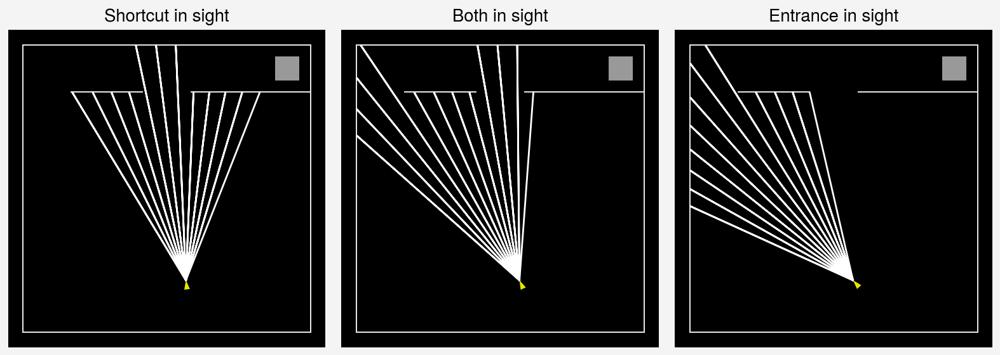

In [54]:
set_trajectory_plot_style()
env = gym.make('ShortcutNav-v0', wall_colors=1.5, shortcut_probability=1)
env.seed(20)

fig, ax = pplt.subplots(ncols=3)
obs = env.reset()
dists1 = obs[-12:]
env.render('human', ax=ax[0])

obs, _, _, _  = env.step(2)
dists2 = obs[-12:]
env.render('human', ax=ax[1])

obs, _, _, _  = env.step(2)
dists3 = obs[-12:]
env.render('human', ax=ax[2])

ax.format(title=['Shortcut in sight', 'Both in sight', 'Entrance in sight'])

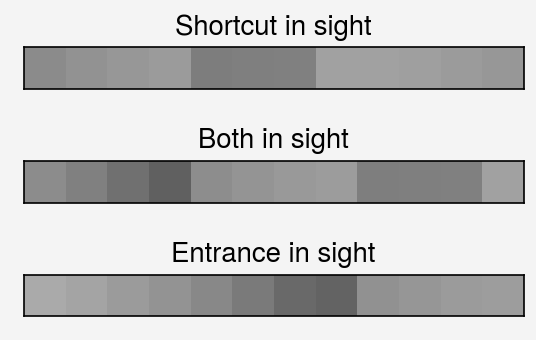

In [60]:
pplt.rc.reset()
fig, ax = pplt.subplots(nrows=3)
ax[0].imshow(np.flip(dists1)[np.newaxis, :], cmap='greys', vmin=0, vmax=1)
ax[1].imshow(np.flip(dists2)[np.newaxis, :], cmap='greys', vmin=0, vmax=1)
ax[2].imshow(np.flip(dists3)[np.newaxis, :], cmap='greys', vmin=0, vmax=1)

ax.format(xticks=[], yticks=[], title=['Shortcut in sight', 'Both in sight', 'Entrance in sight'])

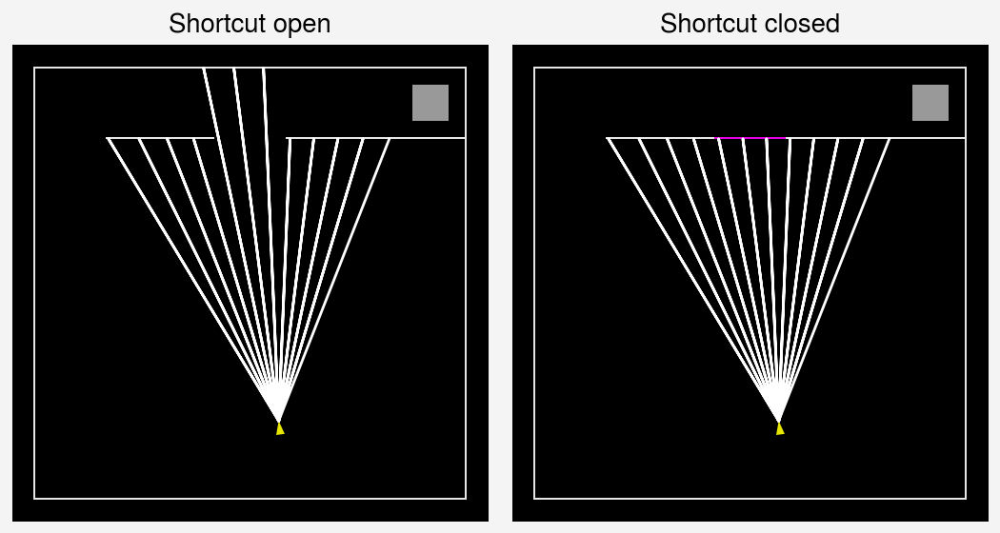

In [62]:
set_trajectory_plot_style()
fig, ax = pplt.subplots(ncols=2)
env = gym.make('ShortcutNav-v0', wall_colors=1.5, shortcut_probability=1)
env.seed(20)
obs = env.reset()
dists1 = obs[-12:]
env.render('human', ax=ax[0])

env = gym.make('ShortcutNav-v0', wall_colors=1.5, shortcut_probability=0)
env.seed(20)
obs = env.reset()
dists2 = obs[-12:]
env.render('human', ax=ax[1])

ax.format(title=['Shortcut open', 'Shortcut closed'])

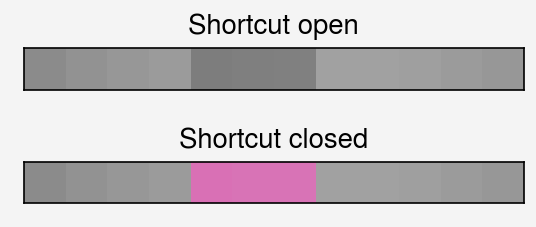

In [68]:
dists2_copy = dists2.copy()
dists2_copy[:5] = np.nan
dists2_copy[8:] = np.nan

pplt.rc.reset()
fig, ax = pplt.subplots(nrows=2)
ax[0].imshow(np.flip(dists1)[np.newaxis, :], cmap='greys', vmin=0, vmax=1)
ax[1].imshow(np.flip(dists2)[np.newaxis, :], cmap='greys', vmin=0, vmax=1)
ax[1].imshow(np.flip(dists2_copy)[np.newaxis, :], cmap='PuRd', vmin=0, vmax=1)

ax.format(xticks=[], yticks=[], title=['Shortcut open', 'Shortcut closed'])

# Point cloud wasserstein experiments

Testing whether using point cloud wasserstein is a good measure of separation between clusters/point clouds

In [ ]:
activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))


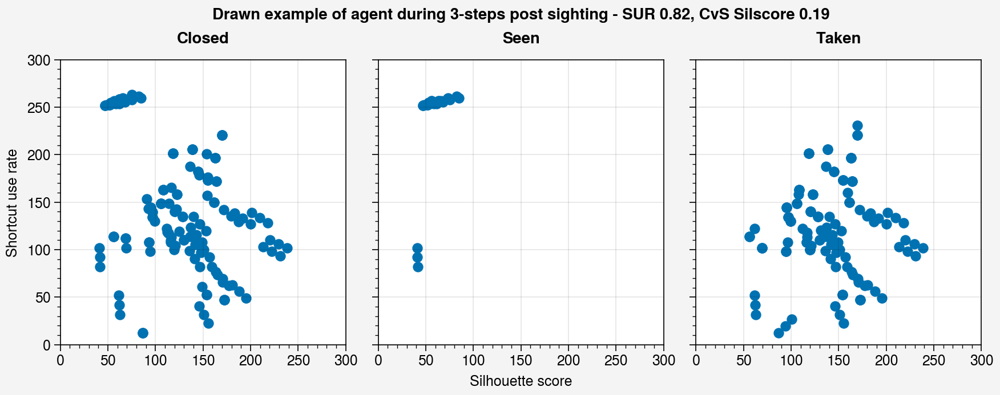

In [14]:
fig, ax = pplt.subplots(ncols=3)

p = 0.4
t = 1
key = f'{p}_{t}'
chk = 7
shortcut_res = activs[key]
res = shortcut_res[chk]
vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
activ = np.vstack(activ)
activ2d = res['activ2d']
pos = np.vstack(res['pos'])
color = vision_decision_coloring(vis, avail, used, end=3)

sur = np.sum(used) / 50
# silscore = two_set_silhouette_score(activ2d[color==0], activ2d[color==2])
silscore = two_set_silhouette_score(activ[color==0], activ[color==2])


closed = pos[color == 0]
seen = pos[color == 1]
taken = pos[color == 2]

ax[0].scatter(closed[:, 0], closed[:, 1])
ax[1].scatter(seen[:, 0], seen[:, 1])
ax[2].scatter(taken[:, 0], taken[:, 1])

leftlabels = ['Closed', 'Seen', 'Taken']
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=leftlabels,
         suptitle=f'Drawn example of agent during 3-steps post sighting - SUR {sur:.2f}, CvS Silscore {silscore:.2f}',
         xlim=[0, 300], ylim=[0, 300])


# Load angles for further analysis - later this will be replaced once we compute
#  and save a more detailed dict
xmin, ymin = activ2d.min(axis=0)
xmax, ymax = activ2d.max(axis=0)

Closed vs Seen 0.11
Closed vs Taken 0.20
Seen vs Taken 0.44
2D
Closed vs Seen 0.21
Closed vs Taken 0.46
Seen vs Taken 0.81


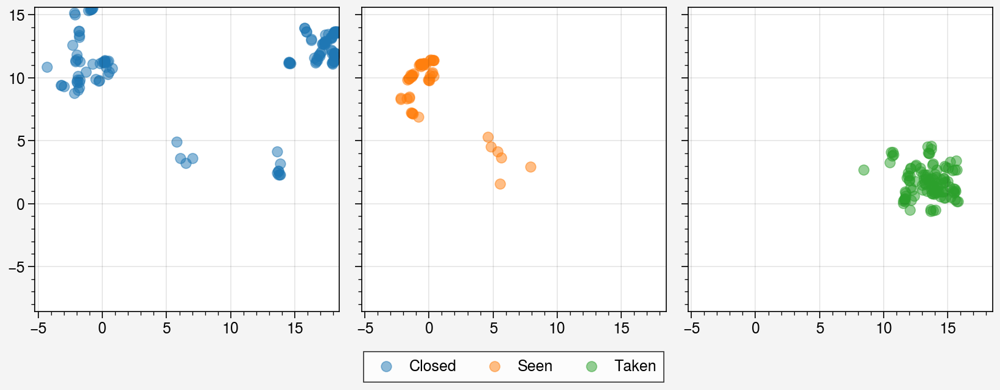

In [235]:
labels = ['Closed', 'Seen', 'Taken']
fig, ax = pplt.subplots(ncols=3, sharex=True, sharey=True)
for i in range(3):
    ax[i].scatter(activ2d[color==i, 0], activ2d[color==i, 1], alpha=0.5,
              label=labels[i], color=rgb_colors[i])
fig.legend(loc='b')

print(f'Closed vs Seen {two_set_silhouette_score(activ[color==0], activ[color==1]):.2f}')
print(f'Closed vs Taken {two_set_silhouette_score(activ[color==0], activ[color==2]):.2f}')
print(f'Seen vs Taken {two_set_silhouette_score(activ[color==1], activ[color==2]):.2f}')

print('2D')

print(f'Closed vs Seen {two_set_silhouette_score(activ2d[color==0], activ2d[color==1]):.2f}')
print(f'Closed vs Taken {two_set_silhouette_score(activ2d[color==0], activ2d[color==2]):.2f}')
print(f'Seen vs Taken {two_set_silhouette_score(activ2d[color==1], activ2d[color==2]):.2f}')

ax.format(xlim=[xmin, xmax], ylim=[ymin, ymax])

In [271]:
from scipy.stats import wasserstein_distance

In [15]:
X1 = activ2d[color==0]
X2 = activ2d[color==1]
X3 = activ2d[color==2]

In [284]:
X1 = activ[color==0]
X2 = activ[color==1]
X3 = activ[color==2]

In [312]:
from scipy.spatial import distance
from scipy.optimize import linear_sum_assignment

# Generate example data for two 2D distributions
np.random.seed(0)
data1 = np.random.multivariate_normal([0, 0], [[1, 0.5], [0.5, 1]], 100)
data2 = np.random.multivariate_normal([2, 2], [[1, -0.5], [-0.5, 1]], 100)

# Calculate the Wasserstein distance between the two distributions
distance_matrix = distance.cdist(X1, X2, 'euclidean')
row_ind, col_ind = linear_sum_assignment(distance_matrix)
wasserstein_dist = distance_matrix[row_ind, col_ind].sum()
print(wasserstein_dist, distance_matrix.mean(), wasserstein_dist/len(row_ind))

distance_matrix = distance.cdist(X1, X3, 'euclidean')
row_ind, col_ind = linear_sum_assignment(distance_matrix)
wasserstein_dist = distance_matrix[row_ind, col_ind].sum()
print(wasserstein_dist, distance_matrix.mean(), wasserstein_dist/len(row_ind))

distance_matrix = distance.cdist(X2, X3, 'euclidean')
row_ind, col_ind = linear_sum_assignment(distance_matrix)
wasserstein_dist = distance_matrix[row_ind, col_ind].sum()
print(wasserstein_dist, distance_matrix.mean(), wasserstein_dist/len(row_ind))

94.76219105658392 12.202879845203716 1.7548553899367392
1244.881071097636 13.261959690421596 11.215144784663389
774.6622599816585 15.674757546042326 14.34559740706775


In [321]:
distance_matrix = distance.cdist(X2, X3, 'euclidean')
row_ind, col_ind = linear_sum_assignment(distance_matrix)
wasserstein_dist = distance_matrix[row_ind, col_ind].sum()
print(wasserstein_dist, distance_matrix.mean(), wasserstein_dist/len(row_ind))

#row_ind gives indices for first data set, col_ind is for second data set

774.6622599816585 15.674757546042326 14.34559740706775


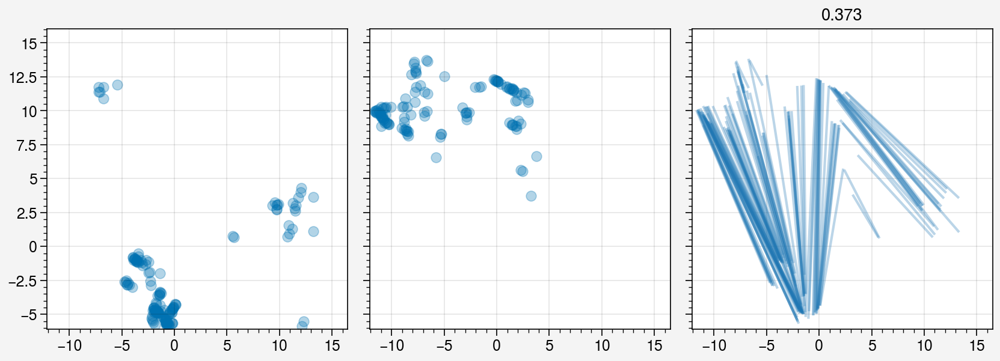

In [37]:
plot_two_cloud_wasserstein(X1, X3, all_data=activ2d)

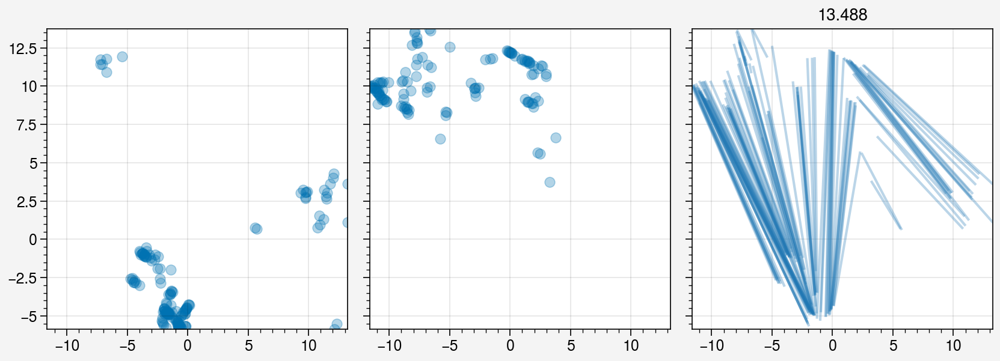

In [44]:
plot_two_cloud_wasserstein(X1, X3, normalize=False)

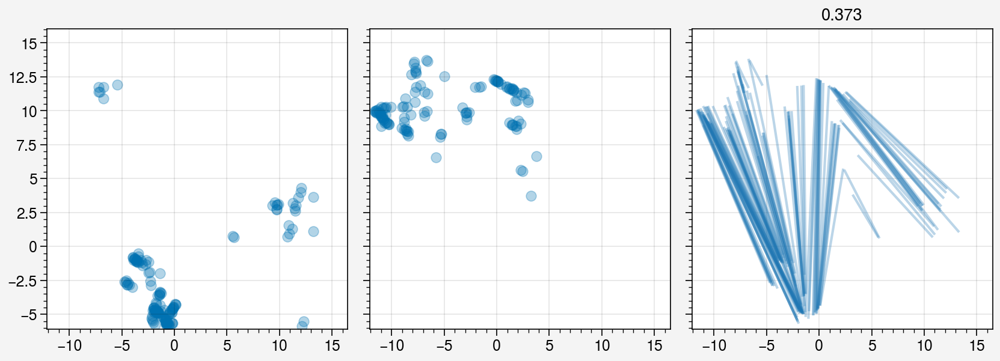

In [37]:
plot_two_cloud_wasserstein(X1, X3, all_data=activ2d)

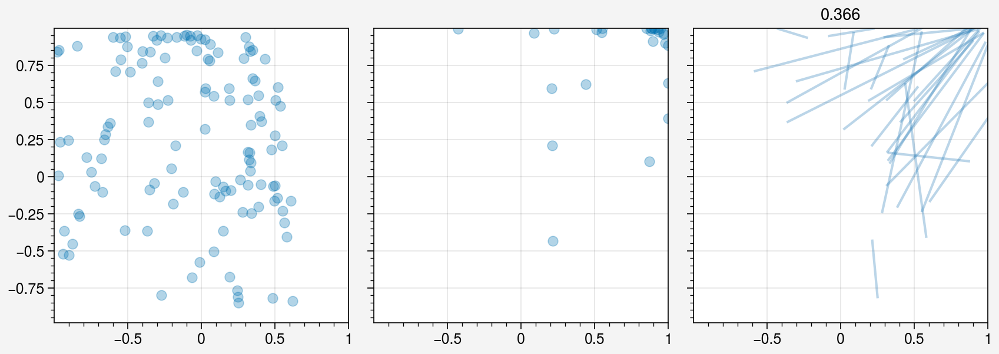

In [43]:
plot_two_cloud_wasserstein(activ[color==2], activ[color==1], all_data=activ)

### Full 64 dim vs 2d umap wasserstein consistency

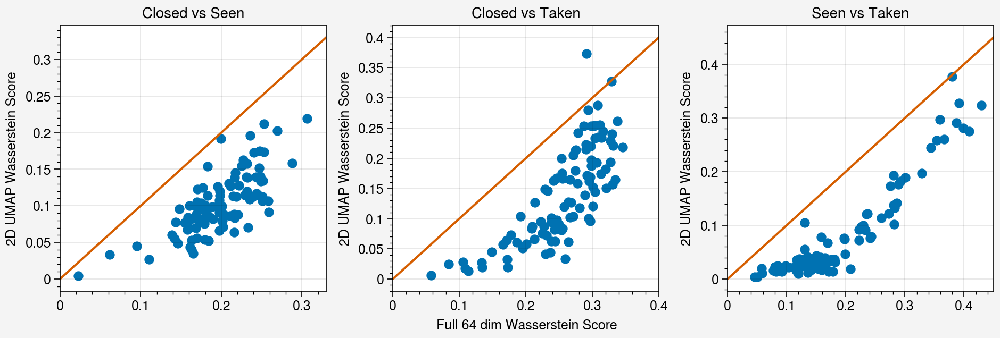

In [46]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
trials = range(10)

nvv1 = []
nvt1 = []
vvt1 = []

nvv2 = []
nvt2 = []
vvt2 = []
for p in probs:
    for chk in range(len(chks)):
        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)
            activ2d = res['activ2d']

            color = vision_decision_coloring(vis, avail, used, end=3)
            none_vs_vis, _, _ = two_cloud_wasserstein(activ[color==0], activ[color==1], all_data=activ)
            none_vs_taken, _, _ = two_cloud_wasserstein(activ[color==0], activ[color==2], all_data=activ)
            vis_vs_taken, _, _ = two_cloud_wasserstein(activ[color==1], activ[color==2], all_data=activ)
            nvv1.append(none_vs_vis)
            nvt1.append(none_vs_taken)
            vvt1.append(vis_vs_taken)
            
            none_vs_vis, _, _ = two_cloud_wasserstein(activ2d[color==0], activ2d[color==1], all_data=activ2d)
            none_vs_taken, _, _ = two_cloud_wasserstein(activ2d[color==0], activ2d[color==2], all_data=activ2d)
            vis_vs_taken, _, _ = two_cloud_wasserstein(activ2d[color==1], activ2d[color==2], all_data=activ2d)
            nvv2.append(none_vs_vis)
            nvt2.append(none_vs_taken)
            vvt2.append(vis_vs_taken)
            
fig, ax = pplt.subplots(ncols=3, sharey=False)
ax[0].scatter(nvv1, nvv2)
ax[1].scatter(nvt1, nvt2)
ax[2].scatter(vvt1, vvt2)

ax[0].plot([0, 0.33], [0, 0.33])
ax[1].plot([0, 0.4], [0, 0.4])
ax[2].plot([0, 0.45], [0, 0.45])

ax.format(title=['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken'],
          ylabel='2D UMAP Wasserstein Score', xlabel='Full 64 dim Wasserstein Score')

## 3 step sanity check

We had an issue with the 3 step vision_decision_coloring function not selecting points correctly, so this was the sanity check that helped uncover that

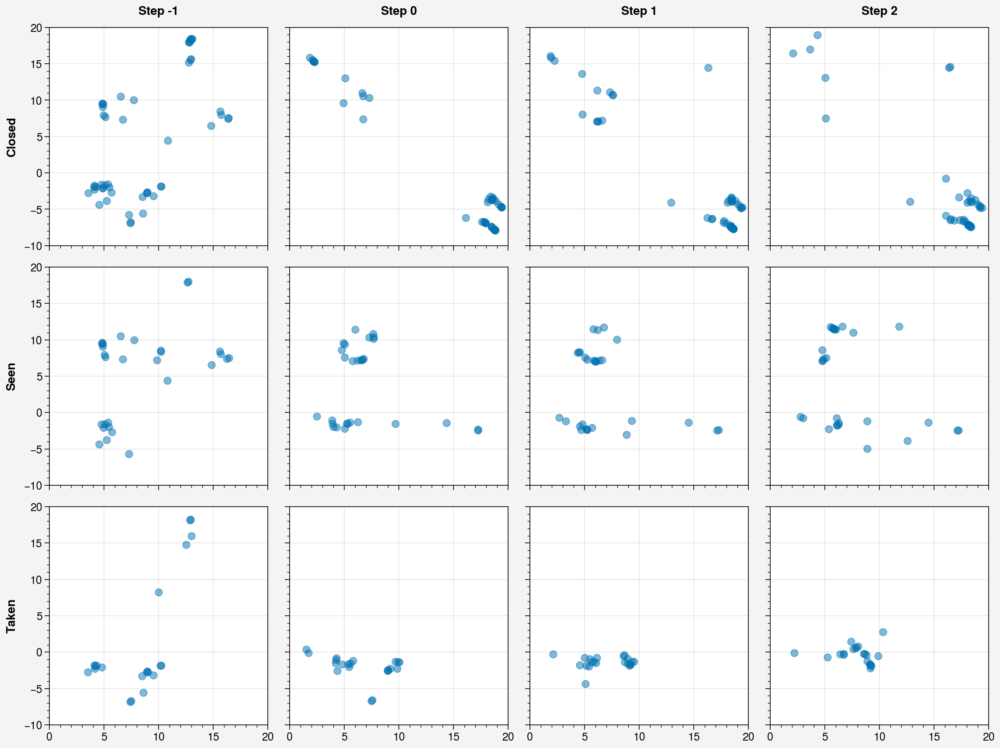

In [170]:
labels = ['Closed', 'Seen', 'Taken']
fig, ax = pplt.subplots(ncols=4, nrows=3, sharex=True, sharey=True)

for i in range(3):
    for j in range(4):
        color_use = vision_decision_coloring(vis, avail, used, end=j, start=-1)
        color_ignore = vision_decision_coloring(vis, avail, used, end=j-1, start=-1)

        idxs = (color_use == i) & (color_ignore != i)

        ax[i, j].scatter(activ2d[idxs, 0], activ2d[idxs, 1], alpha=0.5)

ax.format(xlim=[0, 20], ylim=[-10, 20],
         toplabels=[f'Step {i}' for i in range(-1, 3)],
         leftlabels=labels)

In [60]:
res1 = shortcut_res['ns'][chk]
res2 = shortcut_res['ws'][chk]

In [158]:
ep = 4
used = check_shortcut_usage(res2['ep_pos'][ep])

activ1 = res1['activs'][ep]['shared_activations'][1]
activ2 = res2['activs'][ep]['shared_activations'][1]

activ1_2d = umap.transform(activ1)
activ2_2d = umap.transform(activ2)

vis1 = [res1['vis'][ep]]
avail1 = [res1['shortcut'][ep]]
used1 = [[check_shortcut_usage(res1['ep_pos'][ep])]]

vis2 = [res2['vis'][ep]]
avail2 = [res2['shortcut'][ep]]
used2 = [[check_shortcut_usage(res2['ep_pos'][ep])]]

False


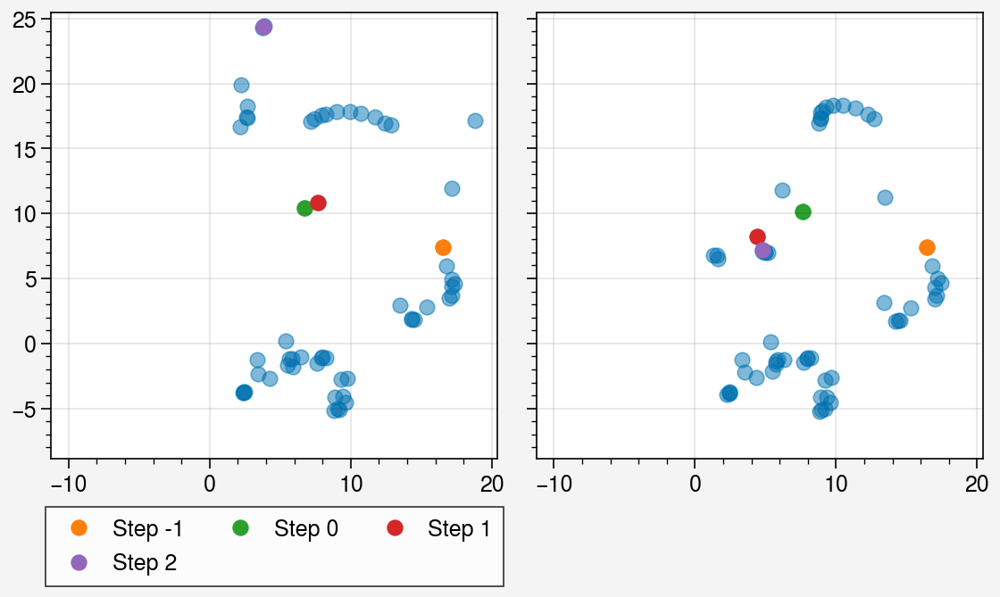

In [164]:
print(used2[0][0])

fig, ax = pplt.subplots(ncols=2)
ax[0].scatter(activ1_2d[:, 0], activ1_2d[:, 1], alpha=0.5)
ax[1].scatter(activ2_2d[:, 0], activ2_2d[:, 1], alpha=0.5)

for i in range(4):
    color1 = vision_decision_coloring(vis1, avail1, used1, end=i, start=i-1)
    idxs1 = color1 != -1
    color2 = vision_decision_coloring(vis2, avail2, used2, end=i, start=i-1)
    idxs2 = color2 != -1
    
    ax[0].scatter(activ1_2d[idxs1, 0], activ1_2d[idxs1, 1], color=rgb_colors[i+1], label=f'Step {i-1}')
    ax[1].scatter(activ2_2d[idxs2, 0], activ2_2d[idxs2, 1], color=rgb_colors[i+1])
    
ax[0].legend(loc='b')
ax.format(xlim=[xmin-1, xmax+1], ylim=[ymin-1, ymax+1])


# What do agents care about - decision vs vision 10 agents

## Policy

### wc1.5

In [316]:
activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

print('Shortcut usage out of 50 episodes with open shortcuts')
print('0.1:', [np.sum(activs[f'0.1_{t}'][-1]['shortcut_used']) for t in range(10)])
print('0.4:', [np.sum(activs[f'0.4_{t}'][-1]['shortcut_used']) for t in range(10)])

Shortcut usage out of 50 episodes with open shortcuts
0.1: [7, 2, 1, 6, 5, 0, 9, 1, 0, 0]
0.4: [33, 43, 4, 42, 39, 41, 36, 1, 43, 20]


In [318]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
trials = range(10)
ns = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 16, 18, 20]

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []}
}
for p, t in itertools.product(probs, trials):
    key = f'{p}_{t}'
    shortcut_res = activs[key]
    res = shortcut_res[-1]
    
    vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
    activ = np.vstack(activ)
    if np.sum(used) < 5:
        continue
    
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    for n in ns:
        color = vision_decision_coloring(vis, avail, used, end=n)
        none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
        none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
        vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))
    
    all_scores[p]['none_vs_vis'].append(none_vs_vis)
    all_scores[p]['none_vs_taken'].append(none_vs_taken)
    all_scores[p]['vis_vs_taken'].append(vis_vs_taken)
    
    

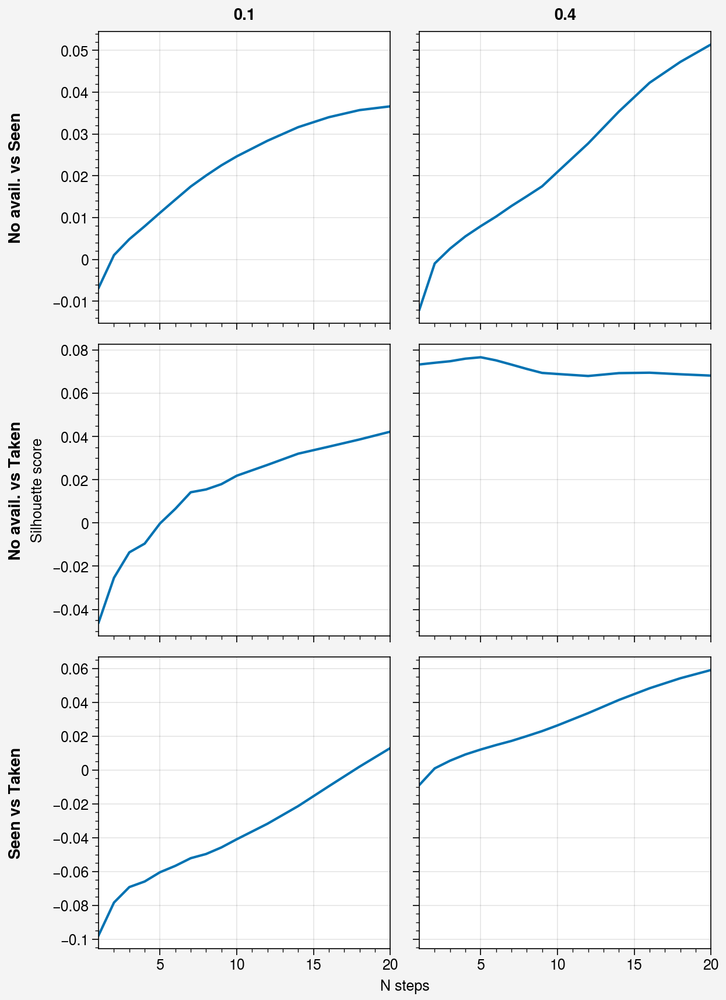

In [21]:
fig, ax = pplt.subplots(nrows=3, ncols=2)

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']
for j, p in enumerate(probs):
    for i, key in enumerate(keys):
        # ax[i, j].boxplot(all_scores[p][key], showfliers=False)
        ax[i, j].plot(ns, np.mean(all_scores[p][key], axis=0))
        
ax.format(xlabel='N steps', ylabel='Silhouette score',
         toplabels=[f'{p}' for p in probs],
         leftlabels=leftlabels,)
         # xlocator=range(15), xformatter=[str(n) for n in ns])

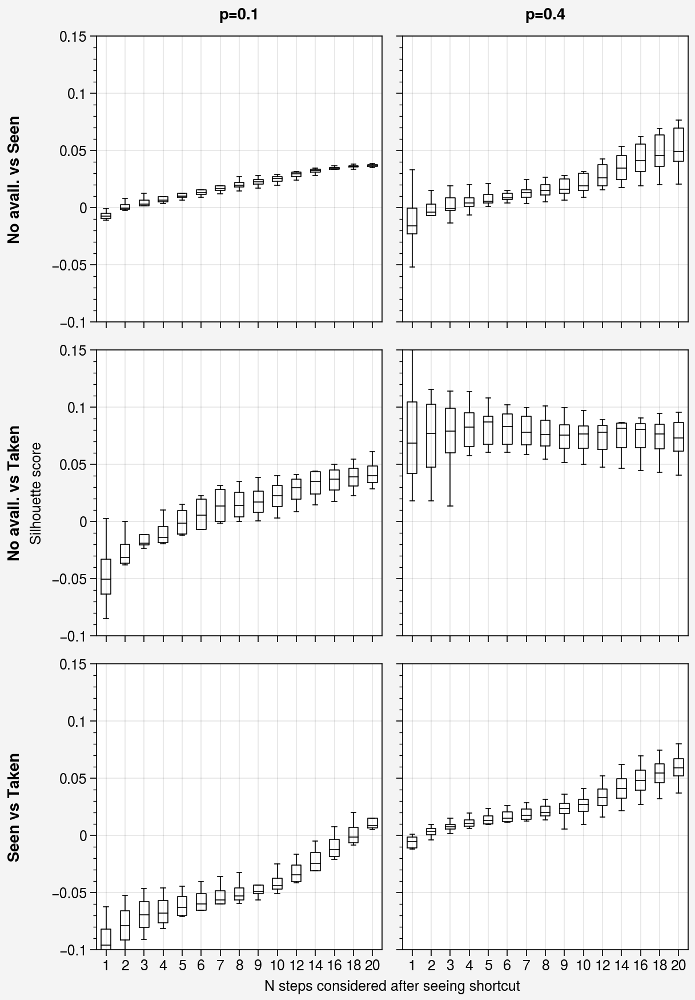

In [320]:
fig, ax = pplt.subplots(nrows=3, ncols=2)

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']
for j, p in enumerate(probs):
    for i, key in enumerate(keys):
        ax[i, j].boxplot(all_scores[p][key], showfliers=False)
        # ax[i, j].plot(ns, np.mean(all_scores[p][key], axis=0))
        
ax.format(xlabel='N steps considered after seeing shortcut', ylabel='Silhouette score',
         toplabels=[f'p={p}' for p in probs],
         leftlabels=leftlabels,
         xlocator=range(15), xformatter=[str(n) for n in ns],
         ylim=[-0.1, 0.15])

#### wc1.5 3 step windows

In [29]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
trials = range(10)
n_window = 3
starts = [0, 3, 6, 9, 12, 15]
all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []}
}
for p, t in itertools.product(probs, trials):
    key = f'{p}_{t}'
    shortcut_res = activs[key]
    res = shortcut_res[-1]
    
    vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
    activ = np.vstack(activ)
    if np.sum(used) < 5:
        continue
    
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    for start in starts:
        color = vision_decision_coloring(vis, avail, used, start=start, end=start+n_window)
        none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
        none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
        vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))
    
    all_scores[p]['none_vs_vis'].append(none_vs_vis)
    all_scores[p]['none_vs_taken'].append(none_vs_taken)
    all_scores[p]['vis_vs_taken'].append(vis_vs_taken)
    
    

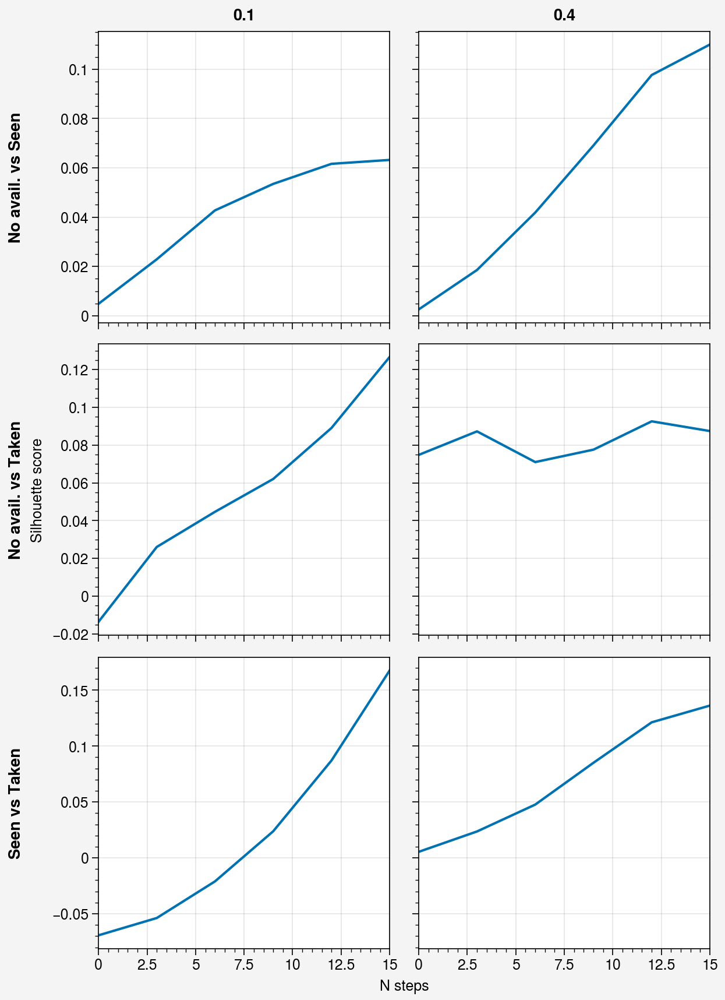

In [30]:
fig, ax = pplt.subplots(nrows=3, ncols=2)

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']
for j, p in enumerate(probs):
    for i, key in enumerate(keys):
        # ax[i, j].boxplot(all_scores[p][key], showfliers=False)
        ax[i, j].plot(starts, np.mean(all_scores[p][key], axis=0))
        
ax.format(xlabel='N steps', ylabel='Silhouette score',
         toplabels=[f'{p}' for p in probs],
         leftlabels=leftlabels,)
         # xlocator=range(15), xformatter=[str(n) for n in ns])

### wc4

In [306]:
activs = pickle.load(open('data/shortcut/wc4_policy_moreagents/shared1_activ', 'rb'))

print('Shortcut usage out of 50 episodes with open shortcuts')
print('0.1:', [np.sum(activs[f'0.1_{t}'][-1]['shortcut_used']) for t in range(10)])
print('0.4:', [np.sum(activs[f'0.4_{t}'][-1]['shortcut_used']) for t in range(10)])

Shortcut usage out of 50 episodes with open shortcuts
0.1: [0, 32, 0, 0, 32, 31, 0, 36, 0, 34]
0.4: [45, 43, 45, 43, 45, 44, 46, 45, 45, 0]


In [309]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
trials = range(10)
ns = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 16, 18, 20]

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []}
}
for p, t in itertools.product(probs, trials):
    key = f'{p}_{t}'
    shortcut_res = activs[key]
    res = shortcut_res[-1]
    
    vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
    activ = np.vstack(activ)
    if np.sum(used) < 5:
        continue
    
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    for n in ns:
        color = vision_decision_coloring(vis, avail, used, end=n)
        none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
        none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
        vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))
    
    all_scores[p]['none_vs_vis'].append(none_vs_vis)
    all_scores[p]['none_vs_taken'].append(none_vs_taken)
    all_scores[p]['vis_vs_taken'].append(vis_vs_taken)
    
    

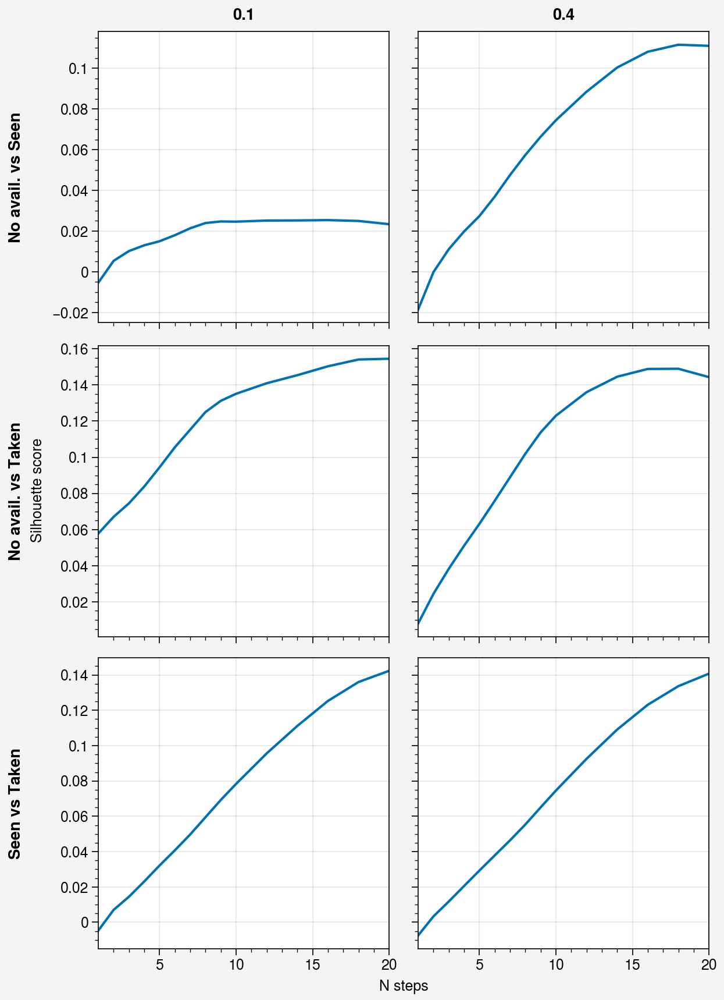

In [25]:
fig, ax = pplt.subplots(nrows=3, ncols=2)

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']
for j, p in enumerate(probs):
    for i, key in enumerate(keys):
        # ax[i, j].boxplot(all_scores[p][key], showfliers=False)
        ax[i, j].plot(ns, np.mean(all_scores[p][key], axis=0))
        
ax.format(xlabel='N steps', ylabel='Silhouette score',
         toplabels=[f'{p}' for p in probs],
         leftlabels=leftlabels,)
         # xlocator=range(15), xformatter=[str(n) for n in ns])

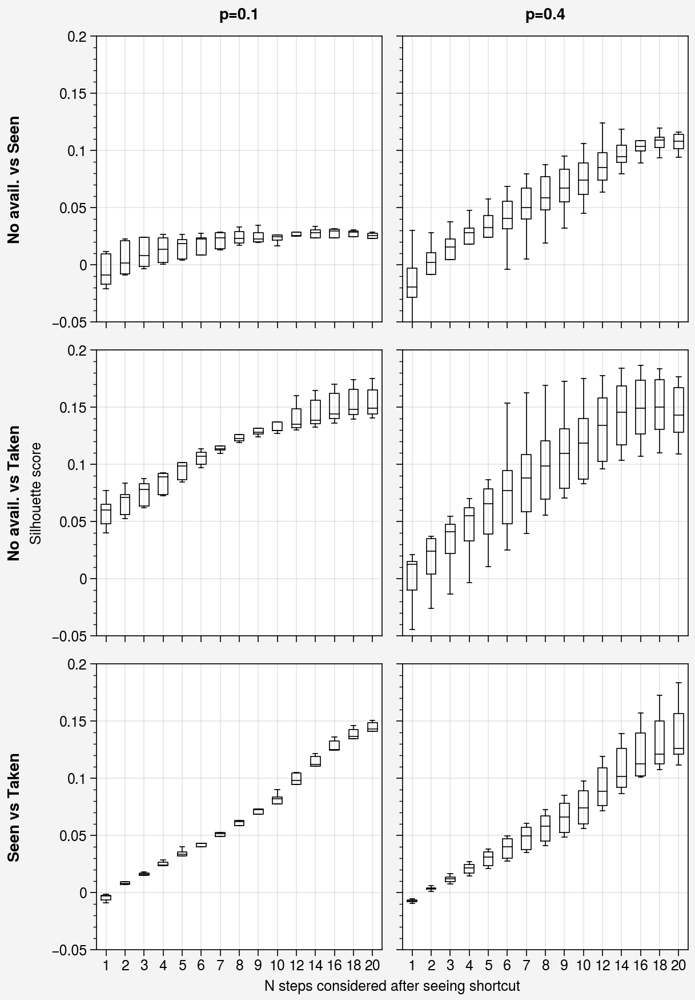

In [312]:
fig, ax = pplt.subplots(nrows=3, ncols=2)

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']
for j, p in enumerate(probs):
    for i, key in enumerate(keys):
        ax[i, j].boxplot(all_scores[p][key], showfliers=False)
        # ax[i, j].plot(ns, np.mean(all_scores[p][key], axis=0))
        
ax.format(xlabel='N steps considered after seeing shortcut', ylabel='Silhouette score',
         toplabels=[f'p={p}' for p in probs],
         leftlabels=leftlabels,
         xlocator=range(15), xformatter=[str(n) for n in ns],
         ylim=[-0.05, 0.2])

In [32]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
trials = range(10)
n_window = 3
starts = [0, 3, 6, 9, 12, 15]
all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []}
}
for p, t in itertools.product(probs, trials):
    key = f'{p}_{t}'
    shortcut_res = activs[key]
    res = shortcut_res[-1]
    
    vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
    activ = np.vstack(activ)
    if np.sum(used) < 5:
        continue
    
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    for start in starts:
        color = vision_decision_coloring(vis, avail, used, start=start, end=start+n_window)
        none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
        none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
        vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))
    
    all_scores[p]['none_vs_vis'].append(none_vs_vis)
    all_scores[p]['none_vs_taken'].append(none_vs_taken)
    all_scores[p]['vis_vs_taken'].append(vis_vs_taken)
    
    

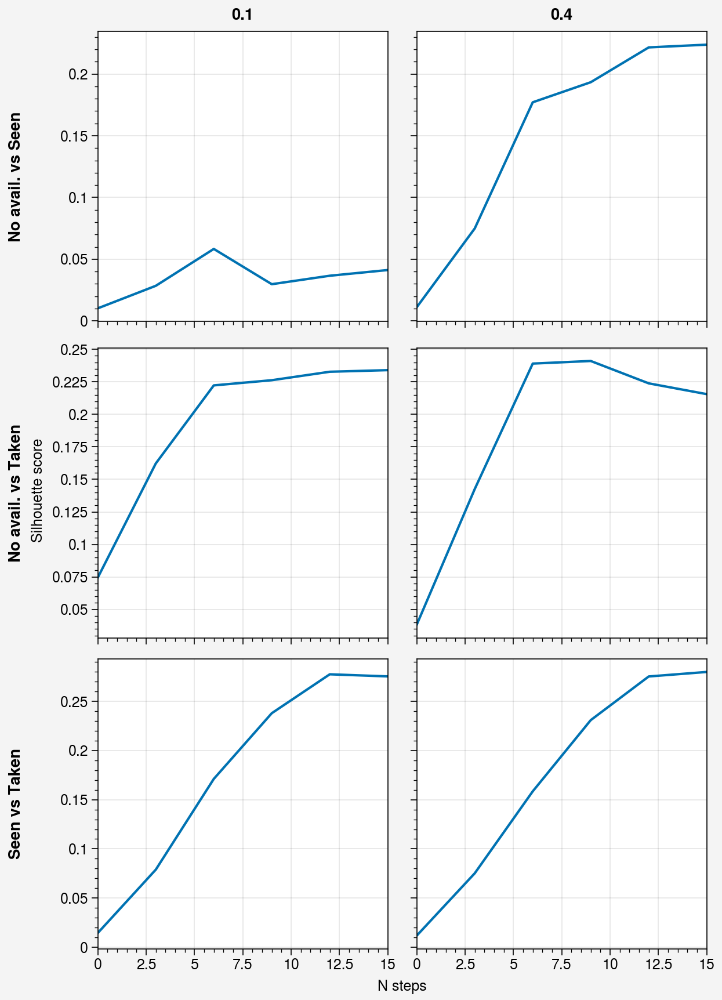

In [33]:
fig, ax = pplt.subplots(nrows=3, ncols=2)

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']
for j, p in enumerate(probs):
    for i, key in enumerate(keys):
        # ax[i, j].boxplot(all_scores[p][key], showfliers=False)
        ax[i, j].plot(starts, np.mean(all_scores[p][key], axis=0))
        
ax.format(xlabel='N steps', ylabel='Silhouette score',
         toplabels=[f'{p}' for p in probs],
         leftlabels=leftlabels,)
         # xlocator=range(15), xformatter=[str(n) for n in ns])

## First 3 steps after seeing shortcut

### wc1.5

In [3]:
activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

print('Shortcut usage out of 50 episodes with open shortcuts')
print('0.1:', [np.sum(activs[f'0.1_{t}'][-1]['shortcut_used']) for t in range(10)])
print('0.4:', [np.sum(activs[f'0.4_{t}'][-1]['shortcut_used']) for t in range(10)])

Shortcut usage out of 50 episodes with open shortcuts
0.1: [7, 2, 1, 6, 5, 0, 9, 1, 0, 0]
0.4: [33, 43, 4, 42, 39, 41, 36, 1, 43, 20]


In [71]:
ep = 7
print('Shortcut usage out of 50 episodes with open shortcuts')
print('0.1:', [np.sum(activs[f'0.1_{t}'][ep]['shortcut_used']) for t in range(10)])
print('0.4:', [np.sum(activs[f'0.4_{t}'][ep]['shortcut_used']) for t in range(10)])

Shortcut usage out of 50 episodes with open shortcuts
0.1: [5, 0, 0, 4, 3, 0, 24, 3, 0, 0]
0.4: [16, 41, 6, 22, 20, 9, 30, 16, 29, 15]


In [78]:
shortcut_res = activs['0.4_6']
res = shortcut_res[7]

vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
activ = np.vstack(activ)

color = vision_decision_coloring(vis, avail, used, end=3)
print(two_set_silhouette_score(activ[color==0], activ[color==1]))
print(two_set_silhouette_score(activ[color==1], activ[color==2]))
print(two_set_silhouette_score(activ[color==0], activ[color==2]))


-0.000770908281225411
0.04744894830221247
0.006447948976353353


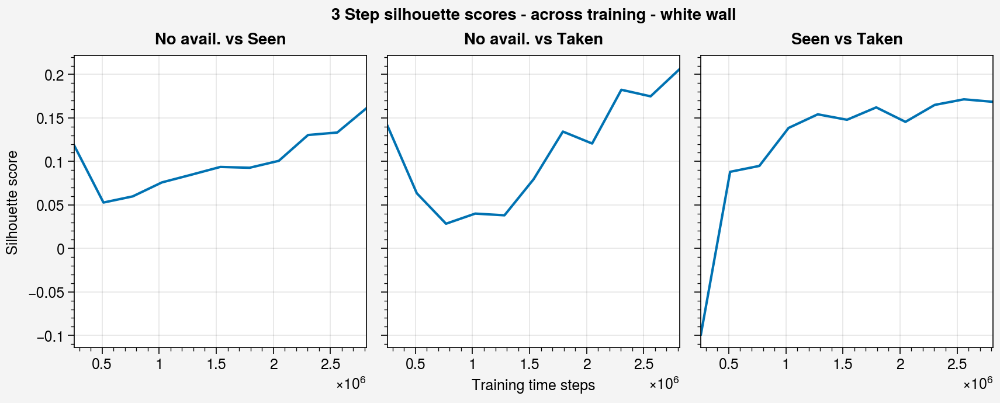

In [187]:
# only consider agents that used shortcut at least 5 times

# probs = [0.1, 0.4]
probs = [0.4]
trials = range(10)

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []}
}

p = 0.4
for chk in range(len(chks)):
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used

    for t in trials:
        key = f'{p}_{t}'
        shortcut_res = activs[key]

        res = shortcut_res[chk]
        vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
        if np.sum(used) < 5:
            continue
        activ = np.vstack(activ)

        color = vision_decision_coloring(vis, avail, used, end=3)
        none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
        none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
        vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))

    all_scores[p]['none_vs_vis'].append(np.mean(none_vs_vis))
    all_scores[p]['none_vs_taken'].append(np.mean(none_vs_taken))
    all_scores[p]['vis_vs_taken'].append(np.mean(vis_vs_taken))

    

# fig, ax = pplt.subplots(nrows=3, ncols=2)
fig, ax = pplt.subplots(ncols=3)

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']
# for j, p in enumerate(probs):
for i, key in enumerate(keys):
    # ax[i, j].boxplot(all_scores[p][key], showfliers=False)
    # ax[i, j].plot(starts, np.mean(all_scores[p][key], axis=0))
    ax[i].plot(chks*64*100, all_scores[0.4][key])
        
ax.format(xlabel='Training time steps', ylabel='Silhouette score',
         toplabels=leftlabels,
         suptitle='3 Step silhouette scores - across training - white wall')
         # leftlabels=leftlabels,)
         # xlocator=range(15), xformatter=[str(n) for n in ns])

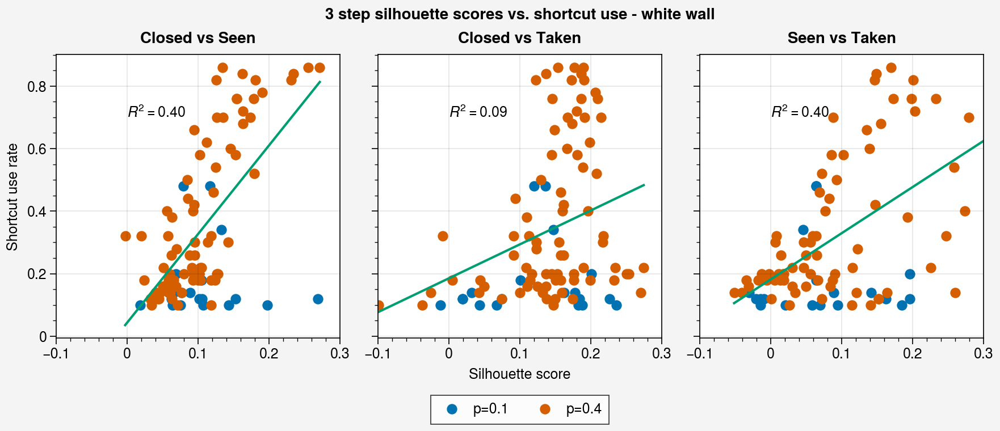

In [202]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

fig, ax = pplt.subplots(ncols=3)
legend_pts = []

comb_none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
comb_none_vs_taken = [] #no shortcut avail vs shortcut used
comb_vis_vs_taken = [] #shortcut avail but not used vs shortcut used
comb_surs = []

for p in probs:
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    surs = []
    for chk in range(len(chks)):
        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
            none_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))
            vis_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
            surs.append(np.sum(used) / 50)
    
    

    keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
    for i, key in enumerate(keys):
        pts = ax[i].scatter(globals()[key], surs, label=f'p={p}')
        if i == 0:
            legend_pts.append(pts)
        
    comb_none_vs_vis += none_vs_vis
    comb_none_vs_taken += none_vs_taken
    comb_vis_vs_taken += vis_vs_taken
    comb_surs += surs

keys = ['comb_none_vs_vis', 'comb_none_vs_taken', 'comb_vis_vs_taken']
for i, key in enumerate(keys):
    x, y, r2 = linear_bestfit(globals()[key], comb_surs)
    ax[i].plot(x, y)
    ax[i].text(0, 0.7, f'$R^2={r2:.2f}$')

leftlabels = ['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken']        
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=leftlabels,
         suptitle='3 step silhouette scores vs. shortcut use - white wall',
         xlim=[-0.1, 0.3])
fig.legend(legend_pts, loc='b')

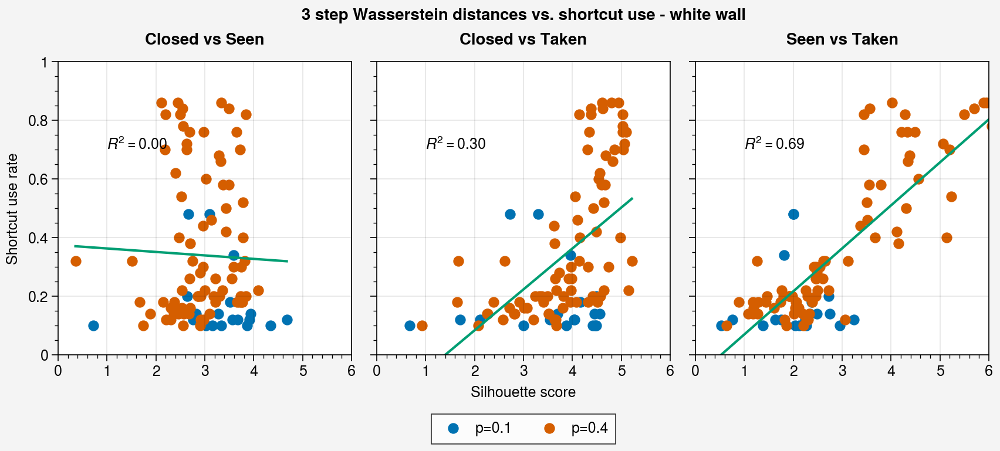

In [339]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

fig, ax = pplt.subplots(ncols=3)
legend_pts = []

comb_none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
comb_none_vs_taken = [] #no shortcut avail vs shortcut used
comb_vis_vs_taken = [] #shortcut avail but not used vs shortcut used
comb_surs = []

for p in probs:
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    surs = []
    for chk in range(len(chks)):
        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            score, _, _ = two_cloud_wasserstein(activ[color==0], activ[color==1])
            none_vs_vis.append(score)
            score, _, _ = two_cloud_wasserstein(activ[color==0], activ[color==2])
            none_vs_taken.append(score)
            score, _, _ = two_cloud_wasserstein(activ[color==1], activ[color==2])
            vis_vs_taken.append(score)
            surs.append(np.sum(used) / 50)
    
    

    keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
    for i, key in enumerate(keys):
        pts = ax[i].scatter(globals()[key], surs, label=f'p={p}')
        if i == 0:
            legend_pts.append(pts)
        
    comb_none_vs_vis += none_vs_vis
    comb_none_vs_taken += none_vs_taken
    comb_vis_vs_taken += vis_vs_taken
    comb_surs += surs

keys = ['comb_none_vs_vis', 'comb_none_vs_taken', 'comb_vis_vs_taken']
for i, key in enumerate(keys):
    x, y, r2 = linear_bestfit(globals()[key], comb_surs)
    ax[i].plot(x, y)
    ax[i].text(1, 0.7, f'$R^2={r2:.2f}$')

leftlabels = ['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken']        
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=leftlabels,
         suptitle='3 step Wasserstein distances vs. shortcut use - white wall',
         xlim=[0, 6], ylim=[0, 1])
fig.legend(legend_pts, loc='b')

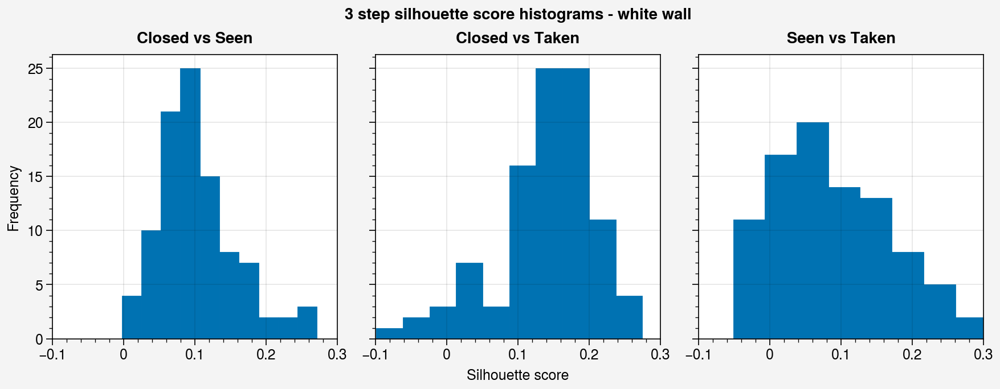

In [201]:
fig, ax = pplt.subplots(ncols=3)

# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

legend_pts = []
none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
none_vs_taken = [] #no shortcut avail vs shortcut used
vis_vs_taken = [] #shortcut avail but not used vs shortcut used

for p in probs:
    for chk in range(len(chks)):
        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
            none_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))
            vis_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))    
    

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
for i, key in enumerate(keys):
    pts = ax[i].hist(globals()[key], label=f'p={p}')

leftlabels = ['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken']        
ax.format(xlabel='Silhouette score', ylabel='Frequency',
         toplabels=leftlabels,
         suptitle='3 step silhouette score histograms - white wall',
         xlim=[-0.1, 0.3])


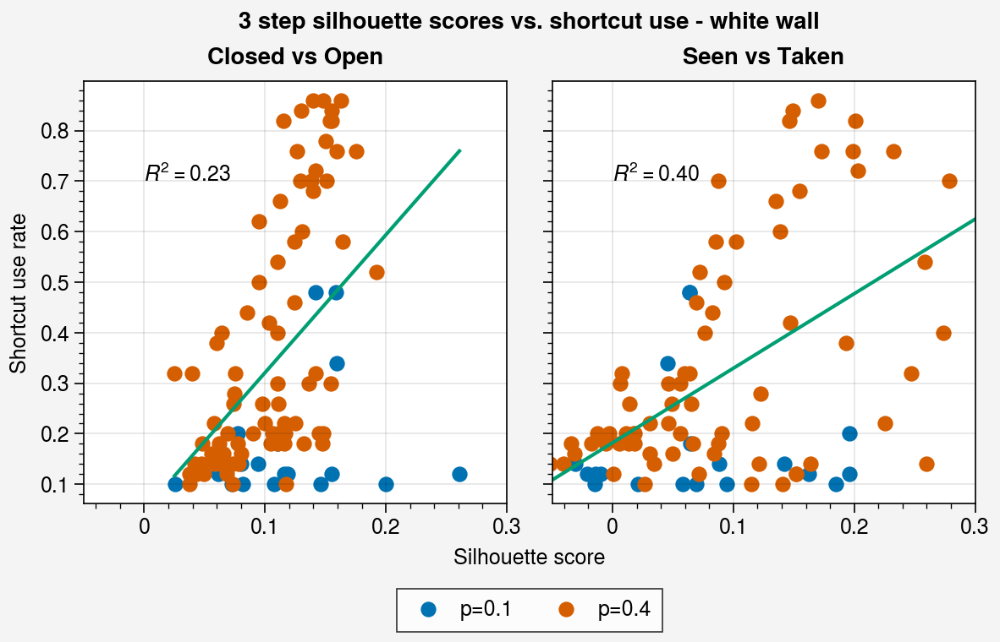

In [179]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

fig, ax = pplt.subplots(ncols=2)
legend_pts = []

comb_closed_vs_open = [] #no shortcut avail vs shortcut avail but not used
comb_vis_vs_taken = [] #shortcut avail but not used vs shortcut used
comb_surs = []

for p in probs:
    closed_vs_open = [] #no shortcut avail vs shortcut avail but not used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    surs = []
    for chk in range(len(chks)):
        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            closed_vs_open.append(two_set_silhouette_score(activ[color==0], 
                                                           activ[(color==1) | (color==2)]))
            vis_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
            surs.append(np.sum(used) / 50)
    
    

    keys = ['closed_vs_open', 'vis_vs_taken']
    for i, key in enumerate(keys):
        pts = ax[i].scatter(globals()[key], surs, label=f'p={p}')
        if i == 0:
            legend_pts.append(pts)
        
    comb_closed_vs_open += closed_vs_open
    comb_vis_vs_taken += vis_vs_taken
    comb_surs += surs

keys = ['comb_closed_vs_open', 'comb_vis_vs_taken']
for i, key in enumerate(keys):
    x, y, r2 = linear_bestfit(globals()[key], comb_surs)
    ax[i].plot(x, y)
    ax[i].text(0, 0.7, f'$R^2={r2:.2f}$')

leftlabels = ['Closed vs Open', 'Seen vs Taken']        
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=leftlabels,
         suptitle='3 step silhouette scores vs. shortcut use - white wall',
         xlim=[-0.05, 0.3])
fig.legend(legend_pts, loc='b')

### Singling out agents

In [5]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

rows = []
for p in probs:
    for chk in range(len(chks)):
        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            none_vs_vis = two_set_silhouette_score(activ[color==0], activ[color==1])
            none_vs_taken = two_set_silhouette_score(activ[color==0], activ[color==2])
            vis_vs_taken = two_set_silhouette_score(activ[color==1], activ[color==2])
            sur = (np.sum(used) / 50)
    
            rows.append({
                'key': key,
                'chk': chk,
                'none_vs_vis': none_vs_vis,
                'none_vs_taken': none_vs_taken,
                'vis_vs_taken': vis_vs_taken,
                'sur': sur
            })
df = pd.DataFrame(rows)

In [6]:
df[df['none_vs_vis'] > 0.2]

,key,chk,none_vs_vis,none_vs_taken,vis_vs_taken,sur
3,0.1_0,5,0.268388,0.183693,0.195828,0.12
63,0.4_1,7,0.231507,0.190430,0.332565,0.82
73,0.4_1,8,0.234762,0.186731,0.349683,0.84
81,0.4_1,9,0.255316,0.176848,0.337634,0.86
90,0.4_1,10,0.271524,0.189453,0.328801,0.86


In [214]:
df[df['sur'] > 0.7]

,key,chk,none_vs_vis,none_vs_taken,vis_vs_taken,sur
63,0.4_1,7,0.231507,0.190430,0.332565,0.82
73,0.4_1,8,0.234762,0.186731,0.349683,0.84
74,0.4_3,8,0.154766,0.145744,0.232722,0.76
81,0.4_1,9,0.255316,0.176848,0.337634,0.86
83,0.4_3,9,0.125203,0.122145,0.146076,0.82
85,0.4_5,9,0.154368,0.209270,0.198630,0.76
86,0.4_6,9,0.178673,0.186363,0.172597,0.76
90,0.4_1,10,0.271524,0.189453,0.328801,0.86
91,0.4_3,10,0.162205,0.136661,0.148890,0.84
92,0.4_4,10,0.190497,0.206502,0.387266,0.78


#### Is it the same agent through training that causes results?

Looks like not really - that is good, this is not too noise dependent

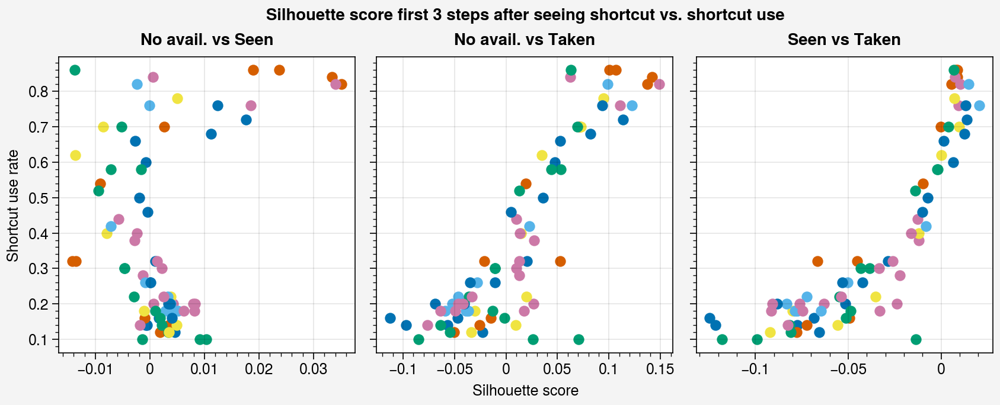

In [91]:
p = 0.4
trials = range(10)

fig, ax = pplt.subplots(ncols=3)
for t in trials:
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    surs = []

    for chk in range(len(chks)):
        key = f'{p}_{t}'
        shortcut_res = activs[key]

        res = shortcut_res[chk]
        vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
        if np.sum(used) < 5:
            continue
        activ = np.vstack(activ)

        color = vision_decision_coloring(vis, avail, used, end=3)
        none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
        none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
        vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))
        surs.append(np.sum(used) / 50)
    
    keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
    for i, key in enumerate(keys):
        ax[i].scatter(globals()[key], surs, label=f'p={p}')

leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']        
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=leftlabels,
         suptitle='Silhouette score first 3 steps after seeing shortcut vs. shortcut use')


### wc4

In [180]:
activs = pickle.load(open('data/shortcut/wc4_policy_moreagents/shared1_activ', 'rb'))

print('Shortcut usage out of 50 episodes with open shortcuts')
print('0.1:', [np.sum(activs[f'0.1_{t}'][-1]['shortcut_used']) for t in range(10)])
print('0.4:', [np.sum(activs[f'0.4_{t}'][-1]['shortcut_used']) for t in range(10)])

Shortcut usage out of 50 episodes with open shortcuts
0.1: [0, 32, 0, 0, 32, 31, 0, 36, 0, 34]
0.4: [45, 43, 45, 43, 45, 44, 46, 45, 45, 0]


In [111]:
ep = 5
print('Shortcut usage out of 50 episodes with open shortcuts')
print('0.1:', [np.sum(activs[f'0.1_{t}'][ep]['shortcut_used']) for t in range(10)])
print('0.4:', [np.sum(activs[f'0.4_{t}'][ep]['shortcut_used']) for t in range(10)])

Shortcut usage out of 50 episodes with open shortcuts
0.1: [0, 32, 0, 3, 31, 34, 2, 26, 0, 11]
0.4: [42, 44, 41, 44, 43, 44, 45, 42, 42, 0]


In [78]:
shortcut_res = activs['0.4_6']
res = shortcut_res[7]

vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
activ = np.vstack(activ)

color = vision_decision_coloring(vis, avail, used, end=3)
print(two_set_silhouette_score(activ[color==0], activ[color==1]))
print(two_set_silhouette_score(activ[color==1], activ[color==2]))
print(two_set_silhouette_score(activ[color==0], activ[color==2]))


-0.000770908281225411
0.04744894830221247
0.006447948976353353


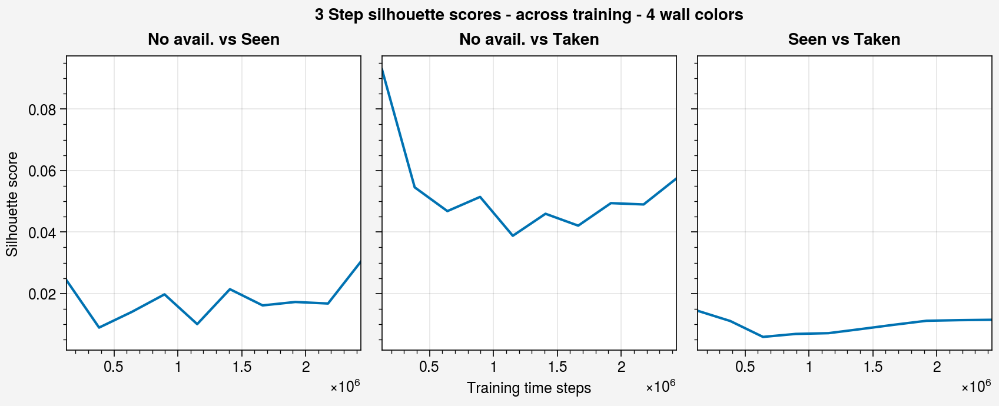

In [325]:
# only consider agents that used shortcut at least 5 times

# probs = [0.1, 0.4]
probs = [0.4]
trials = range(10)

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []}
}

p = 0.4
for chk in range(len(chks)):
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used

    for t in trials:
        key = f'{p}_{t}'
        shortcut_res = activs[key]

        res = shortcut_res[chk]
        vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
        if np.sum(used) < 5:
            continue
        activ = np.vstack(activ)

        color = vision_decision_coloring(vis, avail, used, end=3)
        none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
        none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
        vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))

    all_scores[p]['none_vs_vis'].append(np.mean(none_vs_vis))
    all_scores[p]['none_vs_taken'].append(np.mean(none_vs_taken))
    all_scores[p]['vis_vs_taken'].append(np.mean(vis_vs_taken))

    

# fig, ax = pplt.subplots(nrows=3, ncols=2)
fig, ax = pplt.subplots(ncols=3)

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']
# for j, p in enumerate(probs):
for i, key in enumerate(keys):
    # ax[i, j].boxplot(all_scores[p][key], showfliers=False)
    # ax[i, j].plot(starts, np.mean(all_scores[p][key], axis=0))
    ax[i].plot(chks*64*100, all_scores[0.4][key])
        
ax.format(xlabel='Training time steps', ylabel='Silhouette score',
         toplabels=leftlabels,
         suptitle='3 Step silhouette scores - across training - 4 wall colors')
         # leftlabels=leftlabels,)
         # xlocator=range(15), xformatter=[str(n) for n in ns])

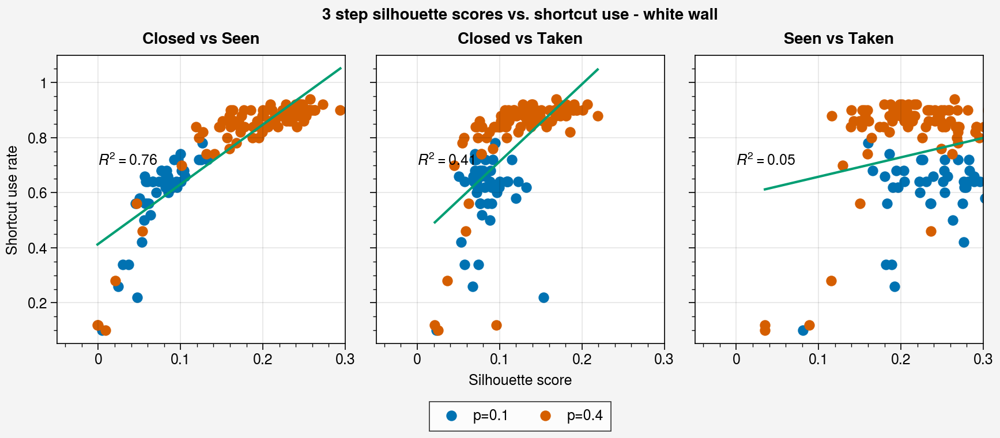

In [181]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

fig, ax = pplt.subplots(ncols=3)
legend_pts = []

comb_none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
comb_none_vs_taken = [] #no shortcut avail vs shortcut used
comb_vis_vs_taken = [] #shortcut avail but not used vs shortcut used
comb_surs = []

for p in probs:
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    surs = []
    for chk in range(len(chks)):
        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
            none_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))
            vis_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
            surs.append(np.sum(used) / 50)
    
    

    keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
    for i, key in enumerate(keys):
        pts = ax[i].scatter(globals()[key], surs, label=f'p={p}')
        if i == 0:
            legend_pts.append(pts)
        
    comb_none_vs_vis += none_vs_vis
    comb_none_vs_taken += none_vs_taken
    comb_vis_vs_taken += vis_vs_taken
    comb_surs += surs

keys = ['comb_none_vs_vis', 'comb_none_vs_taken', 'comb_vis_vs_taken']
for i, key in enumerate(keys):
    x, y, r2 = linear_bestfit(globals()[key], comb_surs)
    ax[i].plot(x, y)
    ax[i].text(0, 0.7, f'$R^2={r2:.2f}$')

leftlabels = ['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken']        
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=leftlabels,
         suptitle='3 step silhouette scores vs. shortcut use - white wall',
         xlim=[-0.05, 0.3])
fig.legend(legend_pts, loc='b')

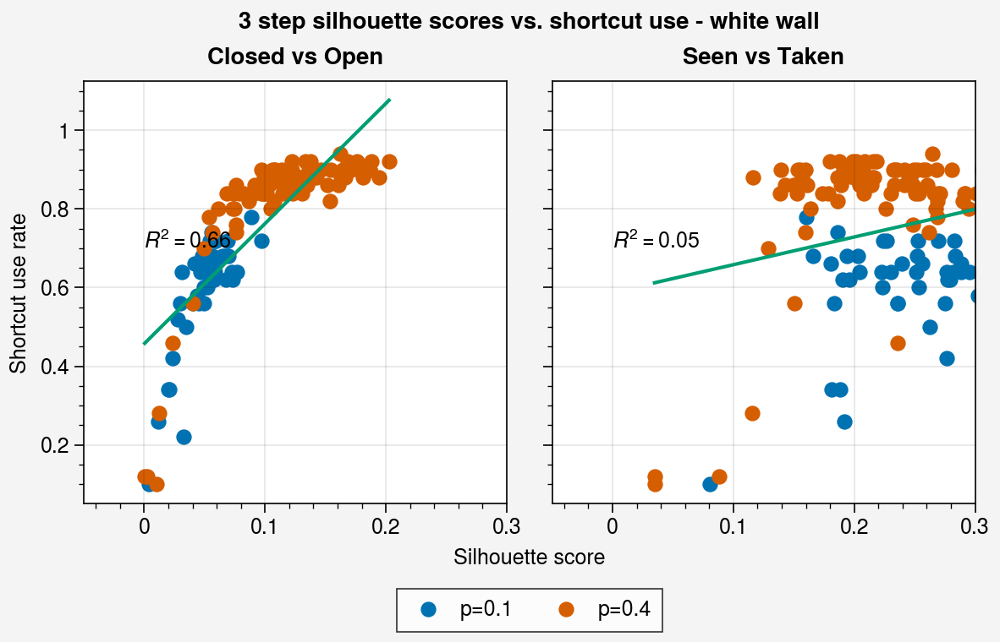

In [182]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

fig, ax = pplt.subplots(ncols=2)
legend_pts = []

comb_closed_vs_open = [] #no shortcut avail vs shortcut avail but not used
comb_vis_vs_taken = [] #shortcut avail but not used vs shortcut used
comb_surs = []

for p in probs:
    closed_vs_open = [] #no shortcut avail vs shortcut avail but not used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    surs = []
    for chk in range(len(chks)):
        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            closed_vs_open.append(two_set_silhouette_score(activ[color==0], 
                                                           activ[(color==1) | (color==2)]))
            vis_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
            surs.append(np.sum(used) / 50)
    
    

    keys = ['closed_vs_open', 'vis_vs_taken']
    for i, key in enumerate(keys):
        pts = ax[i].scatter(globals()[key], surs, label=f'p={p}')
        if i == 0:
            legend_pts.append(pts)
        
    comb_closed_vs_open += closed_vs_open
    comb_vis_vs_taken += vis_vs_taken
    comb_surs += surs

keys = ['comb_closed_vs_open', 'comb_vis_vs_taken']
for i, key in enumerate(keys):
    x, y, r2 = linear_bestfit(globals()[key], comb_surs)
    ax[i].plot(x, y)
    ax[i].text(0, 0.7, f'$R^2={r2:.2f}$')

leftlabels = ['Closed vs Open', 'Seen vs Taken']        
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=leftlabels,
         suptitle='3 step silhouette scores vs. shortcut use - white wall',
         xlim=[-0.05, 0.3])
fig.legend(legend_pts, loc='b')

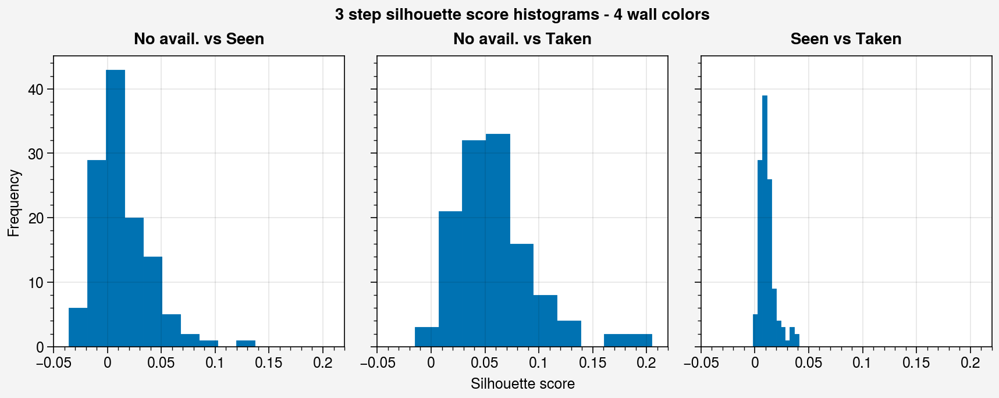

In [331]:
fig, ax = pplt.subplots(ncols=3)

# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

legend_pts = []
none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
none_vs_taken = [] #no shortcut avail vs shortcut used
vis_vs_taken = [] #shortcut avail but not used vs shortcut used

for p in probs:
    for chk in range(len(chks)):
        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
            none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
            vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))    
    

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
for i, key in enumerate(keys):
    pts = ax[i].hist(globals()[key], label=f'p={p}')

leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']        
ax.format(xlabel='Silhouette score', ylabel='Frequency',
         toplabels=leftlabels,
         suptitle='3 step silhouette score histograms - 4 wall colors',
         xlim=[-0.05, 0.22])


## First 3 steps after seeing shortcut - copied traj

### wc1.5

In [231]:
activs = pickle.load(open('data/shortcut/wc1.5_copied_moreagents/shared1_activ', 'rb'))
sur_activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))
print('Shortcut usage out of 50 episodes with open shortcuts')
print('0.1:', [np.sum(activs[f'0.1_{t}'][-1]['shortcut_used']) for t in range(10)])
print('0.4:', [np.sum(activs[f'0.4_{t}'][-1]['shortcut_used']) for t in range(10)])

Shortcut usage out of 50 episodes with open shortcuts
0.1: [37, 37, 37, 37, 37, 37, 37, 37, 37, 37]
0.4: [37, 37, 37, 37, 37, 37, 37, 37, 37, 37]


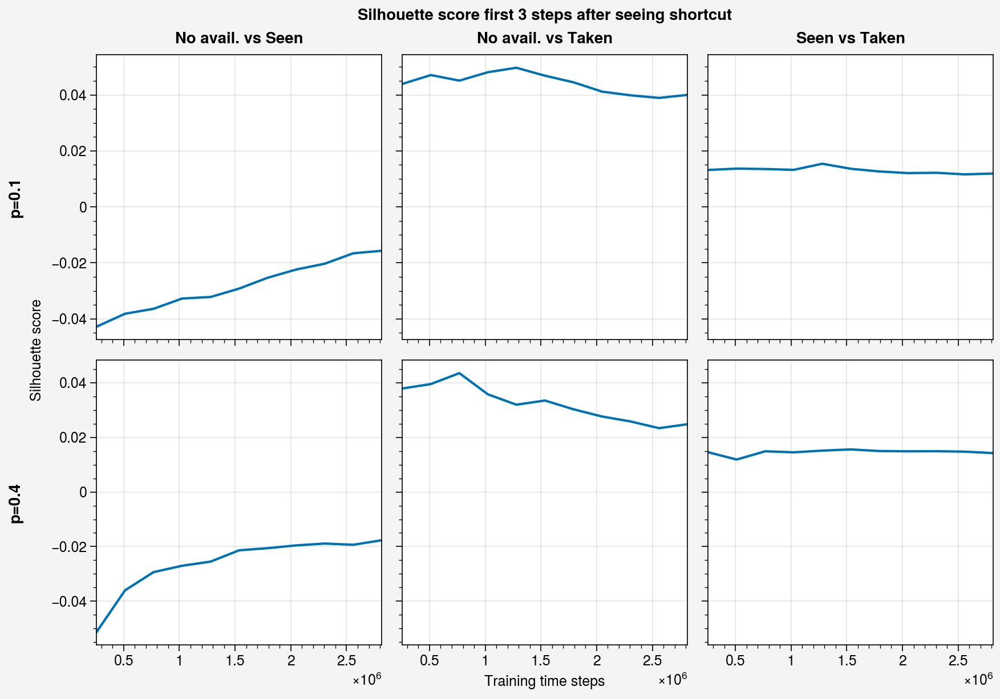

In [95]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
trials = range(10)

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []}
}

for p in probs:
    for chk in range(len(chks)):
        none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
        none_vs_taken = [] #no shortcut avail vs shortcut used
        vis_vs_taken = [] #shortcut avail but not used vs shortcut used

        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
            none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
            vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))

        all_scores[p]['none_vs_vis'].append(np.mean(none_vs_vis))
        all_scores[p]['none_vs_taken'].append(np.mean(none_vs_taken))
        all_scores[p]['vis_vs_taken'].append(np.mean(vis_vs_taken))



# fig, ax = pplt.subplots(nrows=3, ncols=2)
fig, ax = pplt.subplots(ncols=3, nrows=2)

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']
for j, p in enumerate(probs):
    for i, key in enumerate(keys):
        # ax[i, j].boxplot(all_scores[p][key], showfliers=False)
        # ax[i, j].plot(starts, np.mean(all_scores[p][key], axis=0))
        ax[j, i].plot(chks*64*100, all_scores[p][key])
        
ax.format(xlabel='Training time steps', ylabel='Silhouette score',
         toplabels=leftlabels,
         suptitle='Silhouette score first 3 steps after seeing shortcut',
         leftlabels=[f'p={p}' for p in probs],)
         # xlocator=range(15), xformatter=[str(n) for n in ns])

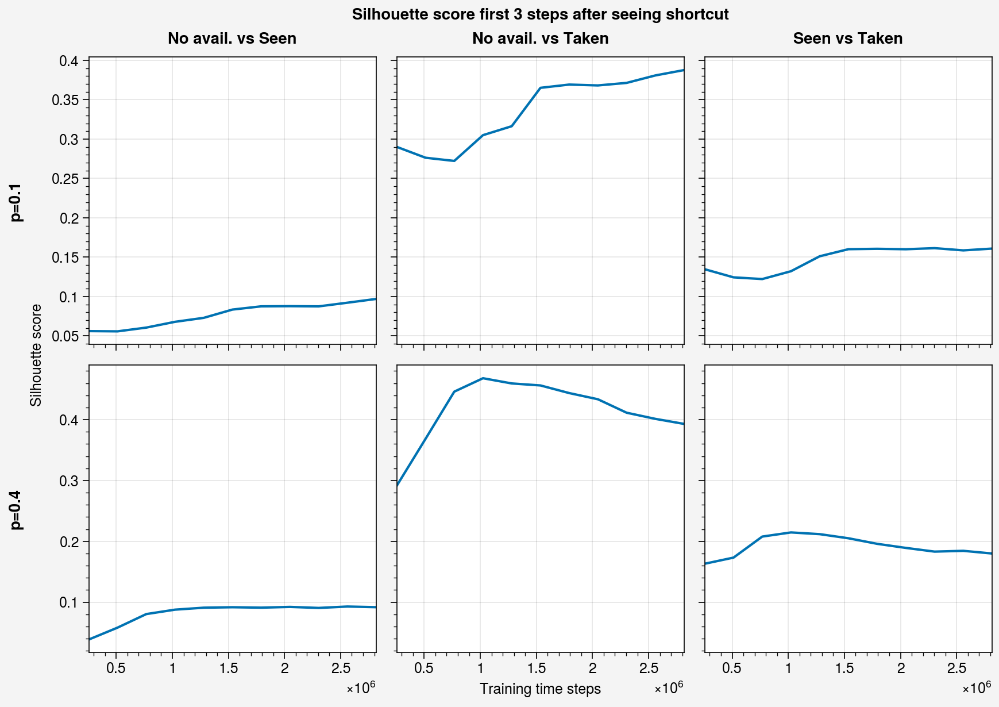

In [185]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
trials = range(10)

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []}
}

for p in probs:
    for chk in range(len(chks)):
        none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
        none_vs_taken = [] #no shortcut avail vs shortcut used
        vis_vs_taken = [] #shortcut avail but not used vs shortcut used

        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
            none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
            vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))

        all_scores[p]['none_vs_vis'].append(np.mean(none_vs_vis))
        all_scores[p]['none_vs_taken'].append(np.mean(none_vs_taken))
        all_scores[p]['vis_vs_taken'].append(np.mean(vis_vs_taken))



# fig, ax = pplt.subplots(nrows=3, ncols=2)
fig, ax = pplt.subplots(ncols=3, nrows=2)

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']
for j, p in enumerate(probs):
    for i, key in enumerate(keys):
        # ax[i, j].boxplot(all_scores[p][key], showfliers=False)
        # ax[i, j].plot(starts, np.mean(all_scores[p][key], axis=0))
        ax[j, i].plot(chks*64*100, all_scores[p][key])
        
ax.format(xlabel='Training time steps', ylabel='Silhouette score',
         toplabels=leftlabels,
         suptitle='Silhouette score first 3 steps after seeing shortcut',
         leftlabels=[f'p={p}' for p in probs],)
         # xlocator=range(15), xformatter=[str(n) for n in ns])

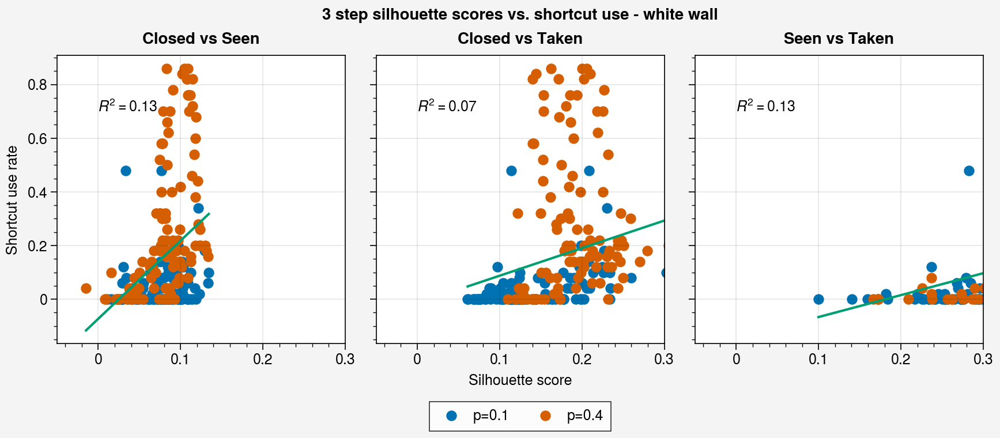

In [232]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

fig, ax = pplt.subplots(ncols=3)
legend_pts = []

comb_none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
comb_none_vs_taken = [] #no shortcut avail vs shortcut used
comb_vis_vs_taken = [] #shortcut avail but not used vs shortcut used
comb_surs = []

for p in probs:
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    surs = []
    for chk in range(len(chks)):
        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
            none_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))
            vis_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
            used = sur_activs[key][chk]['shortcut_used']
            surs.append(np.sum(used) / 50)
    
    

    keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
    for i, key in enumerate(keys):
        pts = ax[i].scatter(globals()[key], surs, label=f'p={p}')
        if i == 0:
            legend_pts.append(pts)
        
    comb_none_vs_vis += none_vs_vis
    comb_none_vs_taken += none_vs_taken
    comb_vis_vs_taken += vis_vs_taken
    comb_surs += surs

keys = ['comb_none_vs_vis', 'comb_none_vs_taken', 'comb_vis_vs_taken']
for i, key in enumerate(keys):
    x, y, r2 = linear_bestfit(globals()[key], comb_surs)
    ax[i].plot(x, y)
    ax[i].text(0, 0.7, f'$R^2={r2:.2f}$')

leftlabels = ['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken']        
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=leftlabels,
         suptitle='3 step silhouette scores vs. shortcut use - white wall',
         xlim=[-0.05, 0.3])
fig.legend(legend_pts, loc='b')

### wc4

In [102]:
activs = pickle.load(open('data/shortcut/wc4_copied_moreagents/shared1_activ', 'rb'))

print('Shortcut usage out of 50 episodes with open shortcuts')
print('0.1:', [np.sum(activs[f'0.1_{t}'][-1]['shortcut_used']) for t in range(10)])
print('0.4:', [np.sum(activs[f'0.4_{t}'][-1]['shortcut_used']) for t in range(10)])

Shortcut usage out of 50 episodes with open shortcuts
0.1: [37, 37, 37, 37, 37, 37, 37, 37, 37, 37]
0.4: [37, 37, 37, 37, 37, 37, 37, 37, 37, 37]


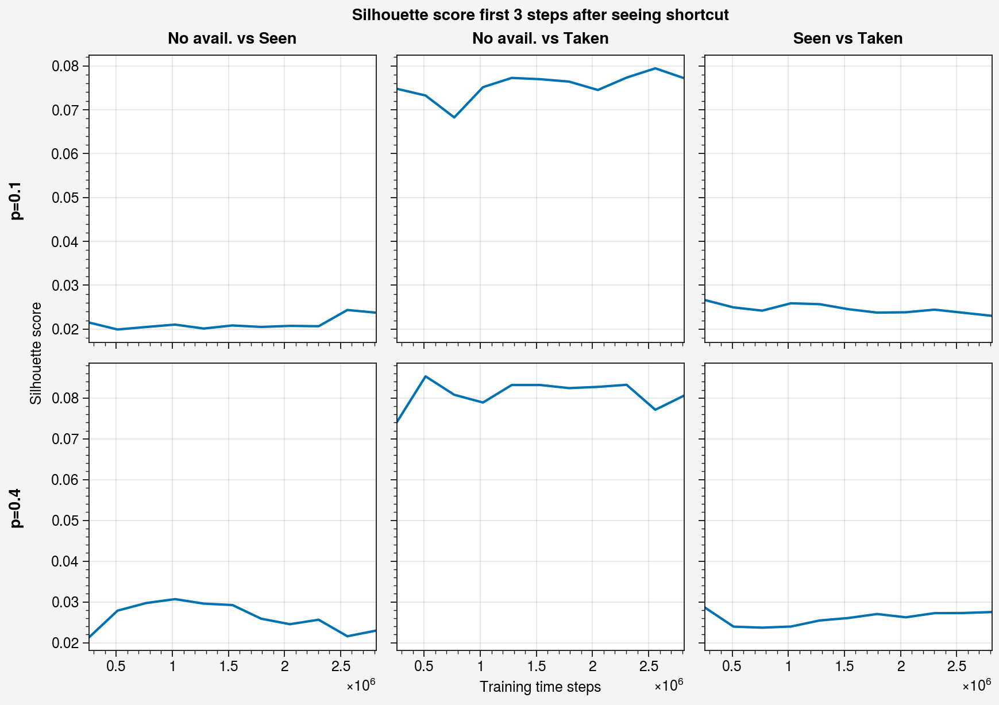

In [103]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
trials = range(10)

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []}
}

for p in probs:
    for chk in range(len(chks)):
        none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
        none_vs_taken = [] #no shortcut avail vs shortcut used
        vis_vs_taken = [] #shortcut avail but not used vs shortcut used

        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
            none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
            vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))

        all_scores[p]['none_vs_vis'].append(np.mean(none_vs_vis))
        all_scores[p]['none_vs_taken'].append(np.mean(none_vs_taken))
        all_scores[p]['vis_vs_taken'].append(np.mean(vis_vs_taken))



# fig, ax = pplt.subplots(nrows=3, ncols=2)
fig, ax = pplt.subplots(ncols=3, nrows=2)

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']
for j, p in enumerate(probs):
    for i, key in enumerate(keys):
        # ax[i, j].boxplot(all_scores[p][key], showfliers=False)
        # ax[i, j].plot(starts, np.mean(all_scores[p][key], axis=0))
        ax[j, i].plot(chks*64*100, all_scores[p][key])
        
ax.format(xlabel='Training time steps', ylabel='Silhouette score',
         toplabels=leftlabels,
         suptitle='Silhouette score first 3 steps after seeing shortcut',
         leftlabels=[f'p={p}' for p in probs],)
         # xlocator=range(15), xformatter=[str(n) for n in ns])

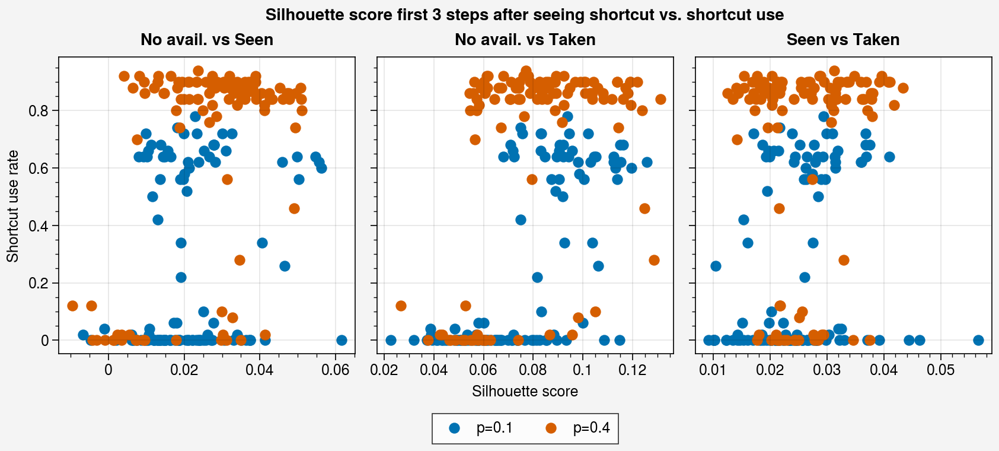

In [104]:
# only consider agents that used shortcut at least 5 times
all_surs = pickle.load(open('data/shortcut/wc4_policy_moreagents/shared1_activ', 'rb'))

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

fig, ax = pplt.subplots(ncols=3)
legend_pts = []
for p in probs:
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    surs = []
    for chk in range(len(chks)):
        for t in trials:
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            used = all_surs[key][chk]['shortcut_used']
            surs.append(np.sum(used) / 50)
            
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
            none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
            vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))
    
    

    keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
    for i, key in enumerate(keys):
        pts = ax[i].scatter(globals()[key], surs, label=f'p={p}')
        if i == 0:
            legend_pts.append(pts)

leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']        
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=leftlabels,
         suptitle='Silhouette score first 3 steps after seeing shortcut vs. shortcut use')
fig.legend(legend_pts, loc='b')

# Subpopulation Analysis

In [114]:
activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))


In [185]:
shortcut_res = activs['0.4_0']
res = shortcut_res[-1]
vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
color = vision_decision_coloring(vis, avail, used, end=3)
color2 = comparative_vision_decision_coloring(vis, used, end=3)

In [150]:
pca = PCA()
activ_pca = pca.fit_transform(activ)

a0 = activ[color == 0]
a1 = activ[color == 1]
a2 = activ[color == 2]

# a0 = activ_pca[color == 0]
# a1 = activ_pca[color == 1]
# a2 = activ_pca[color == 2]



<a list of 20 PolyCollection objects>

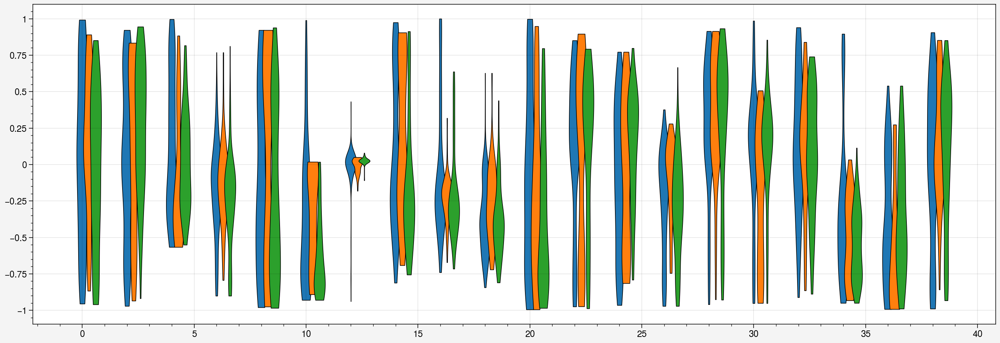

In [151]:
fig, ax = pplt.subplots(refaspect=3, figwidth=14)
m = 20

ax.violin(np.arange(m)*2, a0[:, :m], fc=rgb_colors[0])
ax.violin(np.arange(m)*2+0.3, a1[:, :m], fc=rgb_colors[1])
ax.violin(np.arange(m)*2+0.6, a2[:, :m], fc=rgb_colors[2])

0.08474538708155753


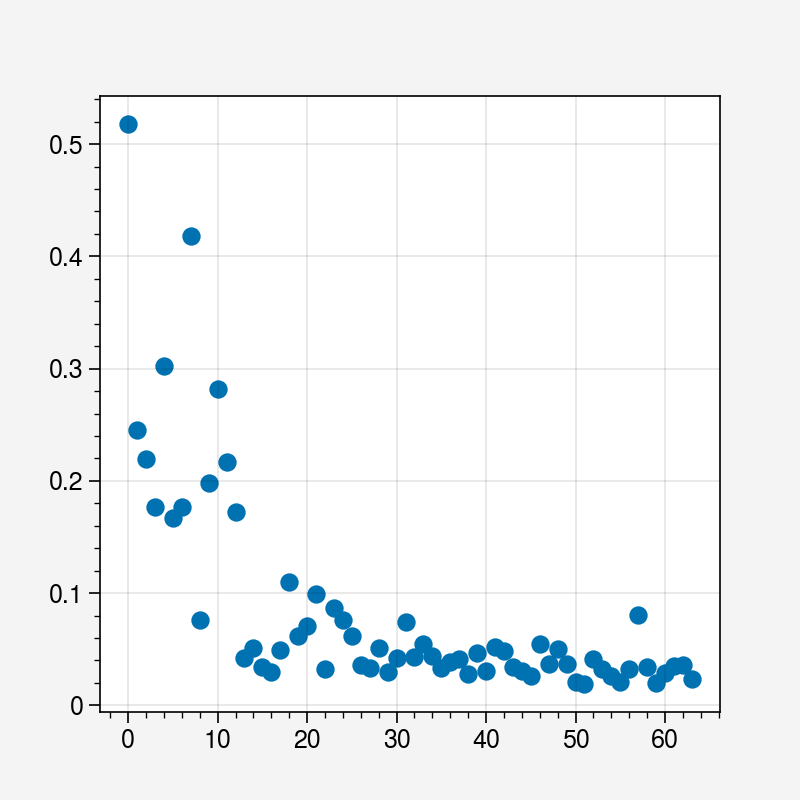

In [144]:
dists = []
for i in range(64):
    dists.append(wasserstein_distance(a0[:, i],  a2[:, i]))
print(np.mean(dists))
plt.scatter(range(64), dists)

0.10019360037389431


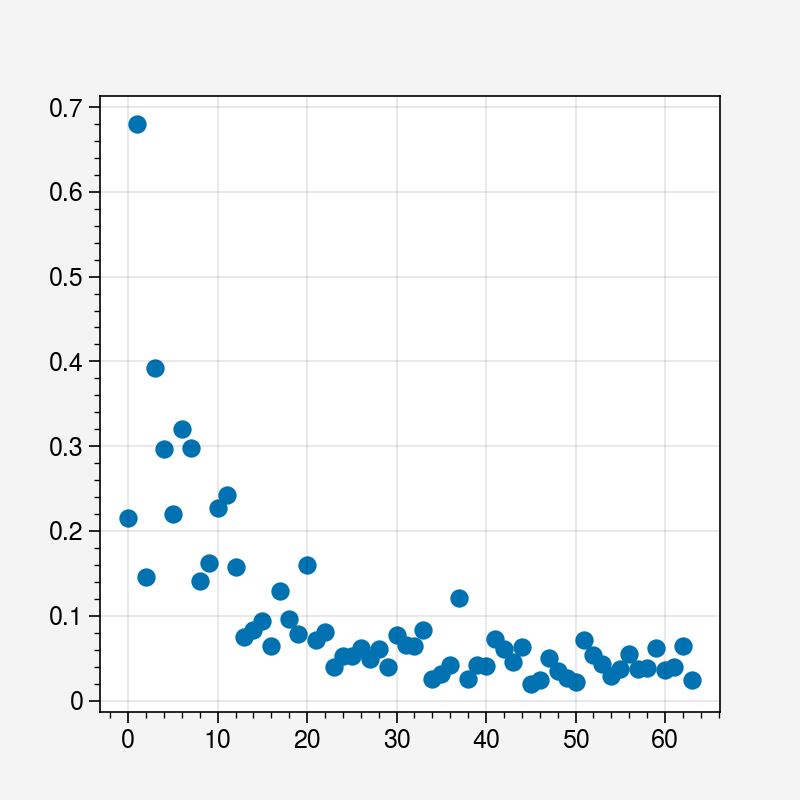

In [145]:
dists = []
for i in range(64):
    dists.append(wasserstein_distance(a0[:, i],  a1[:, i]))
print(np.mean(dists))
plt.scatter(range(64), dists)

0.12216627576872545


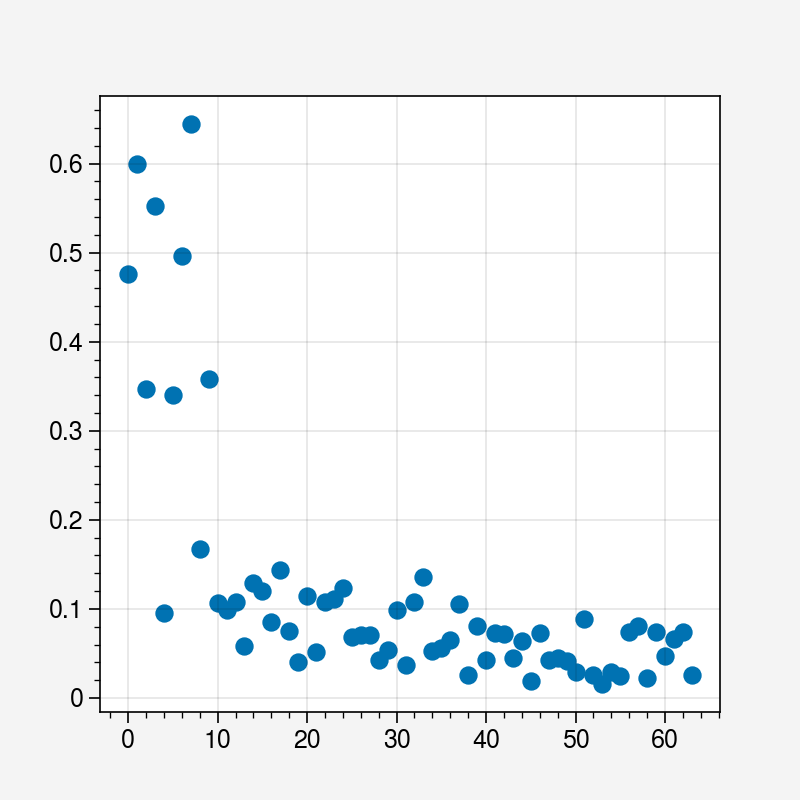

In [146]:
dists = []
for i in range(64):
    dists.append(wasserstein_distance(a1[:, i],  a2[:, i]))
print(np.mean(dists))
plt.scatter(range(64), dists)

#### Compare across episodes with shortcut open or not

In [189]:
shortcut_res = activs['0.4_0']
res = shortcut_res[-1]
vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
activ = np.vstack(activ)
color = vision_decision_coloring(vis, avail, used, end=3)
color2 = comparative_vision_decision_coloring(vis, used, end=3)

pca = PCA()
activ_pca = pca.fit_transform(activ)

# a0 = activ[color == 0]
# a1 = activ[color == 1]
# a2 = activ[color == 2]

# Episodes where shortcut was closed, but when opened agent took it
a0 = activ_pca[color2 == 1]
a1 = activ_pca[color == 1]
a2 = activ_pca[color == 2]



<a list of 20 PolyCollection objects>

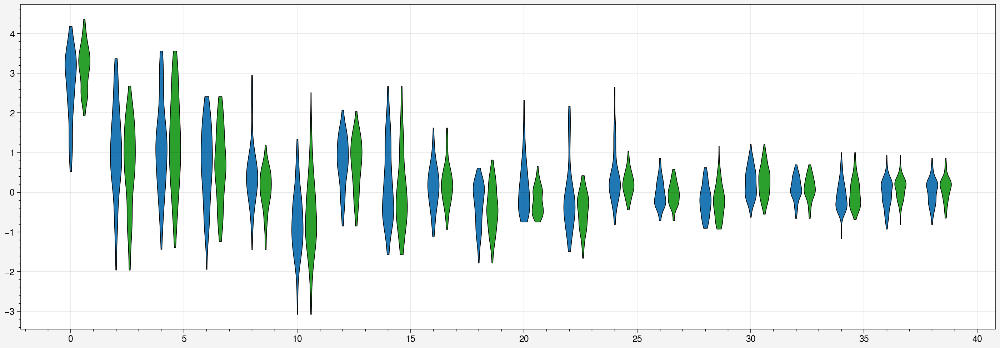

In [194]:
fig, ax = pplt.subplots(refaspect=3, figwidth=14)
m = 20

ax.violin(np.arange(m)*2, a0[:, :m], fc=rgb_colors[0])
# ax.violin(np.arange(m)*2+0.3, a1[:, :m], fc=rgb_colors[1])
ax.violin(np.arange(m)*2+0.6, a2[:, :m], fc=rgb_colors[2])

0.26766246221687595


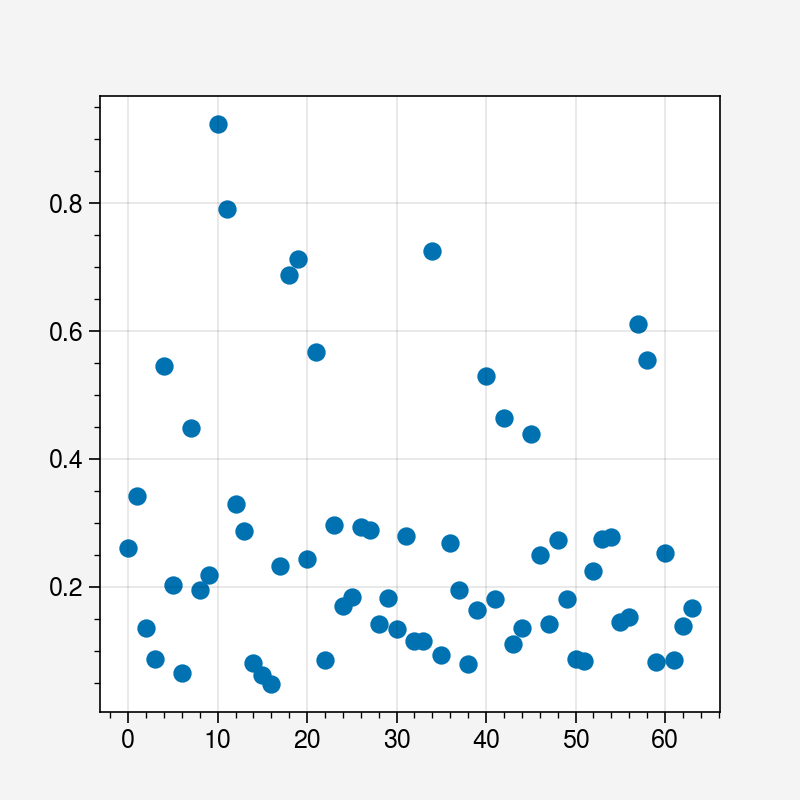

In [207]:
dists = []
for i in range(64):
    dists.append(wasserstein_distance(a0[:, i],  a2[:, i]) / (np.sqrt(np.abs(np.mean(a0[:, i])))))
print(np.mean(dists))
plt.scatter(range(64), np.abs(dists))

6

<a list of 6 PolyCollection objects>

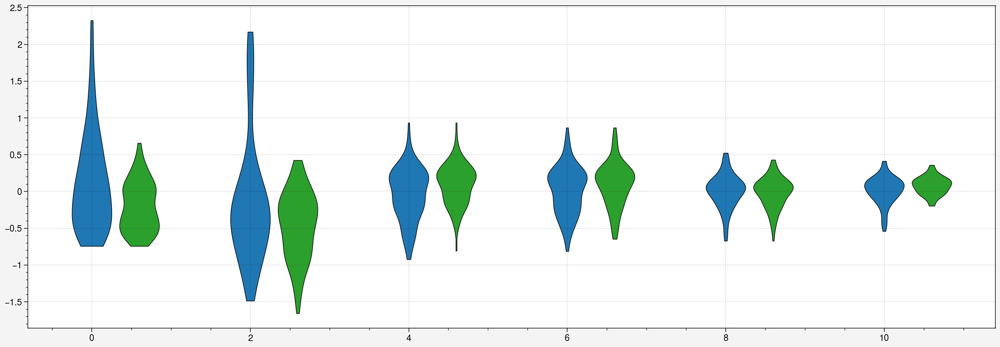

In [208]:
fig, ax = pplt.subplots(refaspect=3, figwidth=14)
m = 20
idxs = np.abs(dists) > 0.6
ax.violin(np.arange(idxs.sum())*2, a0[:, idxs], fc=rgb_colors[0])
# ax.violin(np.arange(m)*2+0.3, a1[:, :m], fc=rgb_colors[1])
ax.violin(np.arange(idxs.sum())*2+0.6, a2[:, idxs], fc=rgb_colors[2])

0.0777978721718223


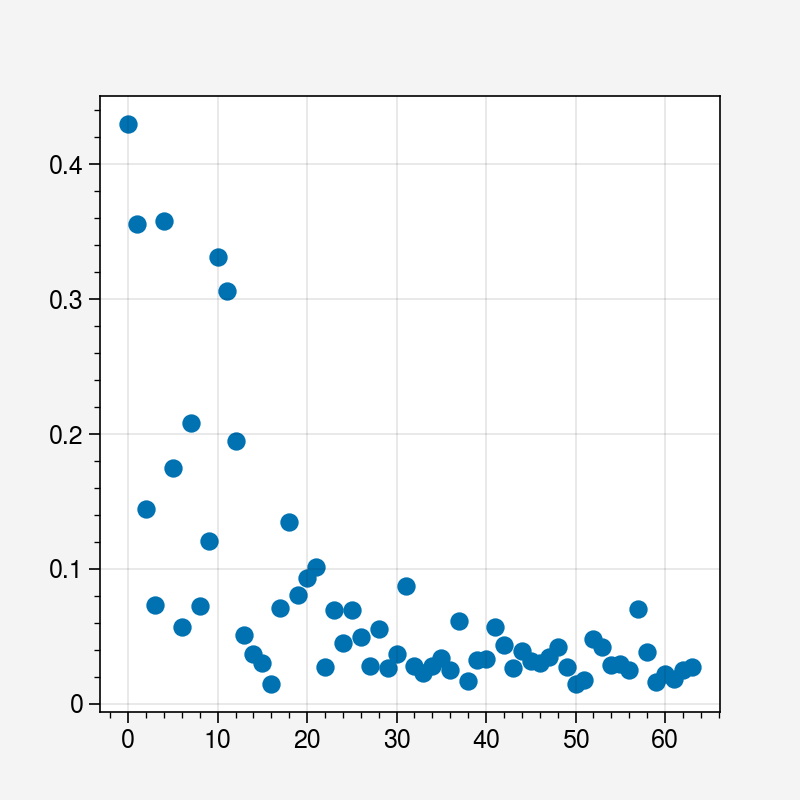

In [198]:
dists = []
for i in range(64):
    dists.append(wasserstein_distance(a0[:, i],  a2[:, i]))
print(np.mean(dists))
plt.scatter(range(64), dists)

In [209]:
shortcut_res = activs['0.4_0']
res = shortcut_res[-1]
vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
activ = np.vstack(activ)
color = vision_decision_coloring(vis, avail, used, end=3)
color2 = comparative_vision_decision_coloring(vis, used, end=3)

pca = PCA()
activ_pca = pca.fit_transform(activ)

a0 = activ[color2 == 1]
a1 = activ[color == 1]
a2 = activ[color == 2]

# Episodes where shortcut was closed, but when opened agent took it
# a0 = activ_pca[color2 == 1]
# a1 = activ_pca[color == 1]
# a2 = activ_pca[color == 2]



0.1058107568703667


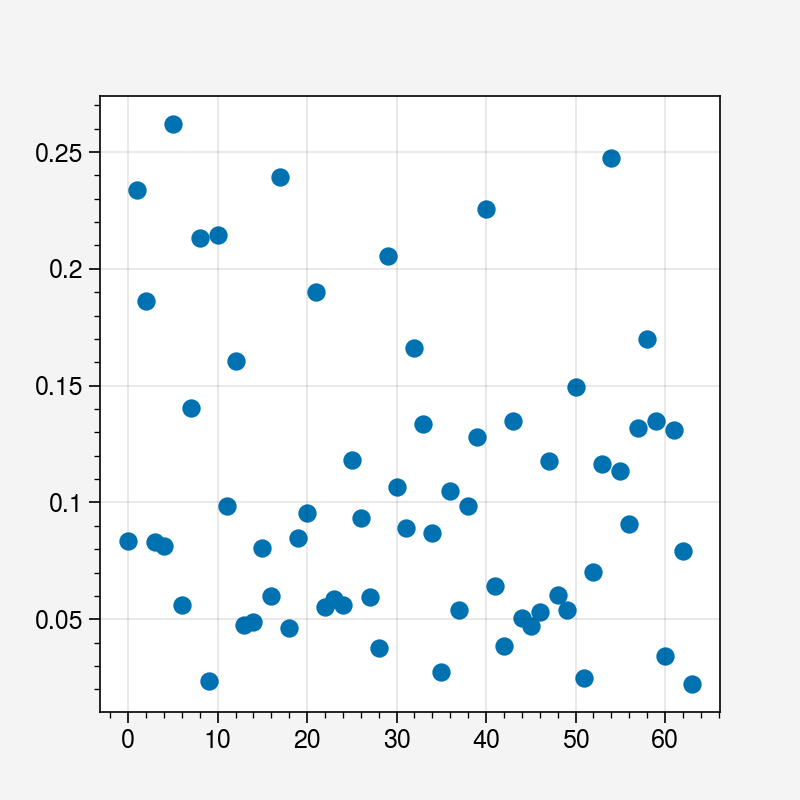

In [212]:
dists = []
for i in range(64):
    # dists.append(wasserstein_distance(a0[:, i],  a2[:, i]) / (np.sqrt(np.abs(np.mean(a0[:, i])))))
    dists.append(wasserstein_distance(a0[:, i],  a2[:, i]))
print(np.mean(dists))
plt.scatter(range(64), np.abs(dists))

<a list of 6 PolyCollection objects>

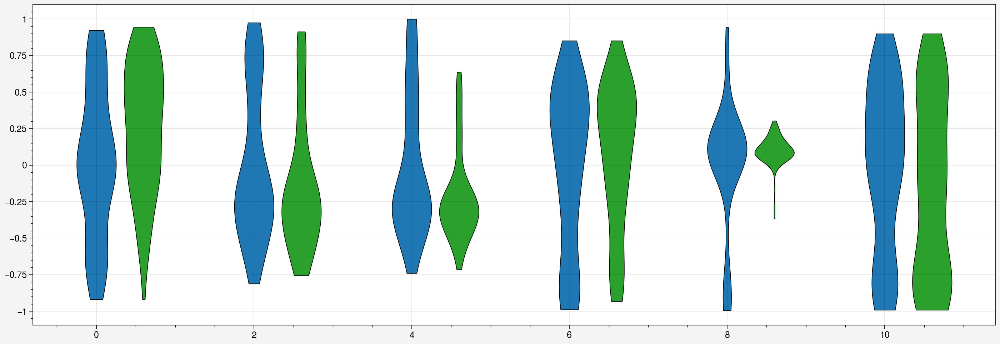

In [211]:
fig, ax = pplt.subplots(refaspect=3, figwidth=14)
m = 20
idxs = np.abs(dists) > 1
ax.violin(np.arange(idxs.sum())*2, a0[:, idxs], fc=rgb_colors[0])
# ax.violin(np.arange(m)*2+0.3, a1[:, :m], fc=rgb_colors[1])
ax.violin(np.arange(idxs.sum())*2+0.6, a2[:, idxs], fc=rgb_colors[2])

<a list of 13 PolyCollection objects>

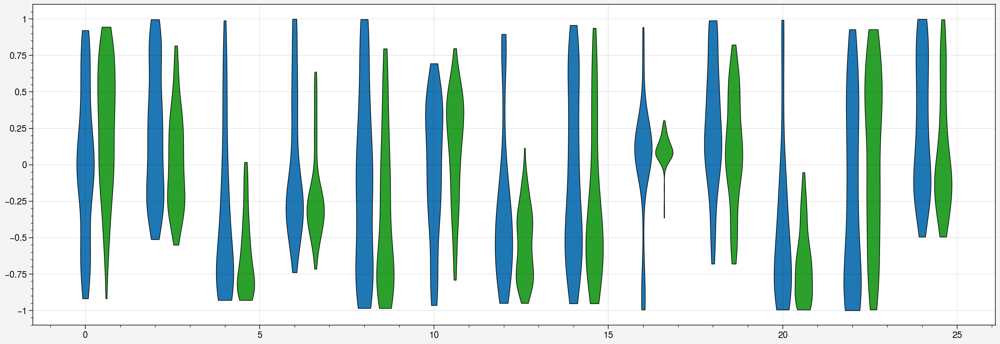

In [213]:
fig, ax = pplt.subplots(refaspect=3, figwidth=14)
m = 20
idxs = np.abs(dists) > 0.15
ax.violin(np.arange(idxs.sum())*2, a0[:, idxs], fc=rgb_colors[0])
# ax.violin(np.arange(m)*2+0.3, a1[:, :m], fc=rgb_colors[1])
ax.violin(np.arange(idxs.sum())*2+0.6, a2[:, idxs], fc=rgb_colors[2])

<a list of 11 PolyCollection objects>

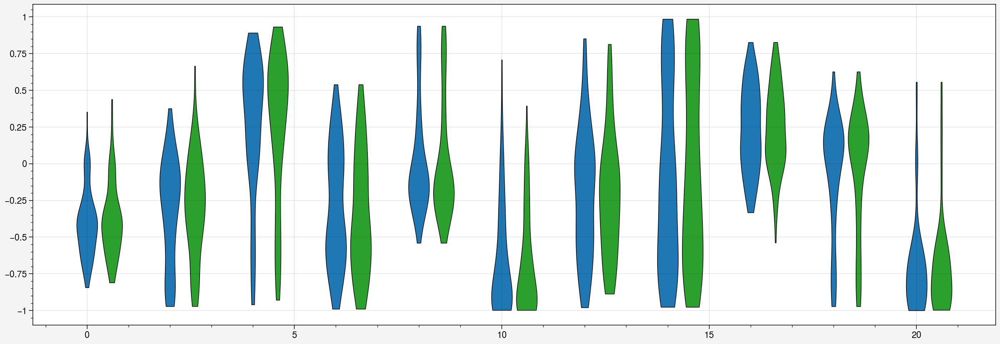

In [240]:
fig, ax = pplt.subplots(refaspect=3, figwidth=14)
m = 20
idxs = np.abs(dists) < 0.05
ax.violin(np.arange(idxs.sum())*2, a0[:, idxs], fc=rgb_colors[0])
# ax.violin(np.arange(m)*2+0.3, a1[:, :m], fc=rgb_colors[1])
ax.violin(np.arange(idxs.sum())*2+0.6, a2[:, idxs], fc=rgb_colors[2])

In [242]:
np.argwhere(idxs).squeeze()

array([ 9, 13, 14, 18, 28, 35, 42, 45, 51, 60, 63], dtype=int64)

#### View highly differentiating node activations upon seeing/deciding

In [216]:
i = 1

shortcut_res = activs['0.4_0']
res = shortcut_res[-1]
vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
activ = np.vstack(activ)
color = vision_decision_coloring(vis, avail, used, end=3)
color2 = comparative_vision_decision_coloring(vis, used, end=3)

fig, ax = pplt.subplots(nrows=2, ncols=10)


In [231]:
node_id = 1

shortcut_res = activs['0.4_0']
res = shortcut_res[-1]
vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']

used = np.argwhere(np.squeeze(used)).squeeze()
closed = used - 50



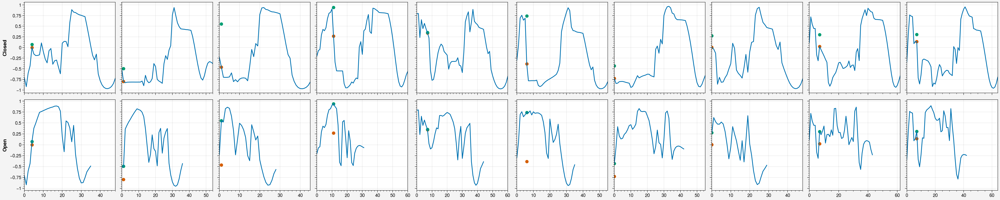

In [239]:
node_id = 1

shortcut_res = activs['0.4_0']
res = shortcut_res[-1]
vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']

used = np.argwhere(np.squeeze(used)).squeeze()
closed = used - 50

fig, ax = pplt.subplots(nrows=2, ncols=10)

# for i in range(len(used)):
for i in range(10):
    used_activ = activ[used[i]][:, node_id]
    closed_activ = activ[closed[i]][:, node_id]
    
    used_first = np.argmax(vis[used[i]])
    closed_first = np.argmax(vis[closed[i]])
    
    ax[0, i].plot(closed_activ)
    ax[1, i].plot(used_activ)
    
    ax[0, i].scatter([closed_first], [closed_activ[closed_first]])
    ax[0, i].scatter([used_first], [used_activ[used_first]])
    
    ax[1, i].scatter([closed_first], [closed_activ[closed_first]])
    ax[1, i].scatter([used_first], [used_activ[used_first]])

ax.format(leftlabels=['Closed', 'Open'])
    
    

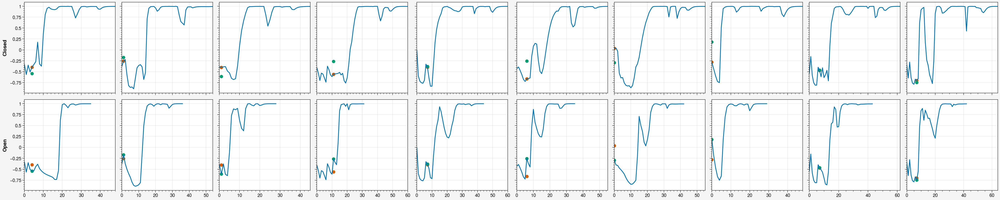

In [243]:
node_id = 9

shortcut_res = activs['0.4_0']
res = shortcut_res[-1]
vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']

used = np.argwhere(np.squeeze(used)).squeeze()
closed = used - 50

fig, ax = pplt.subplots(nrows=2, ncols=10)

# for i in range(len(used)):
for i in range(10):
    used_activ = activ[used[i]][:, node_id]
    closed_activ = activ[closed[i]][:, node_id]
    
    used_first = np.argmax(vis[used[i]])
    closed_first = np.argmax(vis[closed[i]])
    
    ax[0, i].plot(closed_activ)
    ax[1, i].plot(used_activ)
    
    ax[0, i].scatter([closed_first], [closed_activ[closed_first]])
    ax[0, i].scatter([used_first], [used_activ[used_first]])
    
    ax[1, i].scatter([closed_first], [closed_activ[closed_first]])
    ax[1, i].scatter([used_first], [used_activ[used_first]])

ax.format(leftlabels=['Closed', 'Open'])
    
    

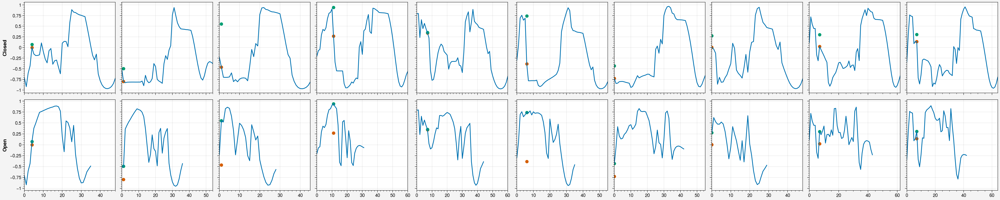

In [239]:
node_id = 1

shortcut_res = activs['0.4_0']
res = shortcut_res[-1]
vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']

used = np.argwhere(np.squeeze(used)).squeeze()
closed = used - 50

fig, ax = pplt.subplots(nrows=2, ncols=10)

# for i in range(len(used)):
for i in range(10):
    used_activ = activ[used[i]][:, node_id]
    closed_activ = activ[closed[i]][:, node_id]
    
    used_first = np.argmax(vis[used[i]])
    closed_first = np.argmax(vis[closed[i]])
    
    ax[0, i].plot(closed_activ)
    ax[1, i].plot(used_activ)
    
    ax[0, i].scatter([closed_first], [closed_activ[closed_first]])
    ax[0, i].scatter([used_first], [used_activ[used_first]])
    
    ax[1, i].scatter([closed_first], [closed_activ[closed_first]])
    ax[1, i].scatter([used_first], [used_activ[used_first]])

ax.format(leftlabels=['Closed', 'Open'])
    
    

In [ ]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [],  'vis_vs_taken': []}
}

p = 0.4
for chk in range(len(chks)):
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used

    for t in trials:
        key = f'{p}_{t}'
        shortcut_res = activs[key]

        res = shortcut_res[chk]
        vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
        if np.sum(used) < 5:
            continue
        activ = np.vstack(activ)

        color = vision_decision_coloring(vis, avail, used, end=3)
        none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
        none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
        vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))

    all_scores[p]['none_vs_vis'].append(np.mean(none_vs_vis))
    all_scores[p]['none_vs_taken'].append(np.mean(none_vs_taken))
    all_scores[p]['vis_vs_taken'].append(np.mean(vis_vs_taken))

    

# fig, ax = pplt.subplots(nrows=3, ncols=2)
fig, ax = pplt.subplots(ncols=3)

keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']
# for j, p in enumerate(probs):
for i, key in enumerate(keys):
    # ax[i, j].boxplot(all_scores[p][key], showfliers=False)
    # ax[i, j].plot(starts, np.mean(all_scores[p][key], axis=0))
    ax[i].plot(chks*64*100, all_scores[0.4][key])
        
ax.format(xlabel='Training time steps', ylabel='Silhouette score',
         toplabels=leftlabels,
         suptitle='Silhouette score first 3 steps after seeing shortcut')
         # leftlabels=leftlabels,)
         # xlocator=range(15), xformatter=[str(n) for n in ns])

# Test cloned agent shortcut use rates

Quite strange that in transfer cloning experiments, 4 wall color agents seem to perform better  

## wc4

In [295]:
activs = pickle.load(open('data/shortcut/clone_wc4/shared1_activ', 'rb'))

chks1 = np.arange(10, 194, 20)
chks2 = np.arange(20, 389, 40)

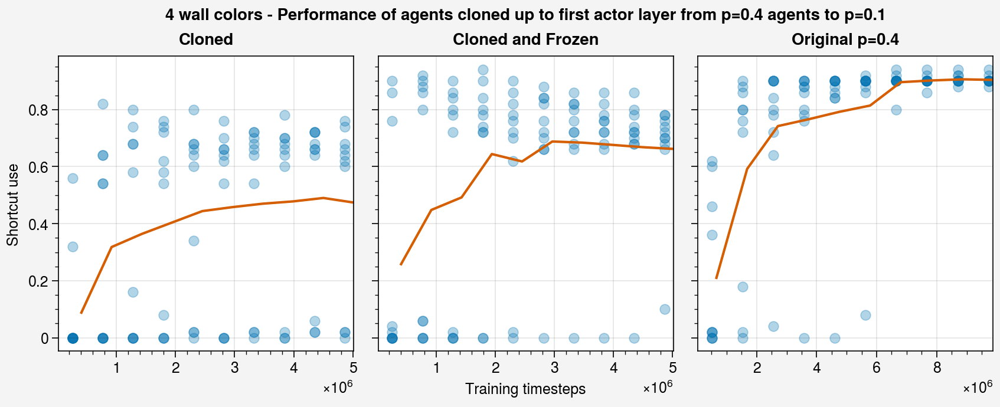

In [297]:
prefixes = ['cloactor0', 'clofractor0', '0.4']
trials = range(10)

fig, ax = pplt.subplots(ncols=3)

for i, pre in enumerate(prefixes):
    xs = []
    ys = []
    for t in trials:
        x = []
        y = []
        if pre in ['cloactor0', 'clofractor0']:
            chks = chks1
        else:
            chks = chks2

        key = f'{pre}_{t}'
        shortcut_res = activs[key]
        for j in range(len(chks)):
            res = shortcut_res[j]
            y.append(np.sum(res['shortcut_used']) / 50)
            x.append(chks[j]*256*100)
        xs.append(x)
        ys.append(y)
            
    ax[i].scatter(np.concatenate(xs), np.concatenate(ys), alpha=0.3)
    ax[i].plot(np.mean(xs, axis=0)+1.5e5, np.mean(ys, axis=0))

ax.format(toplabels=['Cloned', 'Cloned and Frozen', 'Original p=0.4'],
         ylabel='Shortcut use', xlabel='Training timesteps',
         suptitle='4 wall colors - Performance of agents cloned up to first actor layer from p=0.4 agents to p=0.1')

## wc1.5

In [298]:
activs = pickle.load(open('data/shortcut/clone_wc1.5/shared1_activ', 'rb'))

chks1 = np.arange(10, 194, 20)
chks2 = np.arange(20, 389, 40)

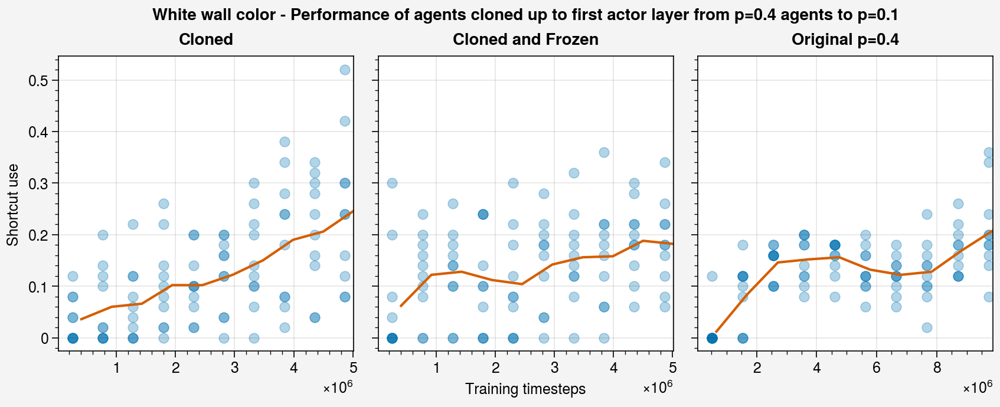

In [300]:
prefixes = ['cloactor0', 'clofractor0', '0.4']
trials = range(10)

fig, ax = pplt.subplots(ncols=3)

for i, pre in enumerate(prefixes):
    xs = []
    ys = []
    for t in trials:
        x = []
        y = []
        if pre in ['cloactor0', 'clofractor0']:
            chks = chks1
        else:
            chks = chks2

        key = f'{pre}_{t}'
        shortcut_res = activs[key]
        for j in range(len(chks)):
            res = shortcut_res[j]
            y.append(np.sum(res['shortcut_used']) / 50)
            x.append(chks[j]*256*100)
        xs.append(x)
        ys.append(y)
            
    ax[i].scatter(np.concatenate(xs), np.concatenate(ys), alpha=0.3)
    ax[i].plot(np.mean(xs, axis=0)+1.5e5, np.mean(ys, axis=0))

ax.format(toplabels=['Cloned', 'Cloned and Frozen', 'Original p=0.4'],
         ylabel='Shortcut use', xlabel='Training timesteps',
         suptitle='White wall color - Performance of agents cloned up to first actor layer from p=0.4 agents to p=0.1')

## 3 step silhouette scores for cloned agents

### wc4

In [301]:
activs = pickle.load(open('data/shortcut/clone_wc4/shared1_activ', 'rb'))

chks1 = np.arange(10, 194, 20)
chks2 = np.arange(20, 389, 40)

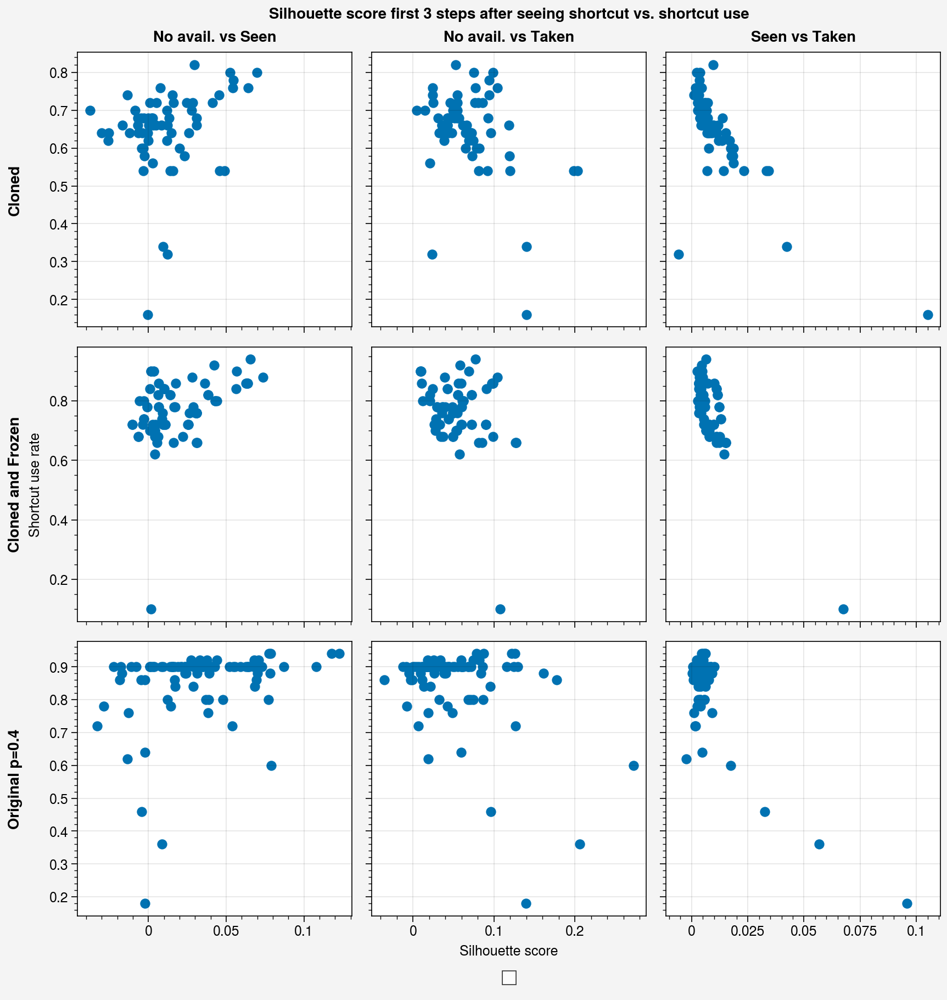

In [302]:
legend_pts = []
prefixes = ['cloactor0', 'clofractor0', '0.4']
trials = range(10)

fig, ax = pplt.subplots(nrows=3, ncols=3)

for i, pre in enumerate(prefixes):
    if pre in ['cloactor0', 'clofractor0']:
        chks = chks1
    else:
        chks = chks2
    
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    surs = []
    for chk in range(len(chks)):
        for t in trials:
            key = f'{pre}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
            none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
            vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))
            surs.append(np.sum(used) / 50)
    
    keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
    for j, key in enumerate(keys):
        pts = ax[i, j].scatter(globals()[key], surs, label=f'p={p}')

toplabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']        
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=toplabels,
         leftlabels=['Cloned', 'Cloned and Frozen', 'Original p=0.4'],
         suptitle='Silhouette score first 3 steps after seeing shortcut vs. shortcut use')
fig.legend(legend_pts, loc='b')

### wc1.5

In [303]:
activs = pickle.load(open('data/shortcut/clone_wc1.5/shared1_activ', 'rb'))

chks1 = np.arange(10, 194, 20)
chks2 = np.arange(20, 389, 40)

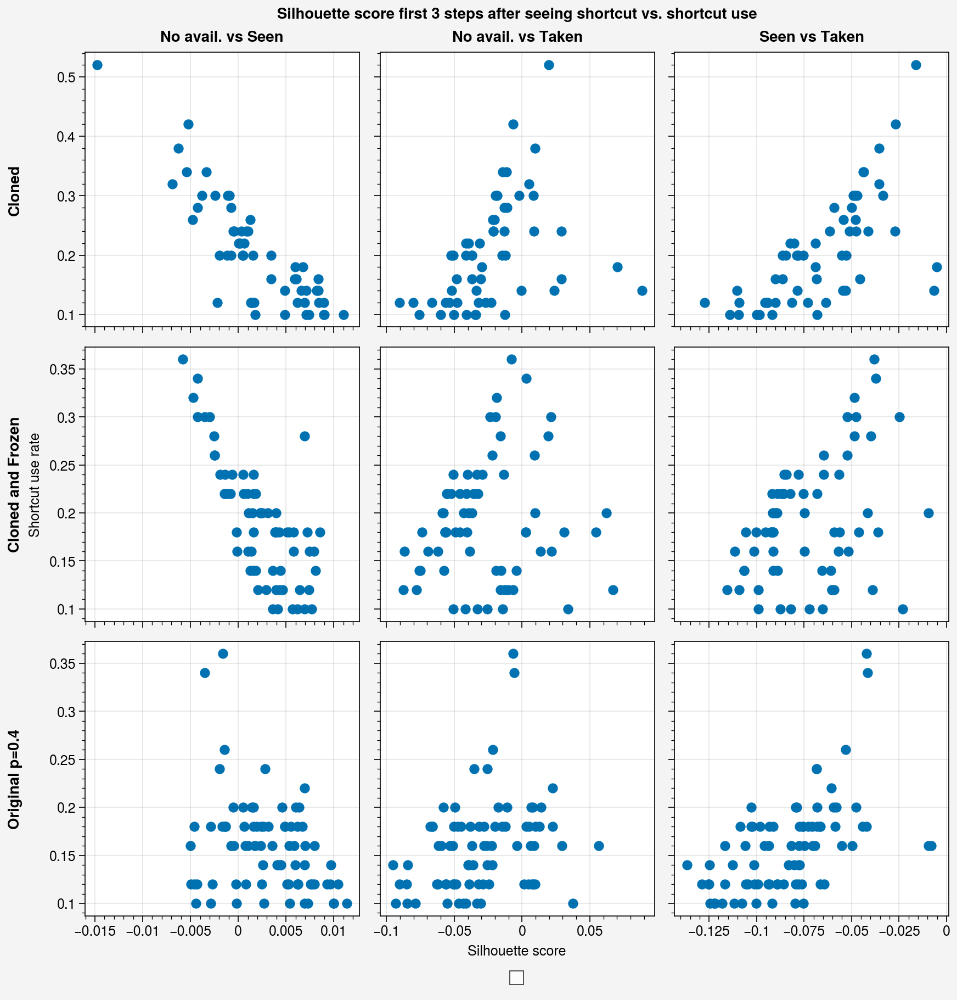

In [304]:
legend_pts = []
prefixes = ['cloactor0', 'clofractor0', '0.4']
trials = range(10)

fig, ax = pplt.subplots(nrows=3, ncols=3)

for i, pre in enumerate(prefixes):
    if pre in ['cloactor0', 'clofractor0']:
        chks = chks1
    else:
        chks = chks2
    
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used
    surs = []
    for chk in range(len(chks)):
        for t in trials:
            key = f'{pre}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue
            activ = np.vstack(activ)

            color = vision_decision_coloring(vis, avail, used, end=3)
            none_vs_vis.append(two_set_silhouette_score(activ[color==0], activ[color==1]))
            none_vs_taken.append(two_set_silhouette_score(activ[color==1], activ[color==2]))
            vis_vs_taken.append(two_set_silhouette_score(activ[color==0], activ[color==2]))
            surs.append(np.sum(used) / 50)
    
    keys = ['none_vs_vis', 'none_vs_taken', 'vis_vs_taken']
    for j, key in enumerate(keys):
        pts = ax[i, j].scatter(globals()[key], surs, label=f'p={p}')

toplabels = ['No avail. vs Seen', 'No avail. vs Taken', 'Seen vs Taken']        
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=toplabels,
         leftlabels=['Cloned', 'Cloned and Frozen', 'Original p=0.4'],
         suptitle='Silhouette score first 3 steps after seeing shortcut vs. shortcut use')
fig.legend(legend_pts, loc='b')

In [305]:
len(surs)

79

# 3 step silhouette scores for corresponding episodes

Looking at corresponding episodes shows that visual information still dominates population activity. Unsurprising, since the colored shortcut wall is a significant visual cue that changes information, and hence activations. Seeing constituitively high silhouette scores between corresponding open and closed episodes even throughout training should not be surprising, and does not invalidate our previous results about correlation between **average** population activity on closed vs. taken episodes.

## wc1.5

In [69]:
activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

print('Shortcut usage out of 50 episodes with open shortcuts')
print('0.1:', [np.sum(activs[f'0.1_{t}'][-1]['shortcut_used']) for t in range(10)])
print('0.4:', [np.sum(activs[f'0.4_{t}'][-1]['shortcut_used']) for t in range(10)])

Shortcut usage out of 50 episodes with open shortcuts
0.1: [7, 2, 1, 6, 5, 0, 9, 1, 0, 0]
0.4: [33, 43, 4, 42, 39, 41, 36, 1, 43, 20]


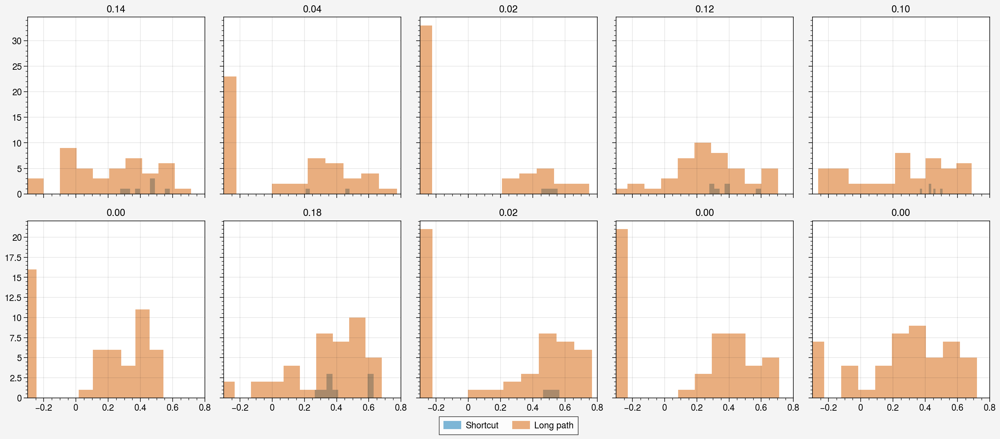

In [386]:

fig, ax = pplt.subplots(nrows=2, ncols=5)
title = []
for t in range(10):
    
    shortcut_res = activs[f'0.1_{t}']
    res = shortcut_res[-1]
    vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
    title.append(f'{np.sum(used) / 50:.2f}')

    start = 0
    end = 3

    activ_c_s = [] #closed where shortcut was used when open
    activ_c_l = [] #closed where long path was used when open
    activ_l = [] #long path
    activ_s = [] #shortcut

    # get ep activations from closed shortcut eps where when open agent used shortcut
    for i in range(50):
        v = vis[i]
        first = np.argmax(v)
        # print(avail[i])
        # print(avail[i+50])
        if used[i+50][0]:
            activ_c_s.append(activ[i][first+start:first+end])
            activ_s.append(activ[i+50][first+start:first+end])
        else:
            activ_c_l.append(activ[i][first+start:first+end])
            activ_l.append(activ[i+50][first+start:first+end])

    s_scores = []
    l_scores = []

    for i in range(len(activ_s)):
        s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
    for i in range(len(activ_l)):
        l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))

    ax[t].hist(s_scores, alpha=0.5, label='Shortcut')
    ax[t].hist(l_scores, alpha=0.5, label='Long path')

ax[7].legend(loc='b')
ax.format(title=title, xlim=[-0.3, 0.8])

ValueError: Found array with 0 sample(s) (shape=(0, 64)) while a minimum of 1 is required.

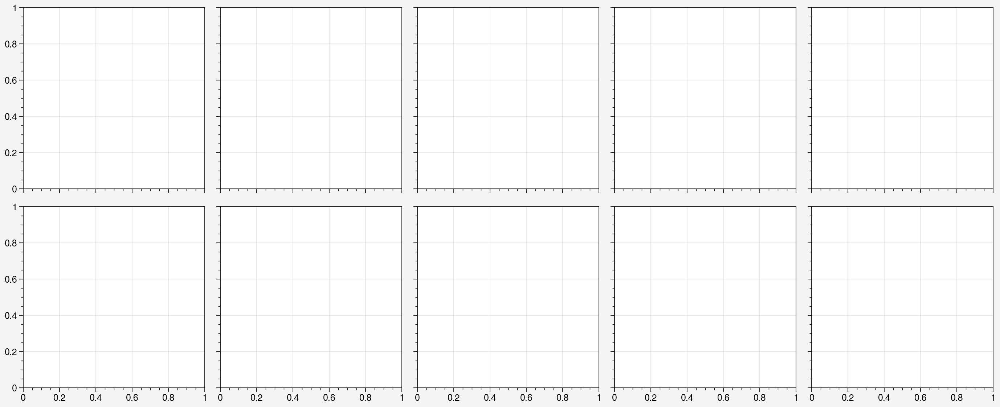

In [394]:

fig, ax = pplt.subplots(nrows=2, ncols=5)
title = []
for t in range(10):
    
    shortcut_res = activs[f'0.4_{t}']
    res = shortcut_res[-1]
    vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
    title.append(f'{np.sum(used) / 50:.2f}')

    start = -3
    end = 0

    activ_c_s = [] #closed where shortcut was used when open
    activ_c_l = [] #closed where long path was used when open
    activ_l = [] #long path
    activ_s = [] #shortcut

    # get ep activations from closed shortcut eps where when open agent used shortcut
    for i in range(50):
        v = vis[i]
        first = np.argmax(v)
        # print(avail[i])
        # print(avail[i+50])
        if used[i+50][0]:
            activ_c_s.append(activ[i][first+start:first+end])
            activ_s.append(activ[i+50][first+start:first+end])
        else:
            activ_c_l.append(activ[i][first+start:first+end])
            activ_l.append(activ[i+50][first+start:first+end])

    s_scores = []
    l_scores = []

    for i in range(len(activ_s)):
        s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
    for i in range(len(activ_l)):
        l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))

    ax[t].hist(s_scores, alpha=0.5, label='Shortcut')
    ax[t].hist(l_scores, alpha=0.5, label='Long path')

ax[7].legend(loc='b')
ax.format(title=title, xlim=[-0.3, 0.8])

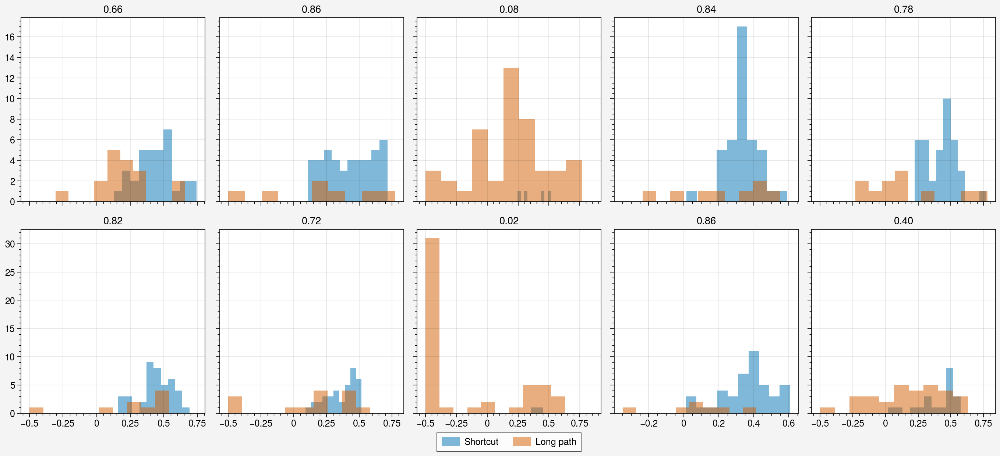

In [439]:
idx_s = []
idx_l = []
fig, ax = pplt.subplots(nrows=2, ncols=5)
title = []
for t in range(10):
    
    shortcut_res = activs[f'0.4_{t}']
    res = shortcut_res[-1]
    vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
    title.append(f'{np.sum(used) / 50:.2f}')

    start = 0
    end = 2

    activ_c_s = [] #closed where shortcut was used when open
    activ_c_l = [] #closed where long path was used when open
    activ_l = [] #long path
    activ_s = [] #shortcut

    # get ep activations from closed shortcut eps where when open agent used shortcut
    for i in range(50):
        v = vis[i]
        first = np.argmax(v)
        # print(avail[i])
        # print(avail[i+50])
        if first+end <= 1:
            continue
        
        f = max(0, first+start)
        if used[i+50][0]:
            activ_c_s.append(activ[i][f:first+end])
            activ_s.append(activ[i+50][f:first+end])
            idx_s.append(i)
        else:
            idx_l.append(i)
            activ_c_l.append(activ[i][f:first+end])
            activ_l.append(activ[i+50][f:first+end])

    s_scores = []
    l_scores = []

    for i in range(len(activ_s)):
        s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
    for i in range(len(activ_l)):
        l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))

    ax[t].hist(s_scores, alpha=0.5, label='Shortcut')
    ax[t].hist(l_scores, alpha=0.5, label='Long path')

ax[7].legend(loc='b')
ax.format(title=title,)
          # xlim=[-0.3, 0.8])

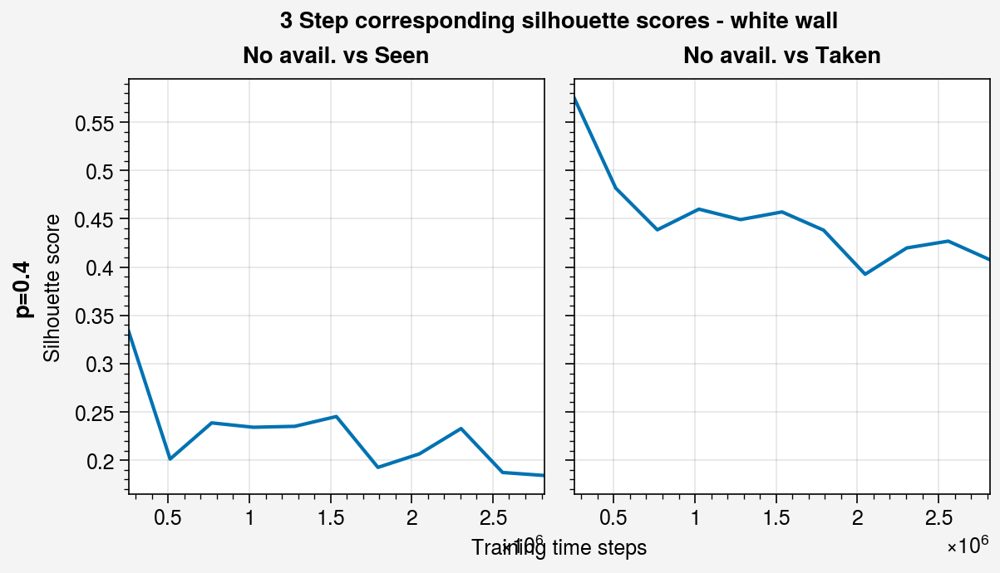

In [327]:
# only consider agents that used shortcut at least 5 times

# probs = [0.1, 0.4]
probs = [0.4]
trials = range(10)

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []}
}

start = 0
end = 3

for chk in range(len(chks)):
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used

    # for t in trials:
    for p, t in itertools.product(probs, trials):
        key = f'{p}_{t}'
        shortcut_res = activs[key]

        res = shortcut_res[chk]
        vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
        if np.sum(used) < 5:
            continue

        activ_c_s = [] #closed where shortcut was used when open
        activ_c_l = [] #closed where long path was used when open
        activ_l = [] #long path
        activ_s = [] #shortcut

        # get ep activations from closed shortcut eps where when open agent used shortcut
        for i in range(50):
            v = vis[i]
            first = np.argmax(v)
            if used[i+50][0]:
                activ_c_s.append(activ[i][first+start:first+end])
                activ_s.append(activ[i+50][first+start:first+end])
            else:
                activ_c_l.append(activ[i][first+start:first+end])
                activ_l.append(activ[i+50][first+start:first+end])

        s_scores = []
        l_scores = []

        # Note we might get a bug in the case of 100% shortcut use rate but no agent has had that yet
        #  - in that case, we can probably just not count the l_score there
        for i in range(len(activ_s)):
            s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
        for i in range(len(activ_l)):
            l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))
            
        
        none_vs_vis.append(np.mean(l_scores))
        none_vs_taken.append(np.mean(s_scores))
    
        
        # Uncomment the below to get individual episodes to plot scatter with
        # all_scores[p]['none_vs_vis'].append(np.mean(l_scores))
        # all_scores[p]['none_vs_taken'].append(np.mean(s_scores))
        # all_scores[p]['surs'].append(np.sum(used) / 50)

    all_scores[p]['none_vs_vis'].append(np.mean(none_vs_vis))
    all_scores[p]['none_vs_taken'].append(np.mean(none_vs_taken))
    
    

# fig, ax = pplt.subplots(nrows=3, ncols=2)
fig, ax = pplt.subplots(nrows=1, ncols=2)

keys = ['none_vs_vis', 'none_vs_taken']
toplabels = ['No avail. vs Seen', 'No avail. vs Taken']
for j, p in enumerate(probs):
    for i, key in enumerate(keys):
        # ax[i, j].boxplot(all_scores[p][key], showfliers=False)
        # ax[i, j].plot(starts, np.mean(all_scores[p][key], axis=0))
        # ax[i].plot(chks*64*100, all_scores[0.4][key])
        ax[j, i].plot(chks*64*100, all_scores[p][key])
    
        
ax.format(xlabel='Training time steps', ylabel='Silhouette score',
         toplabels=toplabels,
         suptitle='3 Step corresponding silhouette scores - white wall',
         leftlabels=[f'p={p}' for p in probs])
         # leftlabels=leftlabels,)
         # xlocator=range(15), xformatter=[str(n) for n in ns])

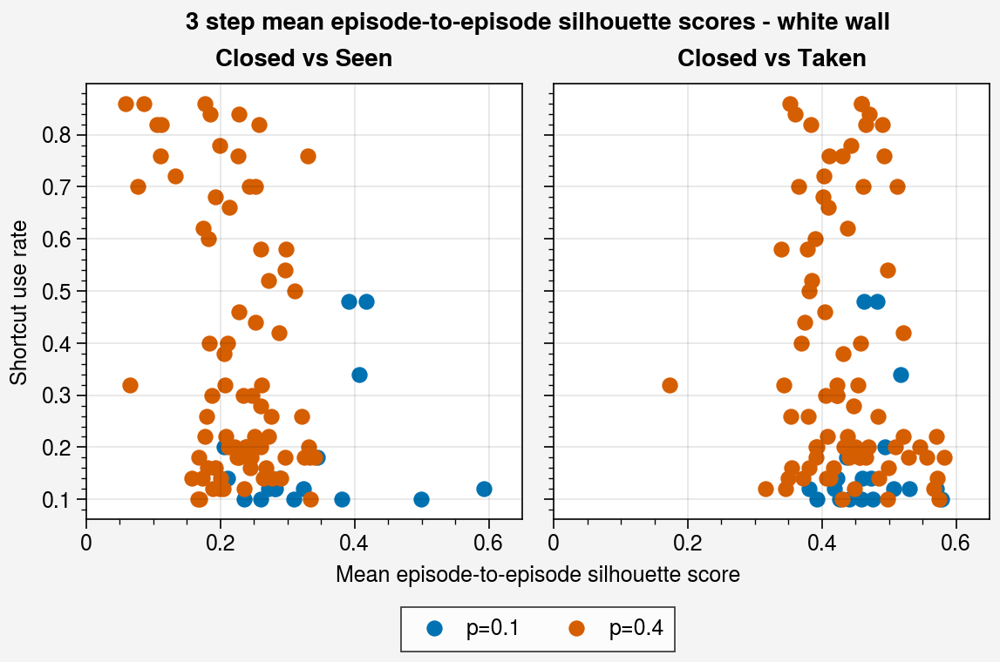

In [72]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []}
}

start = 0
end = 3

for chk in range(len(chks)):
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used

    # for t in trials:
    for p, t in itertools.product(probs, trials):
        key = f'{p}_{t}'
        shortcut_res = activs[key]

        res = shortcut_res[chk]
        vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
        if np.sum(used) < 5:
            continue

        activ_c_s = [] #closed where shortcut was used when open
        activ_c_l = [] #closed where long path was used when open
        activ_l = [] #long path
        activ_s = [] #shortcut

        # get ep activations from closed shortcut eps where when open agent used shortcut
        for i in range(50):
            v = vis[i]
            first = np.argmax(v)
            if used[i+50][0]:
                activ_c_s.append(activ[i][first+start:first+end])
                activ_s.append(activ[i+50][first+start:first+end])
            else:
                activ_c_l.append(activ[i][first+start:first+end])
                activ_l.append(activ[i+50][first+start:first+end])

        s_scores = []
        l_scores = []

        # Note we might get a bug in the case of 100% shortcut use rate but no agent has had that yet
        #  - in that case, we can probably just not count the l_score there
        for i in range(len(activ_s)):
            s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
        for i in range(len(activ_l)):
            l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))
            
        
        none_vs_vis.append(np.mean(l_scores))
        none_vs_taken.append(np.mean(s_scores))
    
        
        # Uncomment the below to get individual episodes to plot scatter with
        all_scores[p]['none_vs_vis'].append(np.mean(l_scores))
        all_scores[p]['none_vs_taken'].append(np.mean(s_scores))
        all_scores[p]['surs'].append(np.sum(used) / 50)
    
    

fig, ax = pplt.subplots(nrows=1, ncols=2)
legend_pts = []
for p in probs:
    keys = ['none_vs_vis', 'none_vs_taken']
    surs = all_scores[p]['surs']
    for i, key in enumerate(keys):
        scores = all_scores[p][key]
        pts = ax[i].scatter(scores, surs, label=f'p={p}')
        if i == 0:
            legend_pts.append(pts)

toplabels = ['Closed vs Seen', 'Closed vs Taken']
ax.format(xlabel='Mean episode-to-episode silhouette score', ylabel='Shortcut use rate',
         toplabels=toplabels,
         suptitle='3 step mean episode-to-episode silhouette scores - white wall',
         xlim=[0, 0.65])
fig.legend(legend_pts, loc='b')

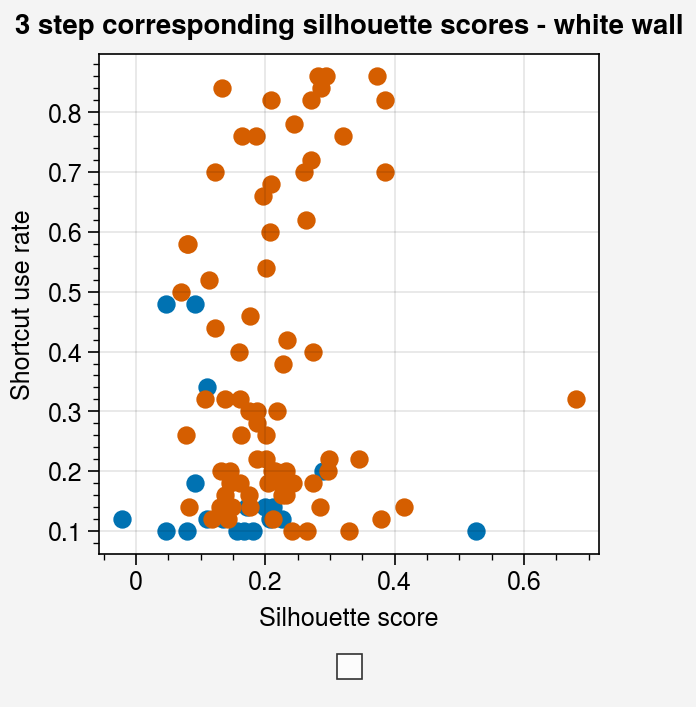

In [392]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []}
}

start = 0
end = 3

for chk in range(len(chks)):
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used

    # for t in trials:
    for p, t in itertools.product(probs, trials):
        key = f'{p}_{t}'
        shortcut_res = activs[key]

        res = shortcut_res[chk]
        vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
        if np.sum(used) < 5:
            continue

        activ_c_s = [] #closed where shortcut was used when open
        activ_c_l = [] #closed where long path was used when open
        activ_l = [] #long path
        activ_s = [] #shortcut

        # get ep activations from closed shortcut eps where when open agent used shortcut
        for i in range(50):
            v = vis[i]
            first = np.argmax(v)
            if used[i+50][0]:
                activ_c_s.append(activ[i][first+start:first+end])
                activ_s.append(activ[i+50][first+start:first+end])
            else:
                activ_c_l.append(activ[i][first+start:first+end])
                activ_l.append(activ[i+50][first+start:first+end])

        s_scores = []
        l_scores = []

        # Note we might get a bug in the case of 100% shortcut use rate but no agent has had that yet
        #  - in that case, we can probably just not count the l_score there
        for i in range(len(activ_s)):
            s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
        for i in range(len(activ_l)):
            l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))
            
        
        none_vs_vis.append(np.mean(l_scores))
        none_vs_taken.append(np.mean(s_scores))
    
        
        # Uncomment the below to get individual episodes to plot scatter with
        all_scores[p]['none_vs_vis'].append(np.mean(l_scores))
        all_scores[p]['none_vs_taken'].append(np.mean(s_scores))
        all_scores[p]['surs'].append(np.sum(used) / 50)
    
    

fig, ax = pplt.subplots(nrows=1, ncols=1)
legend_pts = []
for p in probs:
    keys = ['none_vs_vis', 'none_vs_taken']
    surs = all_scores[p]['surs']
    scores = np.array(all_scores[p]['none_vs_taken']) - np.array(all_scores[p]['none_vs_vis'])
    pts = ax.scatter(scores, surs, label=f'p={p}')

toplabels = ['No avail. vs Seen', 'No avail. vs Taken']
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         suptitle='3 step corresponding silhouette scores - white wall')
fig.legend(legend_pts, loc='b')

In [ ]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)


start = 0
end = 3
ns = [1, 3, 5, 7, 10, 13]
fig, ax = pplt.subplots(ncols=len(ns), nrows=2)
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken']
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         leftlabels=leftlabels,
         toplabels=[f'{n} steps' for n in ns],
         suptitle='N step corresponding silhouette scores - white wall')
fig.legend(legend_pts, loc='b')

for j, n in enumerate(ns):
    end = n
    all_scores = {
        0.1: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []},
        0.4: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []}
    }
    
    for chk in range(len(chks)):
        none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
        none_vs_taken = [] #no shortcut avail vs shortcut used
        vis_vs_taken = [] #shortcut avail but not used vs shortcut used

        # for t in trials:
        for p, t in itertools.product(probs, trials):
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue

            activ_c_s = [] #closed where shortcut was used when open
            activ_c_l = [] #closed where long path was used when open
            activ_l = [] #long path
            activ_s = [] #shortcut

            # get ep activations from closed shortcut eps where when open agent used shortcut
            for i in range(50):
                v = vis[i]
                first = np.argmax(v)
                if used[i+50][0]:
                    activ_c_s.append(activ[i][first+start:first+end])
                    activ_s.append(activ[i+50][first+start:first+end])
                else:
                    activ_c_l.append(activ[i][first+start:first+end])
                    activ_l.append(activ[i+50][first+start:first+end])

            s_scores = []
            l_scores = []

            # Note we might get a bug in the case of 100% shortcut use rate but no agent has had that yet
            #  - in that case, we can probably just not count the l_score there
            for m in range(len(activ_s)):
                if len(activ_s[m]) < 2: continue
                s_scores.append(two_set_silhouette_score(activ_s[m], activ_c_s[m]))
            for m in range(len(activ_l)):
                if len(activ_l[m]) < 2: continue
                l_scores.append(two_set_silhouette_score(activ_l[m], activ_c_l[m]))


            none_vs_vis.append(np.mean(l_scores))
            none_vs_taken.append(np.mean(s_scores))


            # Uncomment the below to get individual episodes to plot scatter with
            all_scores[p]['none_vs_vis'].append(np.mean(l_scores))
            all_scores[p]['none_vs_taken'].append(np.mean(s_scores))
            all_scores[p]['surs'].append(np.sum(used) / 50)



    legend_pts = []
    for p in probs:
        keys = ['none_vs_vis', 'none_vs_taken']
        surs = all_scores[p]['surs']
        for i, key in enumerate(keys):
            scores = all_scores[p][key]
            pts = ax[i, j].scatter(scores, surs, label=f'p={p}')
            if i == 0:
                legend_pts.append(pts)


In [ ]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)


start = 0
end = 3
ns = [1, 3, 5, 7, 10, 13]
fig, ax = pplt.subplots(ncols=len(ns), nrows=2)
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken']
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         leftlabels=leftlabels,
         toplabels=[f'{n} steps' for n in ns],
         suptitle='N step corresponding silhouette scores - white wall')
fig.legend(legend_pts, loc='b')

for j, n in enumerate(ns):
    start = n
    end = n+3
    all_scores = {
        0.1: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []},
        0.4: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []}
    }
    
    for chk in range(len(chks)):
        none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
        none_vs_taken = [] #no shortcut avail vs shortcut used
        vis_vs_taken = [] #shortcut avail but not used vs shortcut used

        # for t in trials:
        for p, t in itertools.product(probs, trials):
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue

            activ_c_s = [] #closed where shortcut was used when open
            activ_c_l = [] #closed where long path was used when open
            activ_l = [] #long path
            activ_s = [] #shortcut

            # get ep activations from closed shortcut eps where when open agent used shortcut
            for i in range(50):
                v = vis[i]
                first = np.argmax(v)
                if used[i+50][0]:
                    activ_c_s.append(activ[i][first+start:first+end])
                    activ_s.append(activ[i+50][first+start:first+end])
                else:
                    activ_c_l.append(activ[i][first+start:first+end])
                    activ_l.append(activ[i+50][first+start:first+end])

            s_scores = []
            l_scores = []

            # Note we might get a bug in the case of 100% shortcut use rate but no agent has had that yet
            #  - in that case, we can probably just not count the l_score there
            for m in range(len(activ_s)):
                if len(activ_s[m]) < 2: continue
                s_scores.append(two_set_silhouette_score(activ_s[m], activ_c_s[m]))
            for m in range(len(activ_l)):
                if len(activ_l[m]) < 2: continue
                l_scores.append(two_set_silhouette_score(activ_l[m], activ_c_l[m]))


            none_vs_vis.append(np.mean(l_scores))
            none_vs_taken.append(np.mean(s_scores))


            # Uncomment the below to get individual episodes to plot scatter with
            all_scores[p]['none_vs_vis'].append(np.mean(l_scores))
            all_scores[p]['none_vs_taken'].append(np.mean(s_scores))
            all_scores[p]['surs'].append(np.sum(used) / 50)



    legend_pts = []
    for p in probs:
        keys = ['none_vs_vis', 'none_vs_taken']
        surs = all_scores[p]['surs']
        for i, key in enumerate(keys):
            scores = all_scores[p][key]
            pts = ax[i, j].scatter(scores, surs, label=f'p={p}')
            if i == 0:
                legend_pts.append(pts)


## wc4

In [370]:
activs = pickle.load(open('data/shortcut/wc4_policy_moreagents/shared1_activ', 'rb'))

print('Shortcut usage out of 50 episodes with open shortcuts')
print('0.1:', [np.sum(activs[f'0.1_{t}'][-1]['shortcut_used']) for t in range(10)])
print('0.4:', [np.sum(activs[f'0.4_{t}'][-1]['shortcut_used']) for t in range(10)])

Shortcut usage out of 50 episodes with open shortcuts
0.1: [0, 32, 0, 0, 32, 31, 0, 36, 0, 34]
0.4: [45, 43, 45, 43, 45, 44, 46, 45, 45, 0]


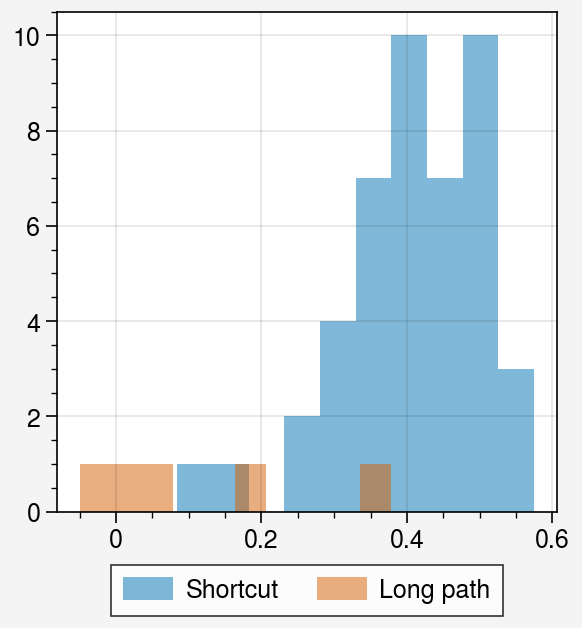

In [373]:
fig, ax = pplt.subplots()
ax.hist(s_scores, alpha=0.5, label='Shortcut')
ax.hist(l_scores, alpha=0.5, label='Long path')
ax.legend(loc='b')

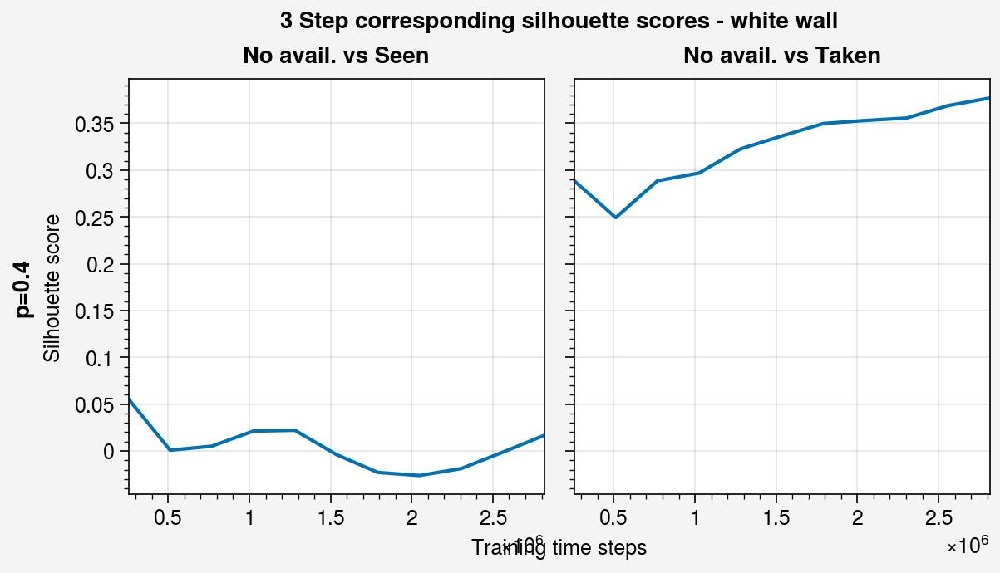

In [374]:
# only consider agents that used shortcut at least 5 times

# probs = [0.1, 0.4]
probs = [0.4]
trials = range(10)

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []}
}

start = 0
end = 3

for chk in range(len(chks)):
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used

    # for t in trials:
    for p, t in itertools.product(probs, trials):
        key = f'{p}_{t}'
        shortcut_res = activs[key]

        res = shortcut_res[chk]
        vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
        if np.sum(used) < 5:
            continue

        activ_c_s = [] #closed where shortcut was used when open
        activ_c_l = [] #closed where long path was used when open
        activ_l = [] #long path
        activ_s = [] #shortcut

        # get ep activations from closed shortcut eps where when open agent used shortcut
        for i in range(50):
            v = vis[i]
            first = np.argmax(v)
            if used[i+50][0]:
                activ_c_s.append(activ[i][first+start:first+end])
                activ_s.append(activ[i+50][first+start:first+end])
            else:
                activ_c_l.append(activ[i][first+start:first+end])
                activ_l.append(activ[i+50][first+start:first+end])

        s_scores = []
        l_scores = []

        # Note we might get a bug in the case of 100% shortcut use rate but no agent has had that yet
        #  - in that case, we can probably just not count the l_score there
        for i in range(len(activ_s)):
            s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
        for i in range(len(activ_l)):
            l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))
            
        
        none_vs_vis.append(np.mean(l_scores))
        none_vs_taken.append(np.mean(s_scores))
    
        
        # Uncomment the below to get individual episodes to plot scatter with
        # all_scores[p]['none_vs_vis'].append(np.mean(l_scores))
        # all_scores[p]['none_vs_taken'].append(np.mean(s_scores))
        # all_scores[p]['surs'].append(np.sum(used) / 50)

    all_scores[p]['none_vs_vis'].append(np.mean(none_vs_vis))
    all_scores[p]['none_vs_taken'].append(np.mean(none_vs_taken))
    
    

# fig, ax = pplt.subplots(nrows=3, ncols=2)
fig, ax = pplt.subplots(nrows=1, ncols=2)

keys = ['none_vs_vis', 'none_vs_taken']
toplabels = ['No avail. vs Seen', 'No avail. vs Taken']
for j, p in enumerate(probs):
    for i, key in enumerate(keys):
        # ax[i, j].boxplot(all_scores[p][key], showfliers=False)
        # ax[i, j].plot(starts, np.mean(all_scores[p][key], axis=0))
        # ax[i].plot(chks*64*100, all_scores[0.4][key])
        ax[j, i].plot(chks*64*100, all_scores[p][key])
    
        
ax.format(xlabel='Training time steps', ylabel='Silhouette score',
         toplabels=toplabels,
         suptitle='3 Step corresponding silhouette scores - white wall',
         leftlabels=[f'p={p}' for p in probs])
         # leftlabels=leftlabels,)
         # xlocator=range(15), xformatter=[str(n) for n in ns])

In [ ]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []}
}

start = 0
end = 3

for chk in range(len(chks)):
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used

    # for t in trials:
    for p, t in itertools.product(probs, trials):
        key = f'{p}_{t}'
        shortcut_res = activs[key]

        res = shortcut_res[chk]
        vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
        if np.sum(used) < 5:
            continue

        activ_c_s = [] #closed where shortcut was used when open
        activ_c_l = [] #closed where long path was used when open
        activ_l = [] #long path
        activ_s = [] #shortcut

        # get ep activations from closed shortcut eps where when open agent used shortcut
        for i in range(50):
            v = vis[i]
            first = np.argmax(v)
            if used[i+50][0]:
                activ_c_s.append(activ[i][first+start:first+end])
                activ_s.append(activ[i+50][first+start:first+end])
            else:
                activ_c_l.append(activ[i][first+start:first+end])
                activ_l.append(activ[i+50][first+start:first+end])

        s_scores = []
        l_scores = []

        # Note we might get a bug in the case of 100% shortcut use rate but no agent has had that yet
        #  - in that case, we can probably just not count the l_score there
        for i in range(len(activ_s)):
            s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
        for i in range(len(activ_l)):
            l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))
            
        
        none_vs_vis.append(np.mean(l_scores))
        none_vs_taken.append(np.mean(s_scores))
    
        
        # Uncomment the below to get individual episodes to plot scatter with
        all_scores[p]['none_vs_vis'].append(np.mean(l_scores))
        all_scores[p]['none_vs_taken'].append(np.mean(s_scores))
        all_scores[p]['surs'].append(np.sum(used) / 50)
    
    

fig, ax = pplt.subplots(nrows=1, ncols=2)
legend_pts = []
for p in probs:
    keys = ['none_vs_vis', 'none_vs_taken']
    surs = all_scores[p]['surs']
    for i, key in enumerate(keys):
        scores = all_scores[p][key]
        pts = ax[i].scatter(scores, surs, label=f'p={p}')
        if i == 0:
            legend_pts.append(pts)

toplabels = ['No avail. vs Seen', 'No avail. vs Taken']
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=toplabels,
         suptitle='3 step corresponding silhouette scores - white wall')
fig.legend(legend_pts, loc='b')

In [ ]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)


start = 0
end = 3
ns = [1, 3, 5, 7, 10, 13]
fig, ax = pplt.subplots(ncols=len(ns), nrows=2)
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken']
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         leftlabels=leftlabels,
         toplabels=[f'{n} steps' for n in ns],
         suptitle='N step corresponding silhouette scores - white wall')
fig.legend(legend_pts, loc='b')

for j, n in enumerate(ns):
    end = n
    all_scores = {
        0.1: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []},
        0.4: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []}
    }
    
    for chk in range(len(chks)):
        none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
        none_vs_taken = [] #no shortcut avail vs shortcut used
        vis_vs_taken = [] #shortcut avail but not used vs shortcut used

        # for t in trials:
        for p, t in itertools.product(probs, trials):
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 5:
                continue

            activ_c_s = [] #closed where shortcut was used when open
            activ_c_l = [] #closed where long path was used when open
            activ_l = [] #long path
            activ_s = [] #shortcut

            # get ep activations from closed shortcut eps where when open agent used shortcut
            for i in range(50):
                v = vis[i]
                first = np.argmax(v)
                if used[i+50][0]:
                    activ_c_s.append(activ[i][first+start:first+end])
                    activ_s.append(activ[i+50][first+start:first+end])
                else:
                    activ_c_l.append(activ[i][first+start:first+end])
                    activ_l.append(activ[i+50][first+start:first+end])

            s_scores = []
            l_scores = []

            # Note we might get a bug in the case of 100% shortcut use rate but no agent has had that yet
            #  - in that case, we can probably just not count the l_score there
            for m in range(len(activ_s)):
                if len(activ_s[m]) < 2: continue
                s_scores.append(two_set_silhouette_score(activ_s[m], activ_c_s[m]))
            for m in range(len(activ_l)):
                if len(activ_l[m]) < 2: continue
                l_scores.append(two_set_silhouette_score(activ_l[m], activ_c_l[m]))


            none_vs_vis.append(np.mean(l_scores))
            none_vs_taken.append(np.mean(s_scores))


            # Uncomment the below to get individual episodes to plot scatter with
            all_scores[p]['none_vs_vis'].append(np.mean(l_scores))
            all_scores[p]['none_vs_taken'].append(np.mean(s_scores))
            all_scores[p]['surs'].append(np.sum(used) / 50)



    legend_pts = []
    for p in probs:
        keys = ['none_vs_vis', 'none_vs_taken']
        surs = all_scores[p]['surs']
        for i, key in enumerate(keys):
            scores = all_scores[p][key]
            pts = ax[i, j].scatter(scores, surs, label=f'p={p}')
            if i == 0:
                legend_pts.append(pts)


# N step silhouette scores where shortcut is not actively in view

Consider N steps after but only look at population activity where the shortcut is not currently in view.

## wc1.5

In [ ]:
activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

print('Shortcut usage out of 50 episodes with open shortcuts')
print('0.1:', [np.sum(activs[f'0.1_{t}'][-1]['shortcut_used']) for t in range(10)])
print('0.4:', [np.sum(activs[f'0.4_{t}'][-1]['shortcut_used']) for t in range(10)])

In [ ]:
# Only compare steps where the shortcut is not in view
fig, ax = pplt.subplots(nrows=2, ncols=5)
title = []
for t in range(10):
    
    shortcut_res = activs[f'0.1_{t}']
    res = shortcut_res[-1]
    vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
    title.append(f'{np.sum(used) / 50:.2f}')

    start = 0
    end = 10

    activ_c_s = [] #closed where shortcut was used when open
    activ_c_l = [] #closed where long path was used when open
    activ_l = [] #long path
    activ_s = [] #shortcut

    # get ep activations from closed shortcut eps where when open agent used shortcut
    for i in range(50):
        v_c = np.array(vis[i])
        v = np.array(vis[i+50])
        first = np.argmax(v)
        
        # selectors for where shortcut is NOT in view between first+start and first+end
        v_c_idxs = np.full(v_c.shape, False)
        v_idxs = np.full(v.shape, False)
        
        v_c_idxs[first+start:first+end] = ~v_c[first+start:first+end]
        v_idxs[first+start:first+end] = ~v[first+start:first+end]
        if np.sum(v_c_idxs) < 2 or np.sum(v_idxs) < 2:
            continue
        
        if used[i+50][0]:
            activ_c_s.append(activ[i][v_c_idxs])
            activ_s.append(activ[i+50][v_idxs])
        else:
            activ_c_l.append(activ[i][v_c_idxs])
            activ_l.append(activ[i+50][v_idxs])

    s_scores = []
    l_scores = []

    for i in range(len(activ_s)):
        s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
    for i in range(len(activ_l)):
        l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))

    ax[t].hist(s_scores, alpha=0.5, label='Shortcut')
    ax[t].hist(l_scores, alpha=0.5, label='Long path')

ax[7].legend(loc='b')
ax.format(title=title, xlim=[-0.3, 0.8])

In [ ]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []}
}

start = 0
end = 5

for chk in range(len(chks)):
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used

    # for t in trials:
    for p, t in itertools.product(probs, trials):
        key = f'{p}_{t}'
        shortcut_res = activs[key]

        res = shortcut_res[chk]
        vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
        if np.sum(used) < 1 or np.sum(used) > 49:
            continue

        activ_c_s = [] #closed where shortcut was used when open
        activ_c_l = [] #closed where long path was used when open
        activ_l = [] #long path
        activ_s = [] #shortcut

        # get ep activations from closed shortcut eps where when open agent used shortcut
        for i in range(50):
            v_c = np.array(vis[i])
            v = np.array(vis[i+50])
            first = np.argmax(v)

            # selectors for where shortcut is NOT in view between first+start and first+end
            v_c_idxs = np.full(v_c.shape, False)
            v_idxs = np.full(v.shape, False)

            v_c_idxs[first+start:first+end] = ~v_c[first+start:first+end]
            v_idxs[first+start:first+end] = ~v[first+start:first+end]
            if np.sum(v_c_idxs) < 2 or np.sum(v_idxs) < 2:
                continue

            if used[i+50][0]:
                activ_c_s.append(activ[i][v_c_idxs])
                activ_s.append(activ[i+50][v_idxs])
            else:
                activ_c_l.append(activ[i][v_c_idxs])
                activ_l.append(activ[i+50][v_idxs])

        s_scores = []
        l_scores = []

        # Note we might get a bug in the case of 100% shortcut use rate but no agent has had that yet
        #  - in that case, we can probably just not count the l_score there
        for i in range(len(activ_s)):
            s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
        for i in range(len(activ_l)):
            l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))
            
        if len(l_scores) < 1 or len(s_scores) < 1:
            continue
        
        none_vs_vis.append(np.mean(l_scores))
        none_vs_taken.append(np.mean(s_scores))
    
        # Uncomment the below to get individual episodes to plot scatter with
        all_scores[p]['none_vs_vis'].append(np.mean(l_scores))
        all_scores[p]['none_vs_taken'].append(np.mean(s_scores))
        all_scores[p]['surs'].append(np.sum(used) / 50)
    
    

fig, ax = pplt.subplots(nrows=1, ncols=2)
legend_pts = []
for p in probs:
    keys = ['none_vs_vis', 'none_vs_taken']
    surs = all_scores[p]['surs']
    for i, key in enumerate(keys):
        scores = all_scores[p][key]
        pts = ax[i].scatter(scores, surs, label=f'p={p}')
        if i == 0:
            legend_pts.append(pts)

toplabels = ['No avail. vs Seen', 'No avail. vs Taken']
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=toplabels,
         suptitle='3 step corresponding silhouette scores - white wall')
fig.legend(legend_pts, loc='b')

In [ ]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)


start = 0
end = 3
ns = [1, 3, 5, 7, 10, 13]
fig, ax = pplt.subplots(ncols=len(ns), nrows=2)
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken']
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         leftlabels=leftlabels,
         toplabels=[f'{n} steps' for n in ns],
         suptitle='N step corresponding silhouette scores - white wall')
fig.legend(legend_pts, loc='b')

for j, n in enumerate(ns):
    end = n
    all_scores = {
        0.1: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []},
        0.4: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []}
    }

    for chk in range(len(chks)):
        none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
        none_vs_taken = [] #no shortcut avail vs shortcut used
        vis_vs_taken = [] #shortcut avail but not used vs shortcut used

        # for t in trials:
        for p, t in itertools.product(probs, trials):
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 1 or np.sum(used) > 49:
                continue

            activ_c_s = [] #closed where shortcut was used when open
            activ_c_l = [] #closed where long path was used when open
            activ_l = [] #long path
            activ_s = [] #shortcut

            # get ep activations from closed shortcut eps where when open agent used shortcut
            for i in range(50):
                v_c = np.array(vis[i])
                v = np.array(vis[i+50])
                first = np.argmax(v)

                # selectors for where shortcut is NOT in view between first+start and first+end
                v_c_idxs = np.full(v_c.shape, False)
                v_idxs = np.full(v.shape, False)

                v_c_idxs[first+start:first+end] = ~v_c[first+start:first+end]
                v_idxs[first+start:first+end] = ~v[first+start:first+end]
                if np.sum(v_c_idxs) < 2 or np.sum(v_idxs) < 2:
                    continue

                if used[i+50][0]:
                    activ_c_s.append(activ[i][v_c_idxs])
                    activ_s.append(activ[i+50][v_idxs])
                else:
                    activ_c_l.append(activ[i][v_c_idxs])
                    activ_l.append(activ[i+50][v_idxs])

            s_scores = []
            l_scores = []

            # Note we might get a bug in the case of 100% shortcut use rate but no agent has had that yet
            #  - in that case, we can probably just not count the l_score there
            for i in range(len(activ_s)):
                s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
            for i in range(len(activ_l)):
                l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))

            if len(l_scores) < 1 or len(s_scores) < 1:
                continue

            none_vs_vis.append(np.mean(l_scores))
            none_vs_taken.append(np.mean(s_scores))

            # Uncomment the below to get individual episodes to plot scatter with
            all_scores[p]['none_vs_vis'].append(np.mean(l_scores))
            all_scores[p]['none_vs_taken'].append(np.mean(s_scores))
            all_scores[p]['surs'].append(np.sum(used) / 50)



    legend_pts = []
    for p in probs:
        keys = ['none_vs_vis', 'none_vs_taken']
        surs = all_scores[p]['surs']
        for i, key in enumerate(keys):
            scores = all_scores[p][key]
            pts = ax[i, j].scatter(scores, surs, label=f'p={p}')
            if i == 0:
                legend_pts.append(pts)



## wc4

In [ ]:
activs = pickle.load(open('data/shortcut/wc4_policy_moreagents/shared1_activ', 'rb'))

print('Shortcut usage out of 50 episodes with open shortcuts')
print('0.1:', [np.sum(activs[f'0.1_{t}'][-1]['shortcut_used']) for t in range(10)])
print('0.4:', [np.sum(activs[f'0.4_{t}'][-1]['shortcut_used']) for t in range(10)])

In [ ]:
# Only compare steps where the shortcut is not in view
fig, ax = pplt.subplots(nrows=2, ncols=5)
title = []
for t in range(10):
    
    shortcut_res = activs[f'0.1_{t}']
    res = shortcut_res[-1]
    vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
    title.append(f'{np.sum(used) / 50:.2f}')

    start = 0
    end = 10

    activ_c_s = [] #closed where shortcut was used when open
    activ_c_l = [] #closed where long path was used when open
    activ_l = [] #long path
    activ_s = [] #shortcut

    # get ep activations from closed shortcut eps where when open agent used shortcut
    for i in range(50):
        v_c = np.array(vis[i])
        v = np.array(vis[i+50])
        first = np.argmax(v)
        
        # selectors for where shortcut is NOT in view between first+start and first+end
        v_c_idxs = np.full(v_c.shape, False)
        v_idxs = np.full(v.shape, False)
        
        v_c_idxs[first+start:first+end] = ~v_c[first+start:first+end]
        v_idxs[first+start:first+end] = ~v[first+start:first+end]
        if np.sum(v_c_idxs) < 2 or np.sum(v_idxs) < 2:
            continue
        
        if used[i+50][0]:
            activ_c_s.append(activ[i][v_c_idxs])
            activ_s.append(activ[i+50][v_idxs])
        else:
            activ_c_l.append(activ[i][v_c_idxs])
            activ_l.append(activ[i+50][v_idxs])

    s_scores = []
    l_scores = []

    for i in range(len(activ_s)):
        s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
    for i in range(len(activ_l)):
        l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))

    ax[t].hist(s_scores, alpha=0.5, label='Shortcut')
    ax[t].hist(l_scores, alpha=0.5, label='Long path')

ax[7].legend(loc='b')
ax.format(title=title, xlim=[-0.3, 0.8])

In [ ]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)

all_scores = {
    0.1: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []},
    0.4: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []}
}

start = 0
end = 5

for chk in range(len(chks)):
    none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
    none_vs_taken = [] #no shortcut avail vs shortcut used
    vis_vs_taken = [] #shortcut avail but not used vs shortcut used

    # for t in trials:
    for p, t in itertools.product(probs, trials):
        key = f'{p}_{t}'
        shortcut_res = activs[key]

        res = shortcut_res[chk]
        vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
        if np.sum(used) < 1 or np.sum(used) > 49:
            continue

        activ_c_s = [] #closed where shortcut was used when open
        activ_c_l = [] #closed where long path was used when open
        activ_l = [] #long path
        activ_s = [] #shortcut

        # get ep activations from closed shortcut eps where when open agent used shortcut
        for i in range(50):
            v_c = np.array(vis[i])
            v = np.array(vis[i+50])
            first = np.argmax(v)

            # selectors for where shortcut is NOT in view between first+start and first+end
            v_c_idxs = np.full(v_c.shape, False)
            v_idxs = np.full(v.shape, False)

            v_c_idxs[first+start:first+end] = ~v_c[first+start:first+end]
            v_idxs[first+start:first+end] = ~v[first+start:first+end]
            if np.sum(v_c_idxs) < 2 or np.sum(v_idxs) < 2:
                continue

            if used[i+50][0]:
                activ_c_s.append(activ[i][v_c_idxs])
                activ_s.append(activ[i+50][v_idxs])
            else:
                activ_c_l.append(activ[i][v_c_idxs])
                activ_l.append(activ[i+50][v_idxs])

        s_scores = []
        l_scores = []

        # Note we might get a bug in the case of 100% shortcut use rate but no agent has had that yet
        #  - in that case, we can probably just not count the l_score there
        for i in range(len(activ_s)):
            s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
        for i in range(len(activ_l)):
            l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))
            
        if len(l_scores) < 1 or len(s_scores) < 1:
            continue
        
        none_vs_vis.append(np.mean(l_scores))
        none_vs_taken.append(np.mean(s_scores))
    
        # Uncomment the below to get individual episodes to plot scatter with
        all_scores[p]['none_vs_vis'].append(np.mean(l_scores))
        all_scores[p]['none_vs_taken'].append(np.mean(s_scores))
        all_scores[p]['surs'].append(np.sum(used) / 50)
    
    

fig, ax = pplt.subplots(nrows=1, ncols=2)
legend_pts = []
for p in probs:
    keys = ['none_vs_vis', 'none_vs_taken']
    surs = all_scores[p]['surs']
    for i, key in enumerate(keys):
        scores = all_scores[p][key]
        pts = ax[i].scatter(scores, surs, label=f'p={p}')
        if i == 0:
            legend_pts.append(pts)

toplabels = ['No avail. vs Seen', 'No avail. vs Taken']
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         toplabels=toplabels,
         suptitle='3 step corresponding silhouette scores - white wall')
fig.legend(legend_pts, loc='b')

In [ ]:
# only consider agents that used shortcut at least 5 times

probs = [0.1, 0.4]
# probs = [0.4]
trials = range(10)


start = 0
end = 3
ns = [1, 3, 5, 7, 10, 13]
fig, ax = pplt.subplots(ncols=len(ns), nrows=2)
leftlabels = ['No avail. vs Seen', 'No avail. vs Taken']
ax.format(xlabel='Silhouette score', ylabel='Shortcut use rate',
         leftlabels=leftlabels,
         toplabels=[f'{n} steps' for n in ns],
         suptitle='N step corresponding silhouette scores - white wall')
fig.legend(legend_pts, loc='b')

for j, n in enumerate(ns):
    end = n
    all_scores = {
        0.1: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []},
        0.4: {'none_vs_vis': [], 'none_vs_taken': [], 'surs': []}
    }

    for chk in range(len(chks)):
        none_vs_vis = [] #no shortcut avail vs shortcut avail but not used
        none_vs_taken = [] #no shortcut avail vs shortcut used
        vis_vs_taken = [] #shortcut avail but not used vs shortcut used

        # for t in trials:
        for p, t in itertools.product(probs, trials):
            key = f'{p}_{t}'
            shortcut_res = activs[key]

            res = shortcut_res[chk]
            vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
            if np.sum(used) < 1 or np.sum(used) > 49:
                continue

            activ_c_s = [] #closed where shortcut was used when open
            activ_c_l = [] #closed where long path was used when open
            activ_l = [] #long path
            activ_s = [] #shortcut

            # get ep activations from closed shortcut eps where when open agent used shortcut
            for i in range(50):
                v_c = np.array(vis[i])
                v = np.array(vis[i+50])
                first = np.argmax(v)

                # selectors for where shortcut is NOT in view between first+start and first+end
                v_c_idxs = np.full(v_c.shape, False)
                v_idxs = np.full(v.shape, False)

                v_c_idxs[first+start:first+end] = ~v_c[first+start:first+end]
                v_idxs[first+start:first+end] = ~v[first+start:first+end]
                if np.sum(v_c_idxs) < 2 or np.sum(v_idxs) < 2:
                    continue

                if used[i+50][0]:
                    activ_c_s.append(activ[i][v_c_idxs])
                    activ_s.append(activ[i+50][v_idxs])
                else:
                    activ_c_l.append(activ[i][v_c_idxs])
                    activ_l.append(activ[i+50][v_idxs])

            s_scores = []
            l_scores = []

            # Note we might get a bug in the case of 100% shortcut use rate but no agent has had that yet
            #  - in that case, we can probably just not count the l_score there
            for i in range(len(activ_s)):
                s_scores.append(two_set_silhouette_score(activ_s[i], activ_c_s[i]))
            for i in range(len(activ_l)):
                l_scores.append(two_set_silhouette_score(activ_l[i], activ_c_l[i]))

            if len(l_scores) < 1 or len(s_scores) < 1:
                continue

            none_vs_vis.append(np.mean(l_scores))
            none_vs_taken.append(np.mean(s_scores))

            # Uncomment the below to get individual episodes to plot scatter with
            all_scores[p]['none_vs_vis'].append(np.mean(l_scores))
            all_scores[p]['none_vs_taken'].append(np.mean(s_scores))
            all_scores[p]['surs'].append(np.sum(used) / 50)



    legend_pts = []
    for p in probs:
        keys = ['none_vs_vis', 'none_vs_taken']
        surs = all_scores[p]['surs']
        for i, key in enumerate(keys):
            scores = all_scores[p][key]
            pts = ax[i, j].scatter(scores, surs, label=f'p={p}')
            if i == 0:
                legend_pts.append(pts)



# Prevision influencing shortcut decision making

In [ ]:
activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))


In [ ]:
key = '0.4_0'
shortcut_res = activs[key]
res = shortcut_res[-1]
vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], res['activ']
print(np.sum(used))

color = vision_decision_coloring(vis, avail, used, start=-3, end=0)
color2 = vision_decision_coloring(vis, avail, used, start=-1, end=0)

activ = np.vstack(activ)

pca = PCA()
a_pca = pca.fit_transform(activ[color != -1])
a_pca1 = pca.transform(activ[color == 1])
a_pca2 = pca.transform(activ[color == 2])

a_pca1b = pca.transform(activ[color2 == 1])
a_pca2b = pca.transform(activ[color2 == 2])

umap = UMAP(n_components=6, min_dist=0.35)
a_umap = umap.fit_transform(activ[color != -1])
a_umap1 = umap.transform(activ[color == 1])
a_umap2 = umap.transform(activ[color == 2])

a_umap1b = umap.transform(activ[color2 == 1])
a_umap2b = umap.transform(activ[color2 == 2])

In [ ]:
fig, ax = pplt.subplots(refaspect=3, figwidth=14)
ax.violin(np.arange(10)*2, a_pca[:, :10], fc=rgb_colors[0])
# ax.violin(np.arange(10)*2+0.3, a_pca1[:, :10], fc=rgb_colors[1])
# ax.violin(np.arange(10)*2+0.6, a_pca2[:, :10], fc=rgb_colors[2])

ax.violin(np.arange(10)*2+0.3, a_pca1b[:, :10], fc=rgb_colors[1])
ax.violin(np.arange(10)*2+0.6, a_pca2b[:, :10], fc=rgb_colors[2])

In [ ]:
fig, ax = pplt.subplots(ncols=5)
for i in range(5):
    ax[i].scatter(a_pca1[:, i*2], a_pca1[:, i*2+1], alpha=0.3)
    ax[i].scatter(a_pca2[:, i*2], a_pca2[:, i*2+1], alpha=0.3)
    
    
    ax[i].scatter(a_pca1b[:, i*2], a_pca1b[:, i*2+1], alpha=1)
    ax[i].scatter(a_pca2b[:, i*2], a_pca2b[:, i*2+1], alpha=1)

In [ ]:
umap = UMAP(n_components=6, min_dist=0.35)
a_umap = umap.fit_transform(activ[color != -1])
a_umap1 = umap.transform(activ[color == 1])
a_umap2 = umap.transform(activ[color == 2])

a_umap1b = umap.transform(activ[color2 == 1])
a_umap2b = umap.transform(activ[color2 == 2])

In [ ]:
fig, ax = pplt.subplots(ncols=3)
for i in range(3):
    ax[i].scatter(a_umap1[:, i*2], a_umap1[:, i*2+1], alpha=0.3)
    ax[i].scatter(a_umap2[:, i*2], a_umap2[:, i*2+1], alpha=0.3)
    
    
    ax[i].scatter(a_umap1b[:, i*2], a_umap1b[:, i*2+1], alpha=1)
    ax[i].scatter(a_umap2b[:, i*2], a_umap2b[:, i*2+1], alpha=1)

In [ ]:
fig, ax = pplt.subplots(refaspect=3, figwidth=14)
ax.violin(np.arange(6)*2, a_umap[:, :6], fc=rgb_colors[0])
# ax.violin(np.arange(6)*2+0.3, a_umap1[:, :6], fc=rgb_colors[1])
# ax.violin(np.arange(6)*2+0.6, a_umap2[:, :6], fc=rgb_colors[2])

ax.violin(np.arange(6)*2+0.3, a_umap1b[:, :6], fc=rgb_colors[1])
ax.violin(np.arange(6)*2+0.6, a_umap2b[:, :6], fc=rgb_colors[2])

## Trying with more episodes

It looks like it might be quite difficult to find any population axes that activations separate along to detect decision

In [ ]:
key = f'0.4_0'
p = 0.4
t = 0
chk = 440
model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', subdir='shortcut_wc2', trial=t, chk=chk)

res = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
               env_kwargs={'character_reset_pos': 3,
                          'shortcut_probability': 1,
                          'wall_colors': 1.5},
           seed=1, with_activations=True, data_callback=shortcut_visdata_callback,
               num_episodes=300)

'''Collect up to first+nth step of seeing shortcut
where first is the first step seeing the shortcut'''
activs = ep_stack_activations(res, half=True)

res = {
    'activs': activs,
    'actions': actions,
    'ep_pos': res['data']['pos'],
    'ep_angle': res['data']['angle'],
    'vis': res['data']['shortcut_vis'],
    'shortcut_avail': res['data']['shortcut'],
    'shortcut_used': [[check_shortcut_usage(p) for p in res['data']['pos']]]
}
print(np.sum(res['shortcut_used']))

In [ ]:
activ = [a['shared_activations'][1] for a in res['activs']]
vis, avail, used, activ = res['vis'], res['shortcut_avail'], res['shortcut_used'], activ
print(np.sum(used))

color = vision_decision_coloring(vis, avail, used, start=-3, end=0)
color2 = vision_decision_coloring(vis, avail, used, start=-1, end=0)

activ = np.vstack(activ)

pca = PCA()
a_pca = pca.fit_transform(activ[color != -1])
a_pca1 = pca.transform(activ[color == 1])
a_pca2 = pca.transform(activ[color == 2])

a_pca1b = pca.transform(activ[color2 == 1])
a_pca2b = pca.transform(activ[color2 == 2])

umap = UMAP(n_components=6, min_dist=0.35)
a_umap = umap.fit_transform(activ[color != -1])
a_umap1 = umap.transform(activ[color == 1])
a_umap2 = umap.transform(activ[color == 2])

a_umap1b = umap.transform(activ[color2 == 1])
a_umap2b = umap.transform(activ[color2 == 2])

In [ ]:
fig, ax = pplt.subplots(refaspect=3, figwidth=14)
ax.violin(np.arange(6)*2, a_umap[:, :6], fc=rgb_colors[0])
# ax.violin(np.arange(6)*2+0.3, a_umap1[:, :6], fc=rgb_colors[1])
# ax.violin(np.arange(6)*2+0.6, a_umap2[:, :6], fc=rgb_colors[2])

ax.violin(np.arange(6)*2+0.3, a_umap1b[:, :6], fc=rgb_colors[1])
ax.violin(np.arange(6)*2+0.6, a_umap2b[:, :6], fc=rgb_colors[2])

In [ ]:
fig, ax = pplt.subplots(ncols=3)
for i in range(3):
    # ax[i].scatter(a_umap1[:, i*2], a_umap1[:, i*2+1], alpha=0.3)
    # ax[i].scatter(a_umap2[:, i*2], a_umap2[:, i*2+1], alpha=0.3)
    
    
    ax[i].scatter(a_umap1b[:, i*2], a_umap1b[:, i*2+1], alpha=0.3)
    ax[i].scatter(a_umap2b[:, i*2], a_umap2b[:, i*2+1], alpha=0.3)

In [ ]:
fig, ax = pplt.subplots(ncols=5)
for i in range(5):
    # ax[i].scatter(a_pca1[:, i*2], a_pca1[:, i*2+1], alpha=0.3)
    # ax[i].scatter(a_pca2[:, i*2], a_pca2[:, i*2+1], alpha=0.3)
    
    
    ax[i].scatter(a_pca1b[:, i*2], a_pca1b[:, i*2+1], alpha=0.3)
    ax[i].scatter(a_pca2b[:, i*2], a_pca2b[:, i*2+1], alpha=0.3)

## First N step silhouette scores and action probabilities - 0.4_0, wc1.5

Looking for whether first N steps show separation of activation between episodes with long path vs. shortcut on very similar starts (take a start and use ~36 neighboring starts)

In [ ]:
key = f'0.4_0'
p = 0.4
t = 0
chk = 440
model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', subdir='shortcut_wc2', trial=t, chk=chk)

res = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
               env_kwargs={'character_reset_pos': 3,
                          'shortcut_probability': 1,
                          'wall_colors': 1.5},
           seed=1, with_activations=True, data_callback=shortcut_visdata_callback,
               num_episodes=300)

'''Collect up to first+nth step of seeing shortcut
where first is the first step seeing the shortcut'''
activs = ep_stack_activations(res, half=True)

res = {
    'activs': activs,
    'actions': actions,
    'ep_pos': res['data']['pos'],
    'ep_angle': res['data']['angle'],
    'vis': res['data']['shortcut_vis'],
    'shortcut_avail': res['data']['shortcut'],
    'shortcut_used': [[check_shortcut_usage(p) for p in res['data']['pos']]]
}
print(np.sum(res['shortcut_used']))

In [ ]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(nrows=4, ncols=4)
start = 16
for i in range(16):
    p = res['ep_pos'][i+start]
    a = res['ep_angle'][i+start]
    draw_trajectory(p, a, ax=ax[i])
    
ax.format(xlim=[0, 300], ylim=[0, 300])
pplt.rc.reset()


In [178]:
def two_set_euclidean(x1, x2):
    dists = np.linalg.norm(x1[:, np.newaxis] - x2, axis=2)
    return np.mean(dists)

def two_set_overlap_score(x1, x2, radius=5.0):
    dists = np.linalg.norm(x1[:, np.newaxis] - x2, axis=2)
    num_overlaps = np.sum(dists <= 5.0)
    possible_overlaps = len(x1) * len(x2)
    return num_overlaps / possible_overlaps

def two_set_mean_wasserstein(x1, x2):
    num_comparisons = x1.shape[1]
    dists = []
    for i in range(num_comparisons):
        dists.append(wasserstein_distance(x1[:, i], x2[:, i]))
    return np.mean(dists)

In [187]:
# Pick an episode to generate starts in the neighborhood of

p = res['ep_pos'][36][0]
a = res['ep_angle'][36][0][0]

# p = res['ep_pos'][53][0]
# a = res['ep_angle'][53][0][0]

p = res['ep_pos'][37][0]
a = res['ep_angle'][37][0][0]

# p = res['ep_pos'][57][0]
# a = res['ep_angle'][57][0][0]


# add 5 to each direction as starts
add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 5.), np.arange(-5, 5.1, 5.))]
add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 2.), np.arange(-5, 5.1, 2.))]
# add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 1.), np.arange(-5, 5.1, 1.))]

model, obs_rms = load_chk(f'shortcut_wc1.5p0.4', subdir='shortcut_wc2', trial=0, chk=440)


'''Collect up to first+nth step of seeing shortcut
where first is the first step seeing the shortcut'''

res2 = {
    'activs': [],
    'actions': [],
    'ep_pos': [],
    'ep_angle': [],
    'vis': [],
    'action_probs': [],
    'shortcut_avail': [],
    'shortcut_used': []
}

for i in range(len(add_starts)):
    r = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
               env_kwargs={'character_reset_pos': 3,
                          # 'shortcut_probability': 1,
                           'shortcut_probability': 0.5,
                          'wall_colors': 1.5,
                          'fixed_reset': [p+add_starts[i], a]},
           seed=i, with_activations=True, data_callback=shortcut_visdata_callback,
               num_episodes=1)
    activs = ep_stack_activations(r, half=True)
    res2['activs'] += activs,
    res2['actions'] += actions,
    res2['action_probs'] += r['action_probs']
    res2['ep_pos'] += r['data']['pos'],
    res2['ep_angle'] += r['data']['angle'],
    res2['vis'] += r['data']['shortcut_vis'],
    res2['shortcut_avail'] += r['data']['shortcut'],
    res2['shortcut_used'] += [[check_shortcut_usage(p) for p in r['data']['pos']]]
    

np.sum(res2['shortcut_used'])

14

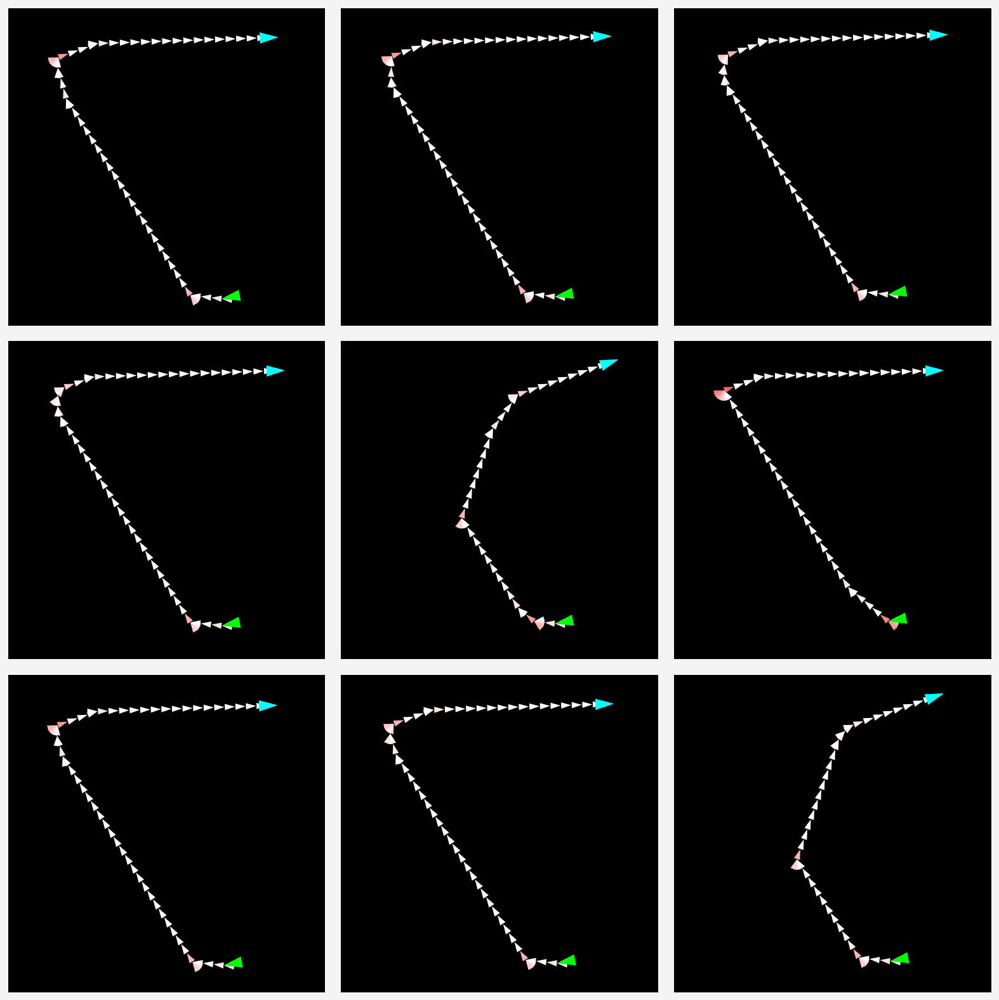

In [192]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(nrows=3, ncols=3)
start = 0
for i in range(9):
    p = res2['ep_pos'][i+start][0]
    a = res2['ep_angle'][i+start][0]
    draw_trajectory(p, a, ax=ax[i])
    
ax.format(xlim=[0, 300], ylim=[0, 300])
pplt.rc.reset()


In [196]:
activ_s_ep = []
activ_n_ep = []
activ_l_ep = []

pos_s = []
pos_n = []
pos_l = []
angle_s = []
angle_n = []
angle_l = []

ap_s = []
ap_n = []
ap_l = []

vis_s = []
vis_n = []
vis_l = []
for i, a in enumerate(res2['activs']):
    if res2['shortcut_avail'][i][0][0]:
        if res2['shortcut_used'][i][0]:
            activ_s_ep.append(a[0]['shared_activations'][1])
            pos_s.append(res2['ep_pos'][i][0])
            angle_s.append(res2['ep_angle'][i][0])
            ap_s.append(res2['action_probs'][i])
            vis_s.append(res2['vis'][i][0])
        else:
            activ_l_ep.append(a[0]['shared_activations'][1])
            pos_l.append(res2['ep_pos'][i][0])
            angle_l.append(res2['ep_angle'][i][0])
            ap_l.append(res2['action_probs'][i])
            vis_l.append(res2['vis'][i][0])
    else:
        activ_n_ep.append(a[0]['shared_activations'][1])
        pos_n.append(res2['ep_pos'][i][0])
        angle_n.append(res2['ep_angle'][i][0])
        ap_n.append(res2['action_probs'][i])
        vis_n.append(res2['vis'][i][0])
        
        
        
activ_s = torch.vstack(activ_s_ep)
activ_n = torch.vstack(activ_n_ep)
activ_l = torch.vstack(activ_l_ep)

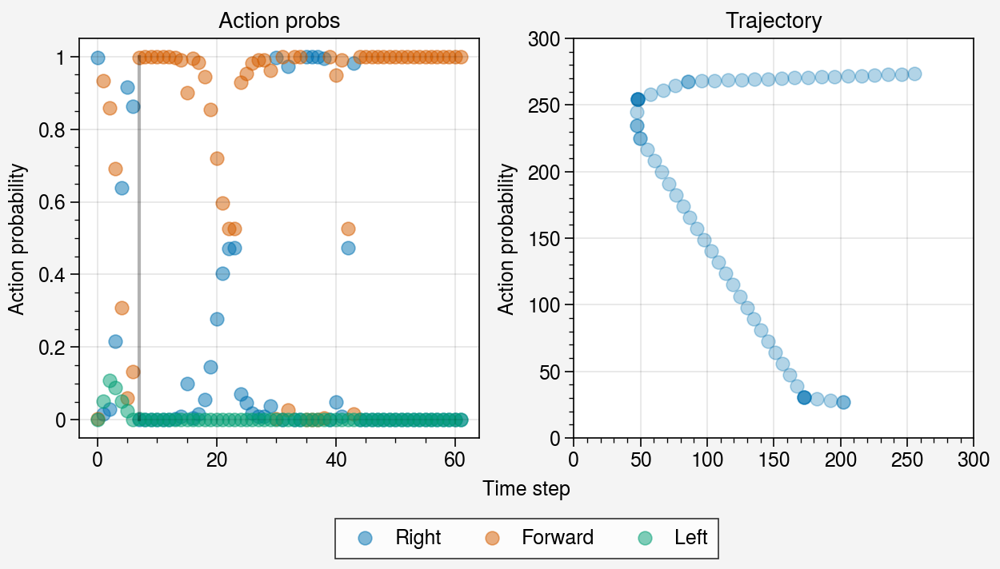

In [160]:
'''all action probs for ep'''
ep = 1
fig, ax = pplt.subplots(ncols=2, sharey=False)

a_s = res2['action_probs'][ep]
p = res2['ep_pos'][ep][0]
vis = res2['vis'][ep][0]
first_vis = np.argmax(vis)

cs = []
cs.append(ax[0].scatter(range(len(a_s)), a_s[:, 0], label='Right', alpha=0.5))
cs.append(ax[0].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
cs.append(ax[0].scatter(range(len(a_s)), a_s[:, 2], label='Left', alpha=0.5))
ax[0].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Action probs', 'Trajectory'])
ax[1].scatter(p[:, 0], p[:, 1], alpha=0.3)
ax[1].format(xlim=[0, 300], ylim=[0, 300])

fig.legend(cs, loc='b', ncols=3)


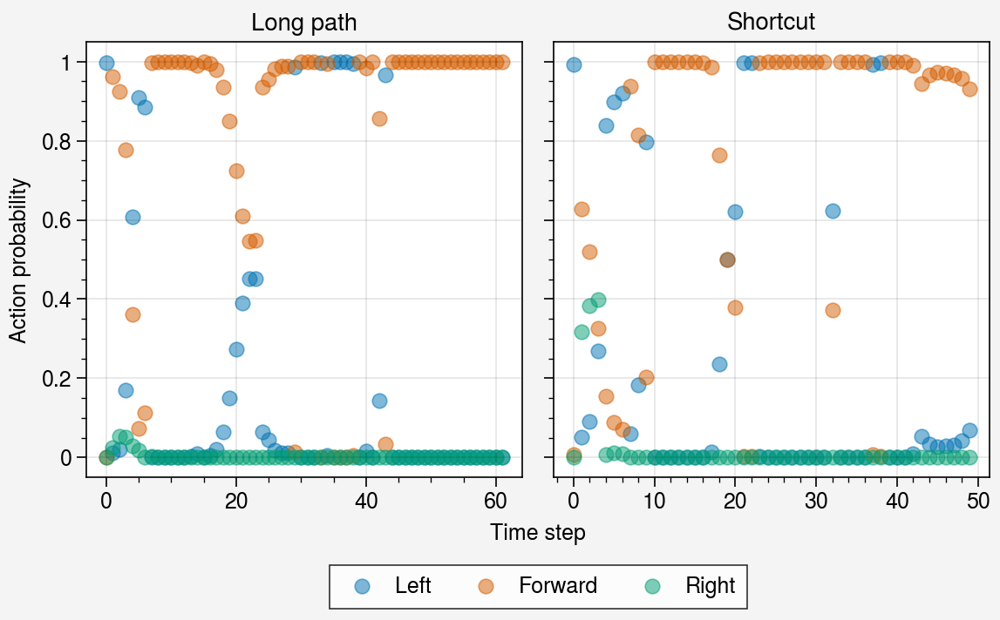

In [100]:
'''all action probs for ep'''
ep = 0
fig, ax = pplt.subplots(ncols=2)

a_n = ap_n[ep]
a_s = ap_s[ep]

ax[0].scatter(range(len(a_n)), a_n[:, 0], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 1], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 2], alpha=0.5)

vis = res2['vis'][ep][0]
first_vis = np.argmax(vis)
ax[0].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

cs = []
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 0], label='Left', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 2], label='Right', alpha=0.5))

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Long path', 'Shortcut'])
fig.legend(cs, loc='b', ncols=3)


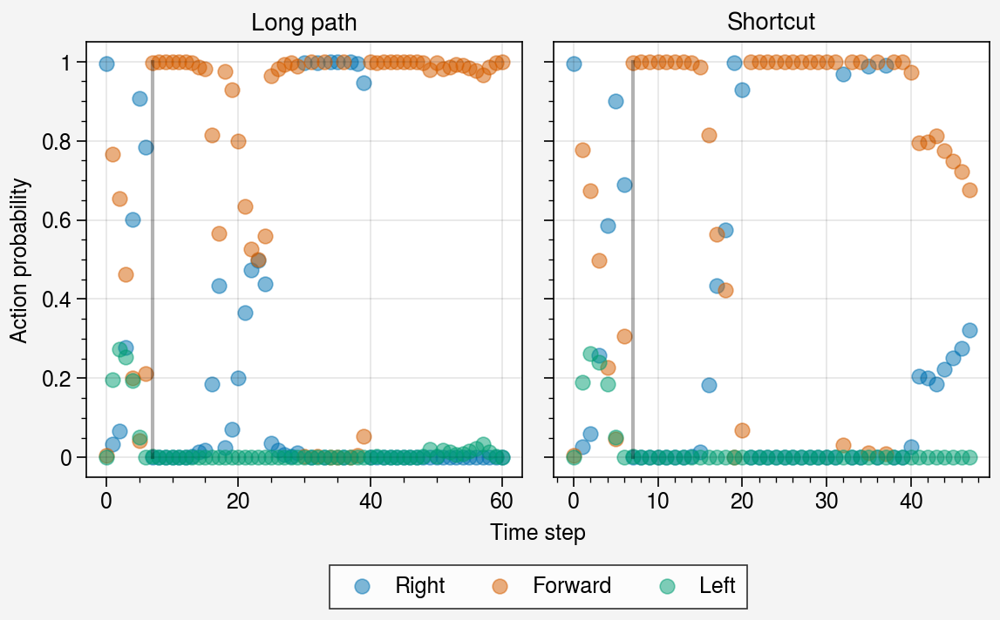

In [164]:
'''all action probs for ep'''
start = 0
end = 8

ep = 3
fig, ax = pplt.subplots(ncols=2)

a_n = ap_n[ep]
a_s = ap_s[ep]

ax[0].scatter(range(len(a_n)), a_n[:, 0], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 1], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 2], alpha=0.5)
vis = vis_n[ep]
first_vis = np.argmax(vis)
ax[0].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

cs = []
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 0], label='Right', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 2], label='Left', alpha=0.5))
vis = vis_s[ep]
first_vis = np.argmax(vis)
ax[1].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Long path', 'Shortcut'])
fig.legend(cs, loc='b', ncols=3)


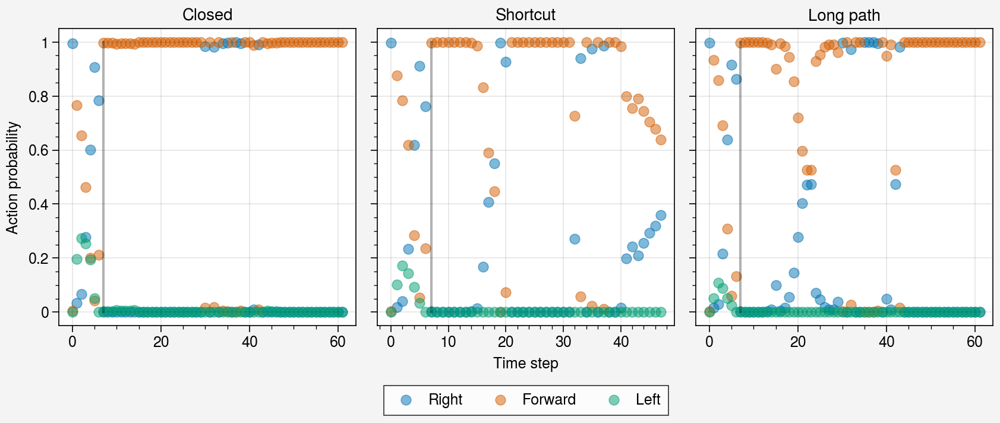

In [207]:
'''all action probs for ep'''
start = 0
end = 8

ep = 1
fig, ax = pplt.subplots(ncols=3)

a_n = ap_n[ep]
a_s = ap_s[ep]
a_l = ap_l[ep]

ax[0].scatter(range(len(a_n)), a_n[:, 0], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 1], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 2], alpha=0.5)
vis = vis_n[ep]
first_vis = np.argmax(vis)
ax[0].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

cs = []
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 0], label='Right', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 2], label='Left', alpha=0.5))
vis = vis_s[ep]
first_vis = np.argmax(vis)
ax[1].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

ax[2].scatter(range(len(a_l)), a_l[:, 0], alpha=0.5)
ax[2].scatter(range(len(a_l)), a_l[:, 1], alpha=0.5)
ax[2].scatter(range(len(a_l)), a_l[:, 2], alpha=0.5)
vis = vis_l[ep]
first_vis = np.argmax(vis)
ax[2].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)


ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Closed', 'Shortcut', 'Long path'])
fig.legend(cs, loc='b', ncols=3)


In [208]:
v_n = np.argmax(vis_n[ep])
v_s = np.argmax(vis_s[ep])
v_l = np.argmax(vis_l[ep])

i = 0

a_n = activ_n_ep[ep][v_n+i:v_n+3+i]
a_s = activ_s_ep[ep][v_s+i:v_s+3+i]
a_l = activ_l_ep[ep][v_l+i:v_l+3+i]

In [209]:

v_n = np.argmax(vis_n[ep])
v_s = np.argmax(vis_s[ep])
v_l = np.argmax(vis_l[ep])

i = 0

a_n = activ_n_ep[ep][v_n+i:v_n+3+i]
a_s = activ_s_ep[ep][v_s+i:v_s+3+i]
a_l = activ_l_ep[ep][v_l+i:v_l+3+i]
print(two_set_silhouette_score(a_n, a_s))
print(two_set_overlap_score(a_n, a_s))
print(two_set_euclidean(a_n, a_s))
print(two_set_mean_wasserstein(a_n, a_s))

0.7037508496739807
0.0
5.754
0.49458205451567966


In [210]:
print(two_set_silhouette_score(a_n, a_l))
print(two_set_overlap_score(a_n, a_l))
print(two_set_euclidean(a_n, a_l))
print(two_set_mean_wasserstein(a_n, a_l))

0.6992368118289872
0.1111111111111111
5.7
0.4889272650082906


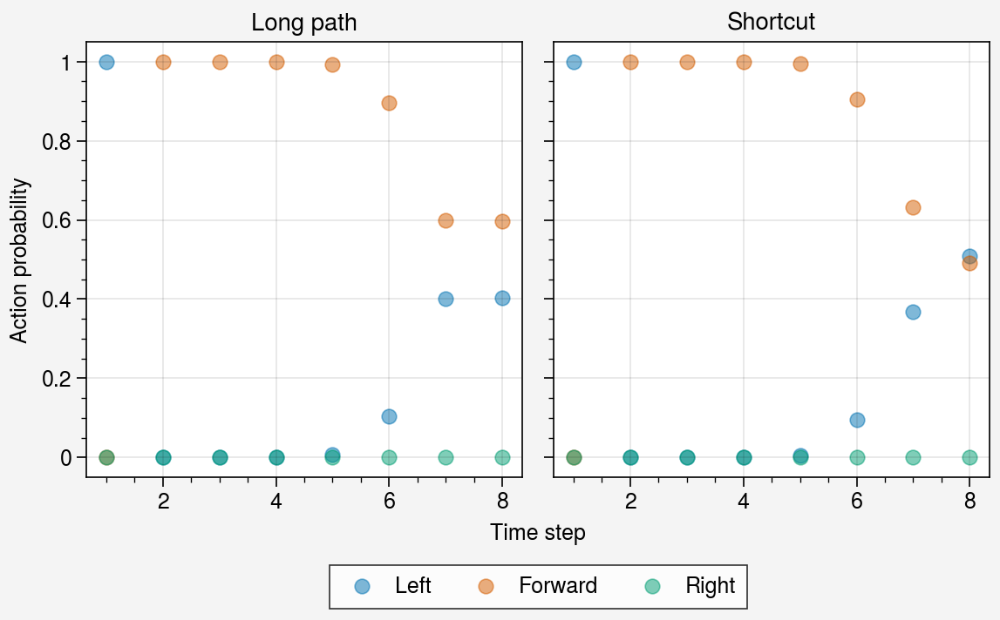

In [94]:
start = 0
end = 8

ep = 0
fig, ax = pplt.subplots(ncols=2)

ax[0].scatter(range(start+1, end+1), ap_n[ep][start:end, 0], alpha=0.5)
ax[0].scatter(range(start+1, end+1), ap_n[ep][start:end, 1], alpha=0.5)
ax[0].scatter(range(start+1, end+1), ap_n[ep][start:end, 2], alpha=0.5)

cs = []
cs.append(ax[1].scatter(range(start+1, end+1), ap_s[ep][start:end, 0], label='Left', alpha=0.5))
cs.append(ax[1].scatter(range(start+1, end+1), ap_s[ep][start:end, 1], label='Forward', alpha=0.5))
cs.append(ax[1].scatter(range(start+1, end+1), ap_s[ep][start:end, 2], label='Right', alpha=0.5))

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Long path', 'Shortcut'])
fig.legend(cs, loc='b', ncols=3)


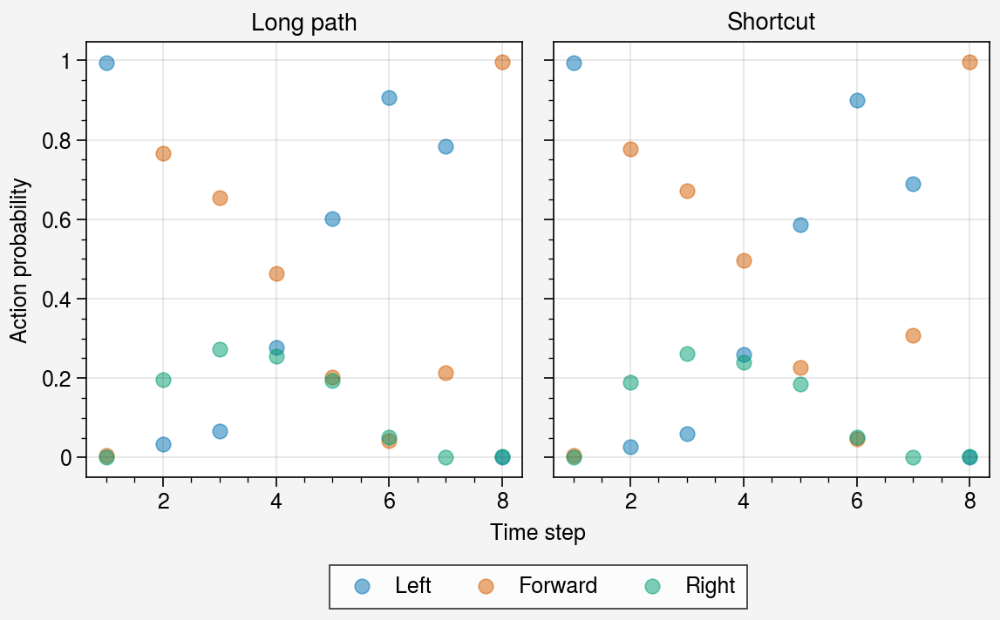

In [81]:
start = 0
end = 8

ep = 3
fig, ax = pplt.subplots(ncols=2)

ax[0].scatter(range(start+1, end+1), ap_n[ep][start:end, 0], alpha=0.5)
ax[0].scatter(range(start+1, end+1), ap_n[ep][start:end, 1], alpha=0.5)
ax[0].scatter(range(start+1, end+1), ap_n[ep][start:end, 2], alpha=0.5)

cs = []
cs.append(ax[1].scatter(range(start+1, end+1), ap_s[ep][start:end, 0], label='Left', alpha=0.5))
cs.append(ax[1].scatter(range(start+1, end+1), ap_s[ep][start:end, 1], label='Forward', alpha=0.5))
cs.append(ax[1].scatter(range(start+1, end+1), ap_s[ep][start:end, 2], label='Right', alpha=0.5))

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Long path', 'Shortcut'])
fig.legend(cs, loc='b', ncols=3)


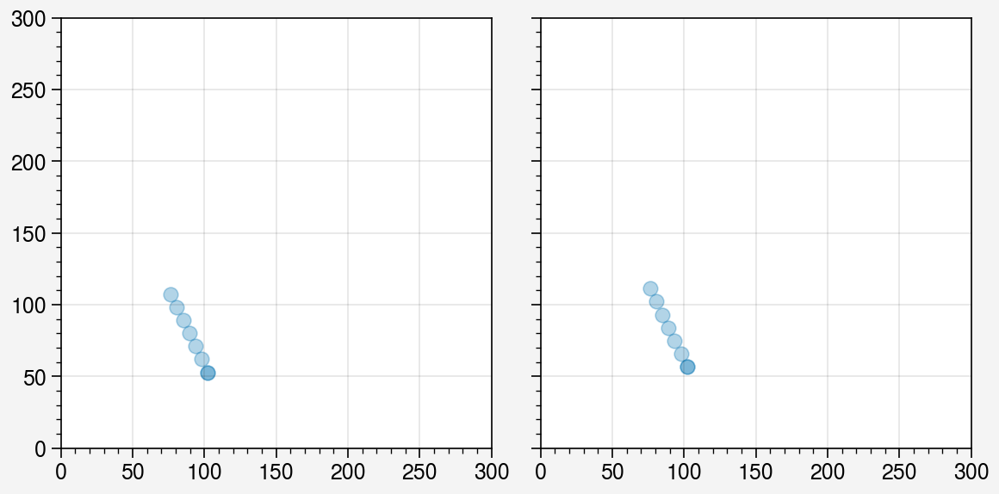

In [52]:
ep = 0
start = 0
end = 8

fig, ax = pplt.subplots(ncols=2)
a = activ_n_ep[ep]
p = pos_n[ep]
ax[0].scatter(p[start:end, 0], p[start:end, 1], alpha=0.3)

a = activ_s_ep[ep]
p = pos_s[ep]
ax[1].scatter(p[start:end, 0], p[start:end, 1], alpha=0.3)


ax.format(xlim=[0, 300], ylim=[0, 300])

(array([1., 0., 1., 0., 0., 1., 0., 1., 0., 1.]),
 array([0.01586494, 0.01634   , 0.01681507, 0.01729013, 0.0177652 ,
        0.01824026, 0.01871533, 0.01919039, 0.01966546, 0.02014052,
        0.02061558]),
 <BarContainer object of 10 artists>)

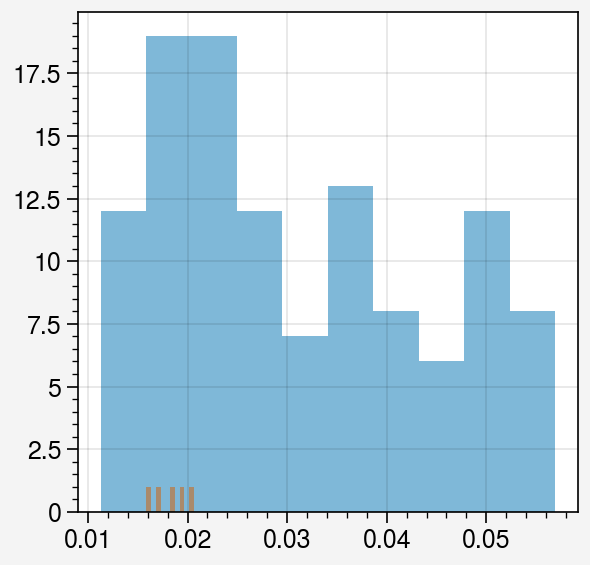

In [57]:
ysn = []
yss = []

start = 0
end = 8

for a_n in activ_n_ep:
    score = two_set_silhouette_score(activ_n, a_n[start:end])
    ysn.append(score)
for a_s in activ_s_ep:
    score = two_set_silhouette_score(activ_n, a_s[start:end])
    yss.append(score)
    
fig, ax = pplt.subplots()
ax.hist(ysn, alpha=0.5)
ax.hist(yss, alpha=0.5)



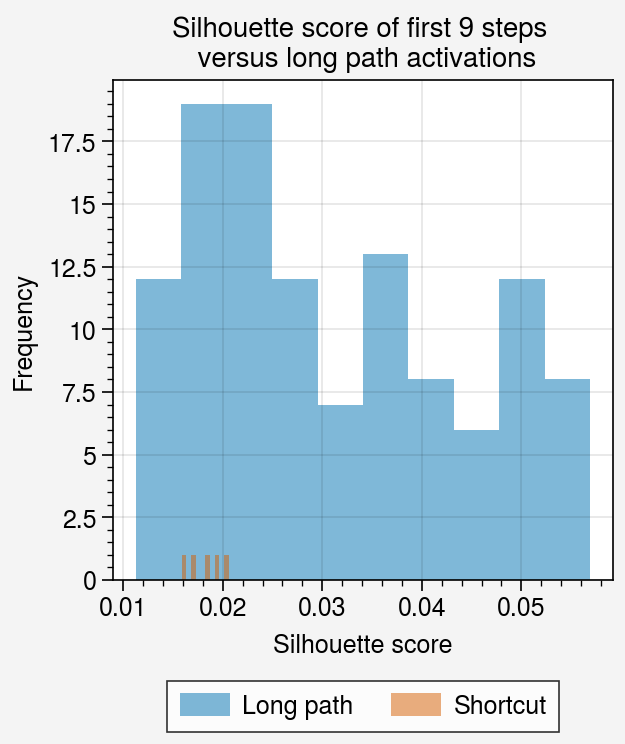

In [66]:
fig, ax = pplt.subplots()
cs = []
_, _, c = ax.hist(ysn, alpha=0.5, label='Long path')
cs.append(c)
_, _, c = ax.hist(yss, alpha=0.5, label='Shortcut')
cs.append(c)
fig.legend(cs, loc='b')

ax.format(xlabel='Silhouette score', ylabel='Frequency',
         title='Silhouette score of first 9 steps \n versus long path activations')

100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [10:40<00:00, 80.06s/it]


ValueError: Invalid title list length 8 for axes with number 9.

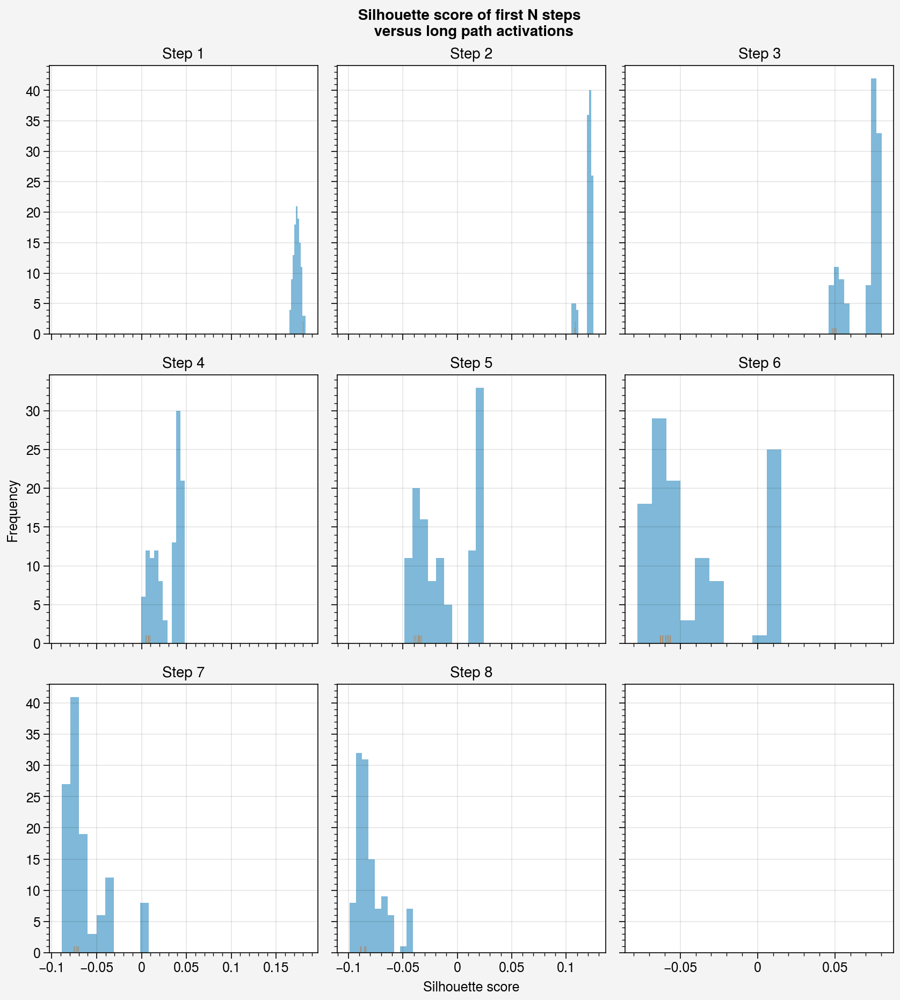

In [68]:

fig, ax = pplt.subplots(nrows=3, ncols=3)

for i in tqdm(range(8)):
    ysn = []
    yss = []
    
    start = i
    end = i+1
    
    for a_n in activ_n_ep:
        score = two_set_silhouette_score(activ_n, a_n[start:end])
        ysn.append(score)
    for a_s in activ_s_ep:
        score = two_set_silhouette_score(activ_n, a_s[start:end])
        yss.append(score)
    
    cs = []
    _, _, c = ax[i].hist(ysn, alpha=0.5, label='Long path')
    cs.append(c)
    _, _, c = ax[i].hist(yss, alpha=0.5, label='Shortcut')
    cs.append(c)
    
    
ax.format(xlabel='Silhouette score', ylabel='Frequency',
         suptitle='Silhouette score of first N steps \n versus long path activations',
         title=[f'Step {i}' for i in range(1, 9)])



## 0.1_0, wc1.5

In [125]:
p = 0.1
t = 0
chk = 440
model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', subdir='shortcut_wc2', trial=t, chk=chk)

res = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
               env_kwargs={'character_reset_pos': 3,
                          'shortcut_probability': 1,
                          'wall_colors': 1.5},
           seed=1, with_activations=True, data_callback=shortcut_visdata_callback,
               num_episodes=50)

'''Collect up to first+nth step of seeing shortcut
where first is the first step seeing the shortcut'''
activs = ep_stack_activations(res, half=True)

res = {
    'activs': activs,
    'actions': actions,
    'ep_pos': res['data']['pos'],
    'ep_angle': res['data']['angle'],
    'vis': res['data']['shortcut_vis'],
    'shortcut_avail': res['data']['shortcut'],
    'shortcut_used': [[check_shortcut_usage(p) for p in res['data']['pos']]]
}
print(np.sum(res['shortcut_used']))

7


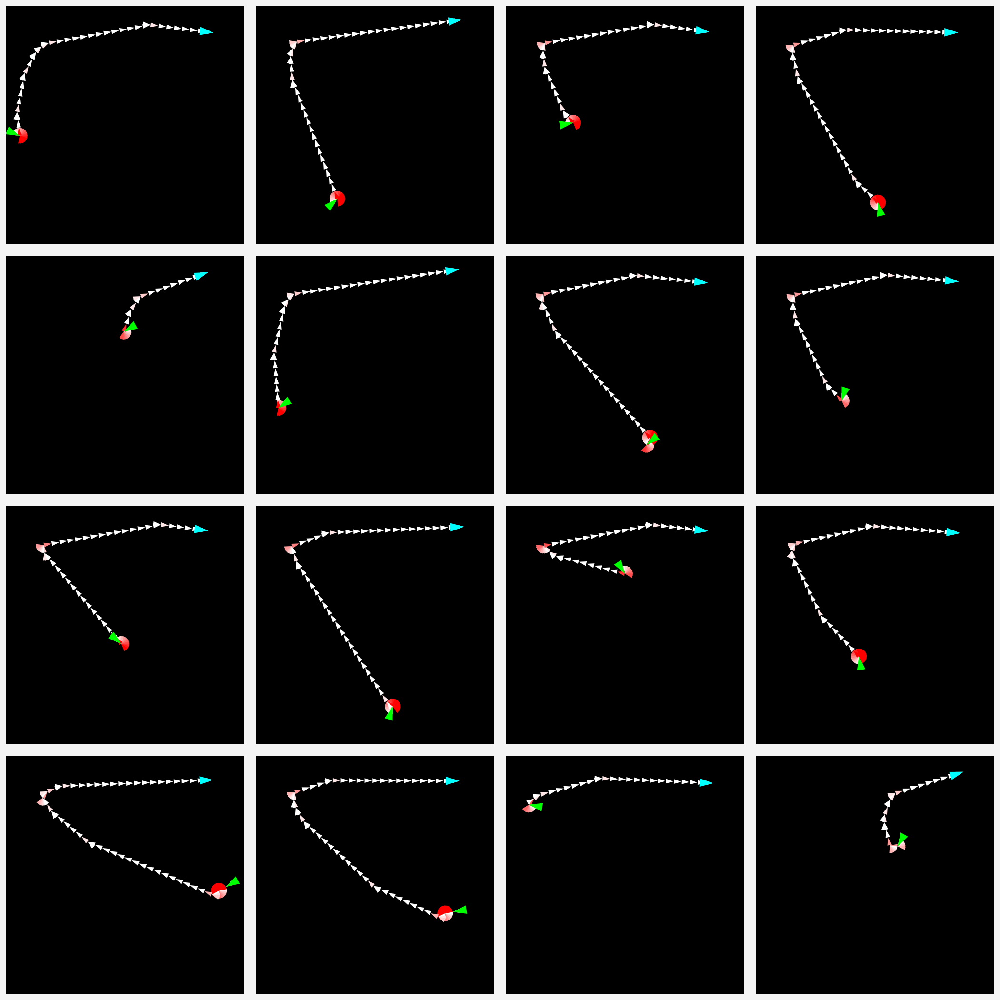

In [129]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(nrows=4, ncols=4)
start = 0
for i in range(16):
    p = res['ep_pos'][i+start]
    a = res['ep_angle'][i+start]
    draw_trajectory(p, a, ax=ax[i])
    
ax.format(xlim=[0, 300], ylim=[0, 300])
pplt.rc.reset()


In [136]:
p=0.1

# Pick an episode to generate starts in the neighborhood of

pos = res['ep_pos'][3][0]
a = res['ep_angle'][3][0][0]


# add 5 to each direction as starts
add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 5.), np.arange(-5, 5.1, 5.))]
add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 2.), np.arange(-5, 5.1, 2.))]
# add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 1.), np.arange(-5, 5.1, 1.))]

model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', subdir='shortcut_wc2', trial=t, chk=chk)


'''Collect up to first+nth step of seeing shortcut
where first is the first step seeing the shortcut'''

res2 = {
    'activs': [],
    'actions': [],
    'ep_pos': [],
    'ep_angle': [],
    'vis': [],
    'action_probs': [],
    'shortcut_avail': [],
    'shortcut_used': []
}

for i in range(len(add_starts)):
    r = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
               env_kwargs={'character_reset_pos': 3,
                          'shortcut_probability': 1,
                          'wall_colors': 1.5,
                          'fixed_reset': [pos+add_starts[i], a]},
           seed=1, with_activations=True, data_callback=shortcut_visdata_callback,
               num_episodes=1)
    activs = ep_stack_activations(r, half=True)
    res2['activs'] += activs,
    res2['actions'] += actions,
    res2['action_probs'] += r['action_probs']
    res2['ep_pos'] += r['data']['pos'],
    res2['ep_angle'] += r['data']['angle'],
    res2['vis'] += r['data']['shortcut_vis'],
    res2['shortcut_avail'] += r['data']['shortcut'],
    res2['shortcut_used'] += [[check_shortcut_usage(p) for p in r['data']['pos']]]
    

np.sum(res2['shortcut_used'])

0

In [132]:
activ_s_ep = []
activ_n_ep = []

pos_s = []
pos_n = []
angle_s = []
angle_n = []

ap_s = []
ap_n = []
for i, a in enumerate(res2['activs']):
    if res2['shortcut_used'][i][0]:
        activ_s_ep.append(a[0]['shared_activations'][1])
        pos_s.append(res2['ep_pos'][i][0])
        angle_s.append(res2['ep_angle'][i][0])
        ap_s.append(res2['action_probs'][i])
    else:
        activ_n_ep.append(a[0]['shared_activations'][1])
        pos_n.append(res2['ep_pos'][i][0])
        angle_n.append(res2['ep_angle'][i][0])
        ap_n.append(res2['action_probs'][i])
        
        
activ_s = torch.vstack(activ_s_ep)
activ_n = torch.vstack(activ_n_ep)

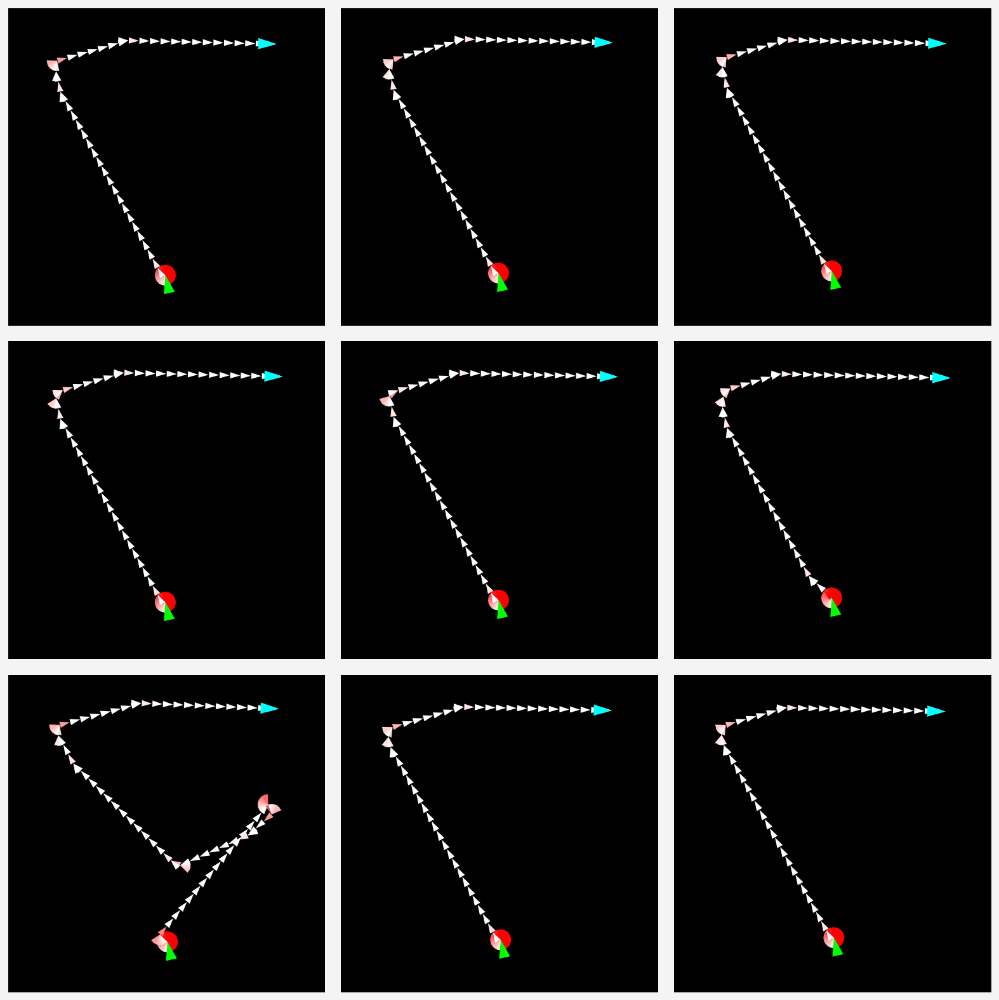

In [137]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(nrows=3, ncols=3)
start = 0
for i in range(9):
    p = res2['ep_pos'][i+start][0]
    a = res2['ep_angle'][i+start][0]
    draw_trajectory(p, a, ax=ax[i])
    
ax.format(xlim=[0, 300], ylim=[0, 300])
pplt.rc.reset()


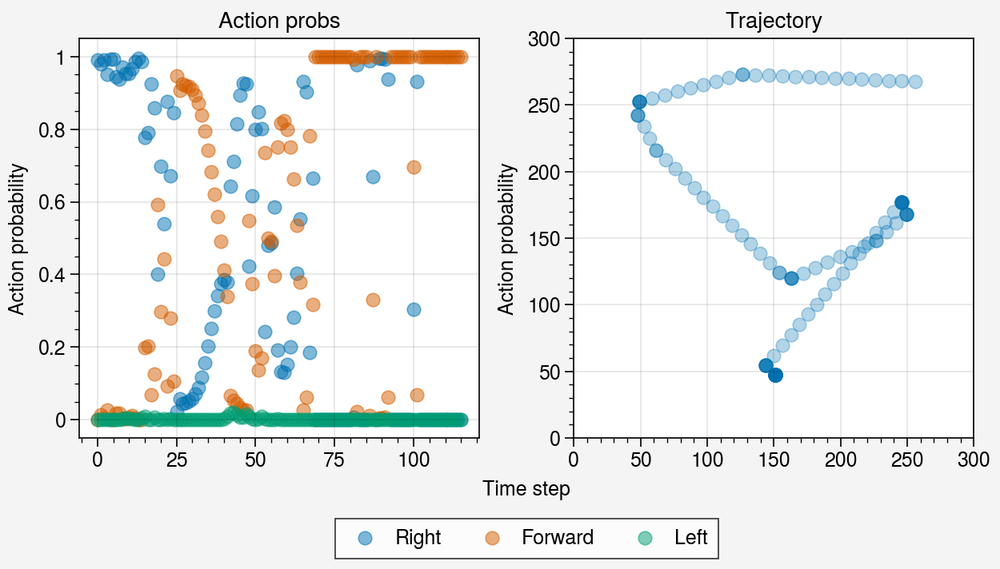

In [144]:
'''all action probs for ep'''
ep = 6
fig, ax = pplt.subplots(ncols=2, sharey=False)

a_s = res2['action_probs'][ep]
p = res2['ep_pos'][ep][0]

cs = []
cs.append(ax[0].scatter(range(len(a_s)), a_s[:, 0], label='Right', alpha=0.5))
cs.append(ax[0].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
cs.append(ax[0].scatter(range(len(a_s)), a_s[:, 2], label='Left', alpha=0.5))

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Action probs', 'Trajectory'])
ax[1].scatter(p[:, 0], p[:, 1], alpha=0.3)
ax[1].format(xlim=[0, 300], ylim=[0, 300])

fig.legend(cs, loc='b', ncols=3)


## wc4 0.1_0, chk=440

In [240]:
p = 0.1
t = 1
chk = 440
model, obs_rms = load_chk(f'shortcut_wc4p{p}', subdir='shortcut_wc2', trial=t, chk=chk)

res = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
               env_kwargs={'character_reset_pos': 3,
                          'shortcut_probability': 1,
                          'wall_colors': 4},
           seed=1, with_activations=True, data_callback=shortcut_visdata_callback,
               num_episodes=100)

'''Collect up to first+nth step of seeing shortcut
where first is the first step seeing the shortcut'''
activs = ep_stack_activations(res, half=True)

res = {
    'activs': activs,
    'actions': actions,
    'ep_pos': res['data']['pos'],
    'ep_angle': res['data']['angle'],
    'vis': res['data']['shortcut_vis'],
    'shortcut_avail': res['data']['shortcut'],
    'shortcut_used': [[check_shortcut_usage(p) for p in res['data']['pos']]]
}
print(np.sum(res['shortcut_used']))

62


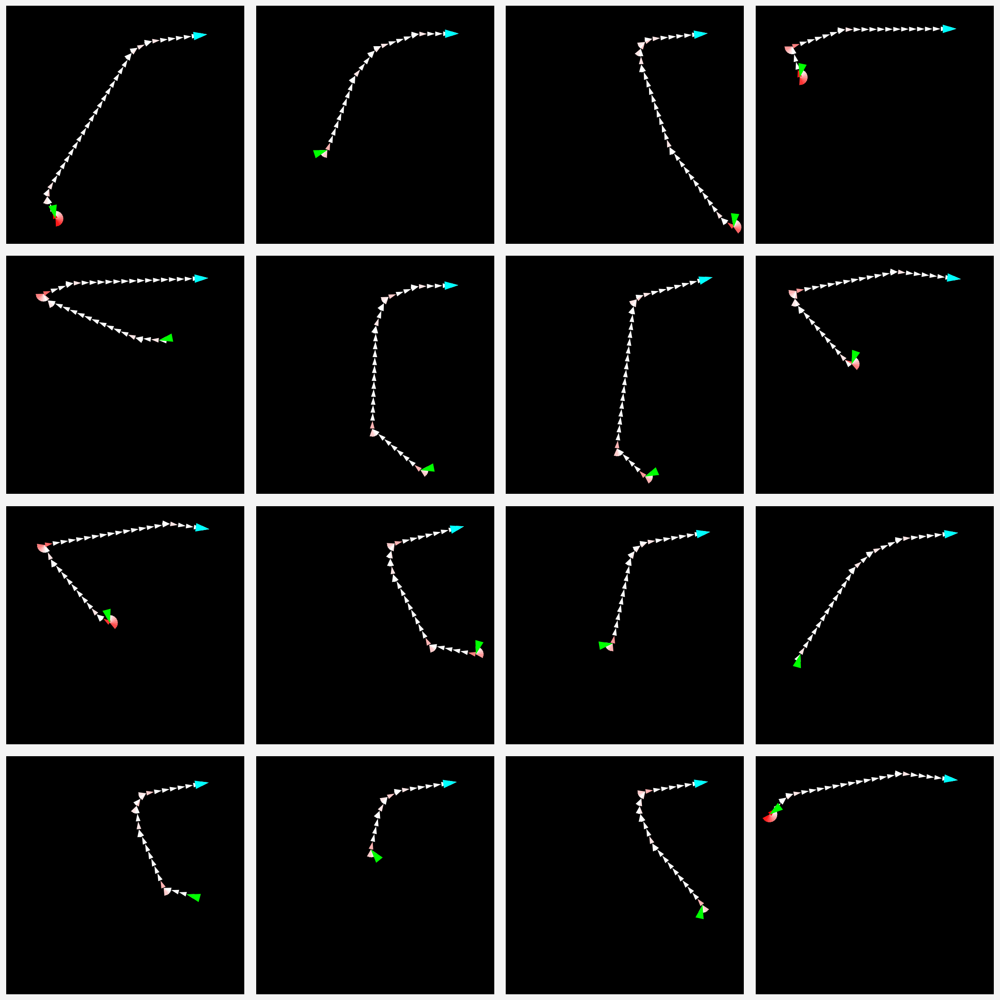

In [243]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(nrows=4, ncols=4)
start = 32
for i in range(16):
    p = res['ep_pos'][i+start]
    a = res['ep_angle'][i+start]
    draw_trajectory(p, a, ax=ax[i])
    
ax.format(xlim=[0, 300], ylim=[0, 300])
pplt.rc.reset()


In [178]:
def two_set_euclidean(x1, x2):
    dists = np.linalg.norm(x1[:, np.newaxis] - x2, axis=2)
    return np.mean(dists)

def two_set_overlap_score(x1, x2, radius=5.0):
    dists = np.linalg.norm(x1[:, np.newaxis] - x2, axis=2)
    num_overlaps = np.sum(dists <= 5.0)
    possible_overlaps = len(x1) * len(x2)
    return num_overlaps / possible_overlaps

def two_set_mean_wasserstein(x1, x2):
    num_comparisons = x1.shape[1]
    dists = []
    for i in range(num_comparisons):
        dists.append(wasserstein_distance(x1[:, i], x2[:, i]))
    return np.mean(dists)

In [273]:
# Pick an episode to generate starts in the neighborhood of

# p = res['ep_pos'][36][0]
# a = res['ep_angle'][36][0][0]

# p = res['ep_pos'][53][0]
# a = res['ep_angle'][53][0][0]

p = res['ep_pos'][59][0]
a = res['ep_angle'][59][0][0]


# add 5 to each direction as starts
add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 5.), np.arange(-5, 5.1, 5.))]
add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 2.), np.arange(-5, 5.1, 2.))]
# add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 1.), np.arange(-5, 5.1, 1.))]

model, obs_rms = load_chk(f'shortcut_wc1.5p0.4', subdir='shortcut_wc2', trial=0, chk=440)


'''Collect up to first+nth step of seeing shortcut
where first is the first step seeing the shortcut'''

res2 = {
    'activs': [],
    'actions': [],
    'ep_pos': [],
    'ep_angle': [],
    'vis': [],
    'action_probs': [],
    'shortcut_avail': [],
    'shortcut_used': []
}

for i in range(len(add_starts)):
    r = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
               env_kwargs={'character_reset_pos': 3,
                          # 'shortcut_probability': 1,
                           'shortcut_probability': 0.5,
                          'wall_colors': 1.5,
                          'fixed_reset': [p+add_starts[i], a]},
           seed=i, with_activations=True, data_callback=shortcut_visdata_callback,
               num_episodes=1)
    activs = ep_stack_activations(r, half=True)
    res2['activs'] += activs,
    res2['actions'] += actions,
    res2['action_probs'] += r['action_probs']
    res2['ep_pos'] += r['data']['pos'],
    res2['ep_angle'] += r['data']['angle'],
    res2['vis'] += r['data']['shortcut_vis'],
    res2['shortcut_avail'] += r['data']['shortcut'],
    res2['shortcut_used'] += [[check_shortcut_usage(p) for p in r['data']['pos']]]
    

np.sum(res2['shortcut_used'])

18

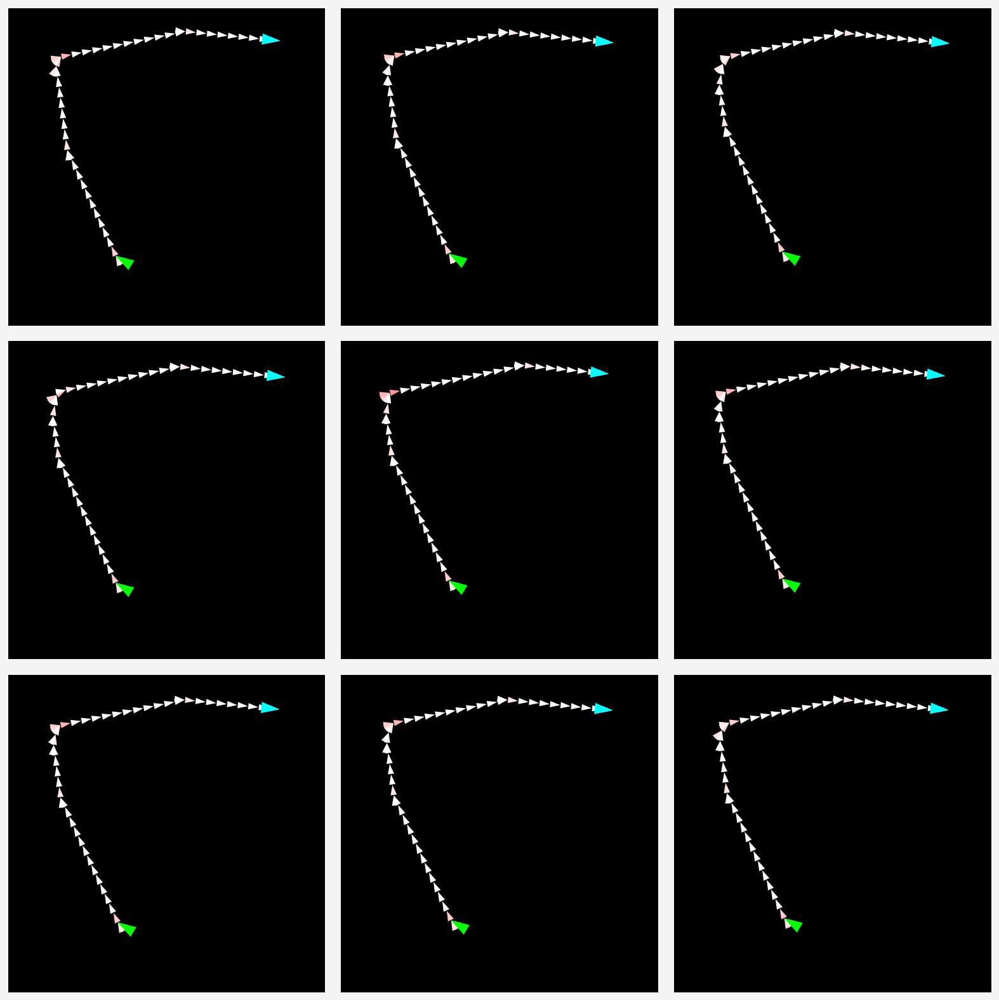

In [220]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(nrows=3, ncols=3)
start = 0
for i in range(9):
    p = res2['ep_pos'][i+start][0]
    a = res2['ep_angle'][i+start][0]
    draw_trajectory(p, a, ax=ax[i])
    
ax.format(xlim=[0, 300], ylim=[0, 300])
pplt.rc.reset()


In [275]:
activ_s_ep = []
activ_n_ep = []
activ_l_ep = []

pos_s = []
pos_n = []
pos_l = []
angle_s = []
angle_n = []
angle_l = []

ap_s = []
ap_n = []
ap_l = []

vis_s = []
vis_n = []
vis_l = []
for i, a in enumerate(res2['activs']):
    if res2['shortcut_avail'][i][0][0]:
        if res2['shortcut_used'][i][0]:
            activ_s_ep.append(a[0]['shared_activations'][1])
            pos_s.append(res2['ep_pos'][i][0])
            angle_s.append(res2['ep_angle'][i][0])
            ap_s.append(res2['action_probs'][i])
            vis_s.append(res2['vis'][i][0])
        else:
            activ_l_ep.append(a[0]['shared_activations'][1])
            pos_l.append(res2['ep_pos'][i][0])
            angle_l.append(res2['ep_angle'][i][0])
            ap_l.append(res2['action_probs'][i])
            vis_l.append(res2['vis'][i][0])
    else:
        activ_n_ep.append(a[0]['shared_activations'][1])
        pos_n.append(res2['ep_pos'][i][0])
        angle_n.append(res2['ep_angle'][i][0])
        ap_n.append(res2['action_probs'][i])
        vis_n.append(res2['vis'][i][0])
        
        
if len(activ_s_ep) > 0:
    activ_s = torch.vstack(activ_s_ep)
if len(activ_n_ep) > 0:
    activ_n = torch.vstack(activ_n_ep)
if len(activ_l_ep) > 0:
    activ_l = torch.vstack(activ_l_ep)

Shortcut available: [[False]]


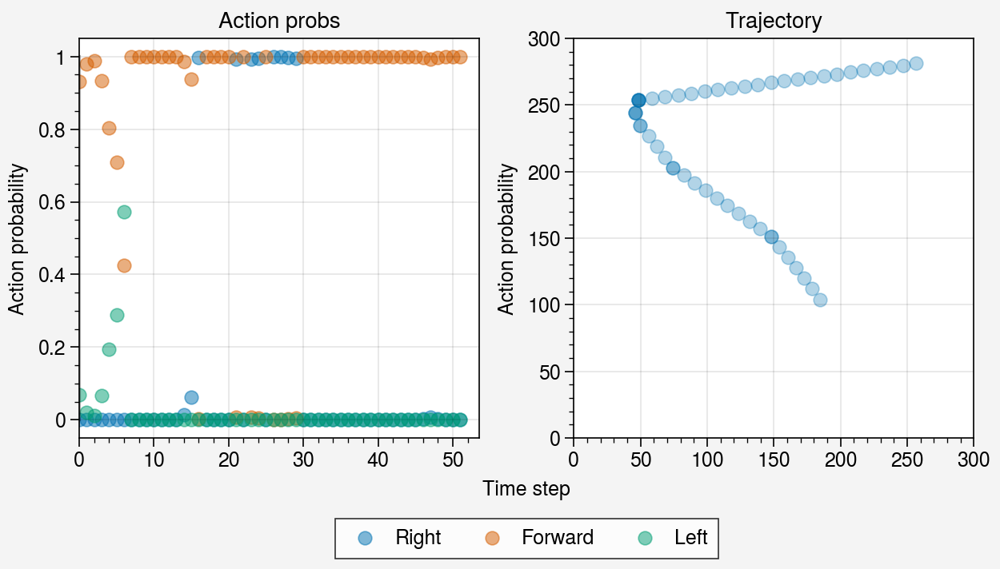

In [278]:
'''all action probs for ep'''
ep = 5
fig, ax = pplt.subplots(ncols=2, sharey=False)
print('Shortcut available:', res2['shortcut_avail'][ep])
a_s = res2['action_probs'][ep]
p = res2['ep_pos'][ep][0]
vis = res2['vis'][ep][0]
first_vis = np.argmax(vis)

cs = []
cs.append(ax[0].scatter(range(len(a_s)), a_s[:, 0], label='Right', alpha=0.5))
cs.append(ax[0].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
cs.append(ax[0].scatter(range(len(a_s)), a_s[:, 2], label='Left', alpha=0.5))
ax[0].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Action probs', 'Trajectory'])
ax[1].scatter(p[:, 0], p[:, 1], alpha=0.3)
ax[1].format(xlim=[0, 300], ylim=[0, 300])

fig.legend(cs, loc='b', ncols=3)


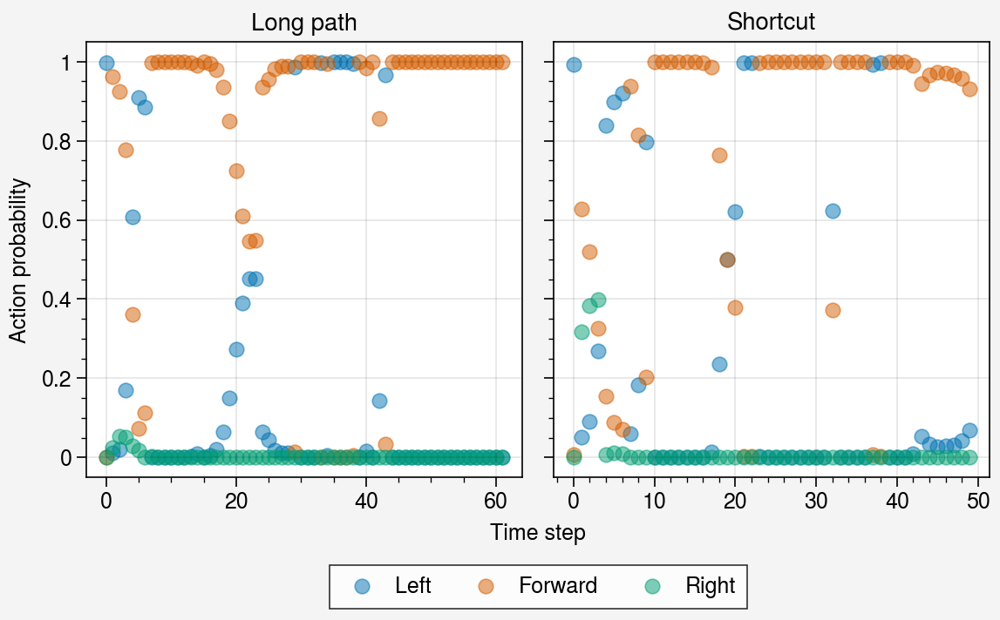

In [100]:
'''all action probs for ep'''
ep = 0
fig, ax = pplt.subplots(ncols=2)

a_n = ap_n[ep]
a_s = ap_s[ep]

ax[0].scatter(range(len(a_n)), a_n[:, 0], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 1], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 2], alpha=0.5)

vis = res2['vis'][ep][0]
first_vis = np.argmax(vis)
ax[0].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

cs = []
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 0], label='Left', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 2], label='Right', alpha=0.5))

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Long path', 'Shortcut'])
fig.legend(cs, loc='b', ncols=3)


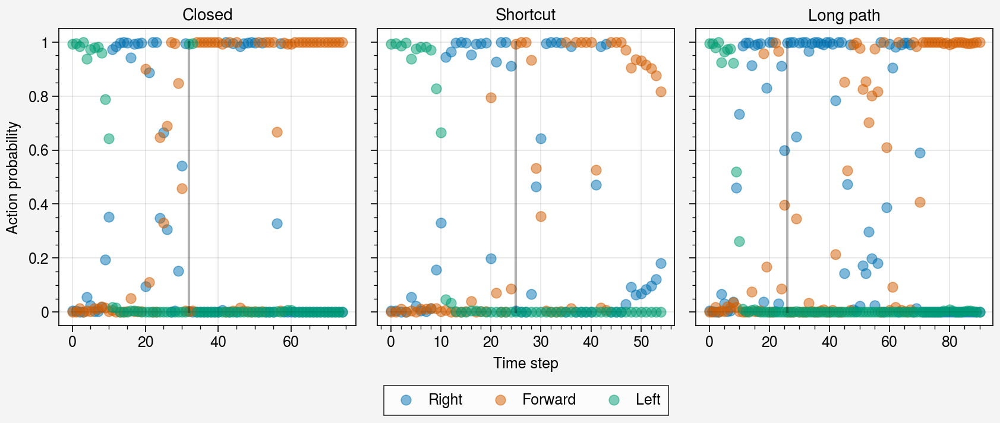

In [247]:
'''all action probs for ep'''
start = 0
end = 8

ep = 0
fig, ax = pplt.subplots(ncols=3)

a_n = ap_n[ep]
a_s = ap_s[ep]
a_l = ap_l[ep]

ax[0].scatter(range(len(a_n)), a_n[:, 0], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 1], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 2], alpha=0.5)
vis = vis_n[ep]
first_vis = np.argmax(vis)
ax[0].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

cs = []
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 0], label='Right', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 2], label='Left', alpha=0.5))
vis = vis_s[ep]
first_vis = np.argmax(vis)
ax[1].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

ax[2].scatter(range(len(a_l)), a_l[:, 0], alpha=0.5)
ax[2].scatter(range(len(a_l)), a_l[:, 1], alpha=0.5)
ax[2].scatter(range(len(a_l)), a_l[:, 2], alpha=0.5)
vis = vis_l[ep]
first_vis = np.argmax(vis)
ax[2].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)


ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Closed', 'Shortcut', 'Long path'])
fig.legend(cs, loc='b', ncols=3)


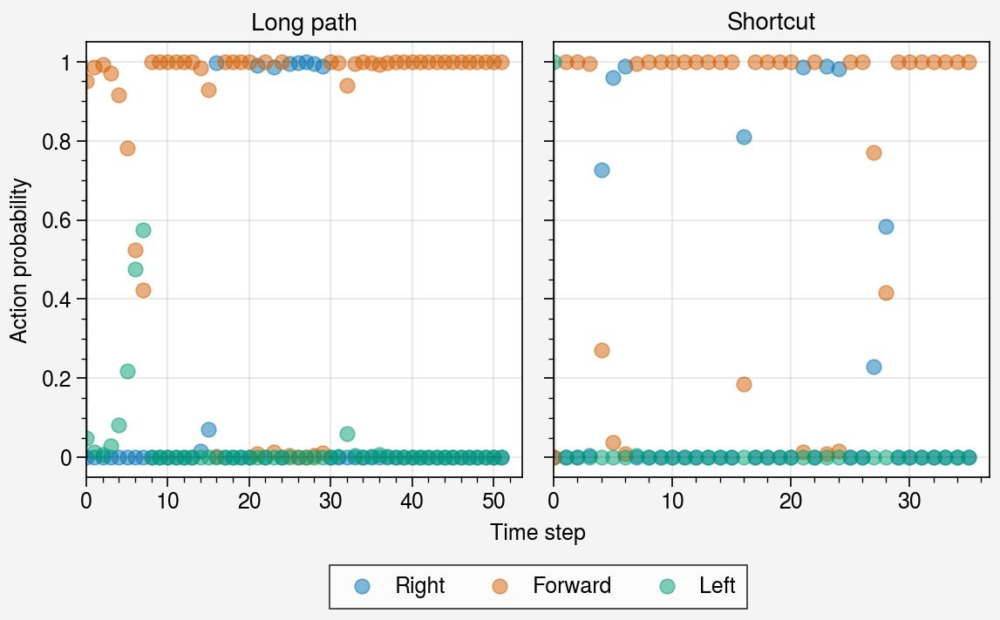

In [277]:
'''all action probs for ep'''
ep = 0
fig, ax = pplt.subplots(ncols=2)

a_n = ap_n[ep]
a_s = ap_s[ep]

ax[0].scatter(range(len(a_n)), a_n[:, 0], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 1], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 2], alpha=0.5)
vis = vis_n[ep]
first_vis = np.argmax(vis)
ax[0].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

cs = []
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 0], label='Right', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 2], label='Left', alpha=0.5))
vis = vis_s[ep]
first_vis = np.argmax(vis)
ax[1].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Long path', 'Shortcut'])
fig.legend(cs, loc='b', ncols=3)


In [279]:
v_n = np.argmax(vis_n[ep])
v_s = np.argmax(vis_s[ep])
# v_l = np.argmax(vis_l[ep])

i = 0

a_n = activ_n_ep[ep][v_n+i:v_n+3+i]
a_s = activ_s_ep[ep][v_s+i:v_s+3+i]
# a_l = activ_l_ep[ep][v_l+i:v_l+3+i]
print(two_set_silhouette_score(a_n, a_s))
print(two_set_overlap_score(a_n, a_s))
print(two_set_euclidean(a_n, a_s))
print(two_set_mean_wasserstein(a_n, a_s))

0.48114699710637066
0.0
5.746
0.5289352834224701


# More action probability analysis

## p=0.4, t=0 agent phenomena examples

In [123]:
chk = 440
probs = [0.0, 0.8]
p = 0.4
t = 0
model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)

res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=100, deterministic=True, seed=1)

In [76]:
shortcut_used = [check_shortcut_usage(p) for p in res['data']['pos']]
lens1 = [len(a) for a in res['actions']]
sur = np.mean(shortcut_used)
mean_len = np.mean(lens1)

true_used = np.array(shortcut_used) & (np.array(lens1) < 202)
eps = np.argwhere(true_used).squeeze()

print(f'SUR: {sur:.2f}, mean_len: {mean_len:.2f}')

SUR: 0.65, mean_len: 45.57


In [132]:
chk = 440
probs = [0.0, 0.8]
p = 0.4
t = 0
model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)

res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=100, deterministic=False, seed=1)

In [133]:
shortcut_used = [check_shortcut_usage(p) for p in res['data']['pos']]
lens1 = [len(a) for a in res['actions']]
sur = np.mean(shortcut_used)
mean_len = np.mean(lens1)

true_used = np.array(shortcut_used) & (np.array(lens1) < 202)
eps = np.argwhere(true_used).squeeze()

print(f'SUR: {sur:.2f}, mean_len: {mean_len:.2f}')

SUR: 0.69, mean_len: 46.67


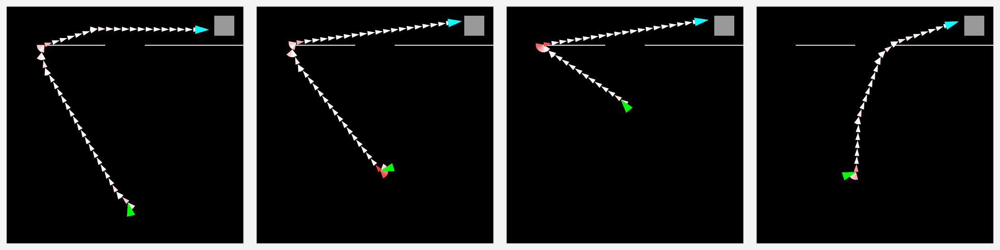

In [97]:
set_trajectory_plot_style()

eps = [3, 16, 45, 21]
fig, ax = pplt.subplots(ncols=4)
for i, ep in enumerate(eps):
    avail = res['data']['shortcut'][ep][0]
    p = res['data']['pos'][ep]
    a = res['data']['angle'][ep]
    draw_shortcut_maze(shortcut_open=avail, ax=ax[i])
    draw_trajectory(p, a, ax=ax[i])
    
pplt.rc.reset()

(<matplotlib.legend.Legend at 0x1b3a487e6d0>,
 <matplotlib.legend.Legend at 0x1b37198adc0>)

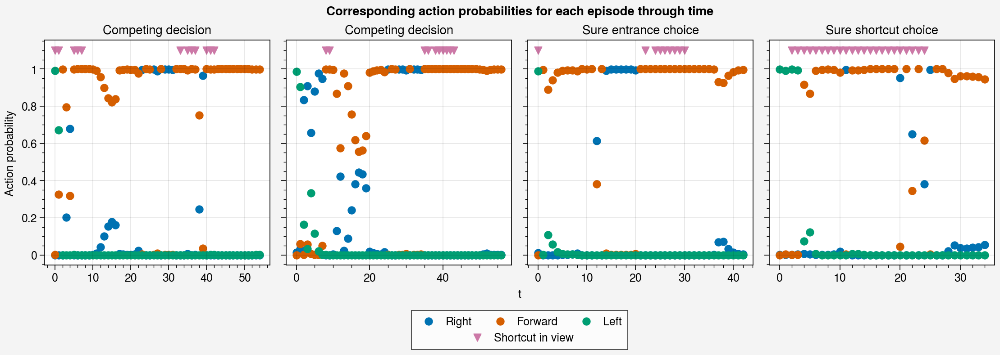

In [101]:
fig, ax = pplt.subplots(ncols=4)

for i, ep in enumerate(eps):
    pts = []
    pts.append(ax[i].scatter(res['action_probs'][ep][:, :3], labels=['Right', 'Forward', 'Left']))
    
    v = res['data']['shortcut_vis'][ep]
    v = np.argwhere(v).squeeze()
    vy = np.full(v.shape, 1.1)
    
    pts.append(ax[i].scatter(v, vy, marker='v', label='Shortcut in view'))
    
ax.format(title=[
    'Competing decision', 'Competing decision',
    'Sure entrance choice', 'Sure shortcut choice'
], xlabel='t', ylabel='Action probability',
         suptitle='Corresponding action probabilities for each episode through time')
fig.legend(pts, loc='b')

### Jitter starts

In [125]:
# Pick an episode to generate starts in the neighborhood of

ep = 16

p = res['data']['pos'][ep][0]
a = res['data']['angle'][ep][0][0]

# add 5 to each direction as starts
add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 5.), np.arange(-5, 5.1, 5.))]
add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 2.), np.arange(-5, 5.1, 2.))]
# add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 1.), np.arange(-5, 5.1, 1.))]


'''Collect up to first+nth step of seeing shortcut
where first is the first step seeing the shortcut'''

res2 = {
    'activs': [],
    'actions': [],
    'ep_pos': [],
    'ep_angle': [],
    'vis': [],
    'action_probs': [],
    'shortcut_avail': [],
    'shortcut_used': []
}

for i in range(len(add_starts)):
    r = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
               env_kwargs={'character_reset_pos': 3,
                          'shortcut_probability': 1,
                           # 'shortcut_probability': 0.5,
                          'wall_colors': 1.5,
                          'fixed_reset': [p+add_starts[i], a]},
           seed=i, with_activations=True, data_callback=shortcut_visdata_callback,
               num_episodes=1, deterministic=True)
    activs = ep_stack_activations(r, half=True)
    res2['activs'] += activs,
    res2['actions'] += r['actions'],
    res2['action_probs'] += r['action_probs']
    res2['ep_pos'] += r['data']['pos'],
    res2['ep_angle'] += r['data']['angle'],
    res2['vis'] += r['data']['shortcut_vis'],
    res2['shortcut_avail'] += r['data']['shortcut'],
    res2['shortcut_used'] += [[check_shortcut_usage(p) for p in r['data']['pos']]]
    

np.sum(res2['shortcut_used'])

19

In [131]:
# Pick an episode to generate starts in the neighborhood of

ep = 16

p = res['data']['pos'][ep][0]
a = res['data']['angle'][ep][0][0]

# add 5 to each direction as starts
add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 5.), np.arange(-5, 5.1, 5.))]
add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 2.), np.arange(-5, 5.1, 2.))]
# add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 1.), np.arange(-5, 5.1, 1.))]


'''Collect up to first+nth step of seeing shortcut
where first is the first step seeing the shortcut'''

res2 = {
    'activs': [],
    'actions': [],
    'ep_pos': [],
    'ep_angle': [],
    'vis': [],
    'action_probs': [],
    'shortcut_avail': [],
    'shortcut_used': []
}

for i in range(len(add_starts)):
    r = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
               env_kwargs={'character_reset_pos': 3,
                          'shortcut_probability': 1,
                           # 'shortcut_probability': 0.5,
                          'wall_colors': 1.5,
                          'fixed_reset': [p+add_starts[i], a]},
           seed=i, with_activations=True, data_callback=shortcut_visdata_callback,
               num_episodes=1, deterministic=False)
    activs = ep_stack_activations(r, half=True)
    res2['activs'] += activs,
    res2['actions'] += r['actions'],
    res2['action_probs'] += r['action_probs']
    res2['ep_pos'] += r['data']['pos'],
    res2['ep_angle'] += r['data']['angle'],
    res2['vis'] += r['data']['shortcut_vis'],
    res2['shortcut_avail'] += r['data']['shortcut'],
    res2['shortcut_used'] += [[check_shortcut_usage(p) for p in r['data']['pos']]]
    

np.sum(res2['shortcut_used'])

34

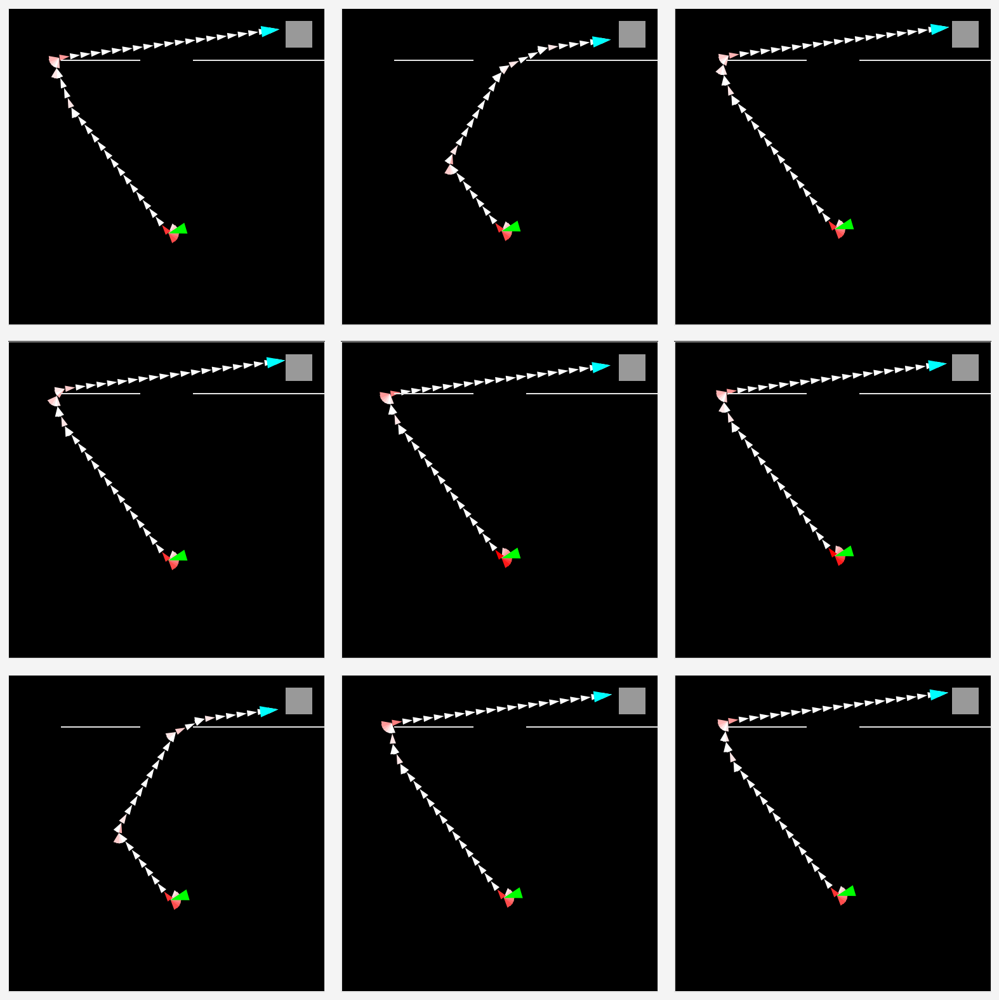

In [130]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(nrows=3, ncols=3)
start = 0
for i in range(9):
    p = res2['ep_pos'][i+start][0]
    a = res2['ep_angle'][i+start][0]
    draw_trajectory(p, a, ax=ax[i])
    draw_shortcut_maze(shortcut_open=True, ax=ax[i])
    
    
ax.format(xlim=[0, 300], ylim=[0, 300])
pplt.rc.reset()


(<matplotlib.legend.Legend at 0x1b3a4d39940>,
 <matplotlib.legend.Legend at 0x1b399660fd0>)

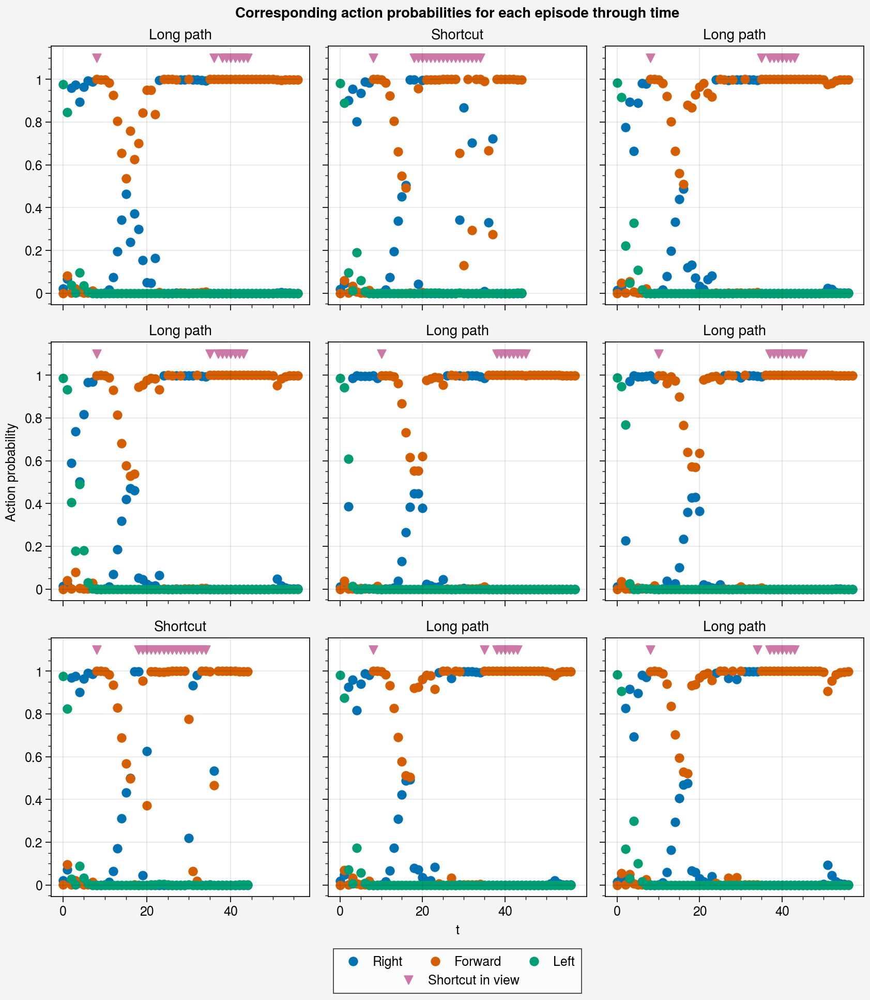

In [129]:
'''all action probs for ep'''
ep = 3
fig, ax = pplt.subplots(ncols=3, nrows=3)

title = []
for i, ep in enumerate(range(9)):
    a_s = res2['action_probs'][ep]
    p = res2['ep_pos'][ep][0]
    avail = res2['shortcut_avail'][ep][0][0]
    used = res2['shortcut_used'][ep][0]
    
    vis = res2['vis'][ep][0]
    first_vis = np.argmax(vis)

    pts = []
    pts.append(ax[i].scatter(res2['action_probs'][ep][:, :3], labels=['Right', 'Forward', 'Left']))
    v = np.argwhere(vis).squeeze()
    vy = np.full(v.shape, 1.1)
    pts.append(ax[i].scatter(v, vy, marker='v', label='Shortcut in view'))
    
    if avail:
        if used:
            title.append('Shortcut')
        else:
            title.append('Long path')
    else:
        title.append('Closed')

ax.format(title=title, xlabel='t', ylabel='Action probability',
         suptitle='Corresponding action probabilities for each episode through time')
fig.legend(pts, loc='b')


## Testing more examples to see how common

In [118]:
chk = 360
probs = [0.0, 0.8]
p = 0.4
t = 4
model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)

res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=100, deterministic=True, seed=1)

shortcut_used = [check_shortcut_usage(p) for p in res['data']['pos']]
lens1 = [len(a) for a in res['actions']]
sur = np.mean(shortcut_used)
mean_len = np.mean(lens1)

true_used = np.array(shortcut_used) & (np.array(lens1) < 202)
eps = np.argwhere(true_used).squeeze()

print(f'SUR: {sur:.2f}, mean_len: {mean_len:.2f}')

SUR: 0.61, mean_len: 46.91


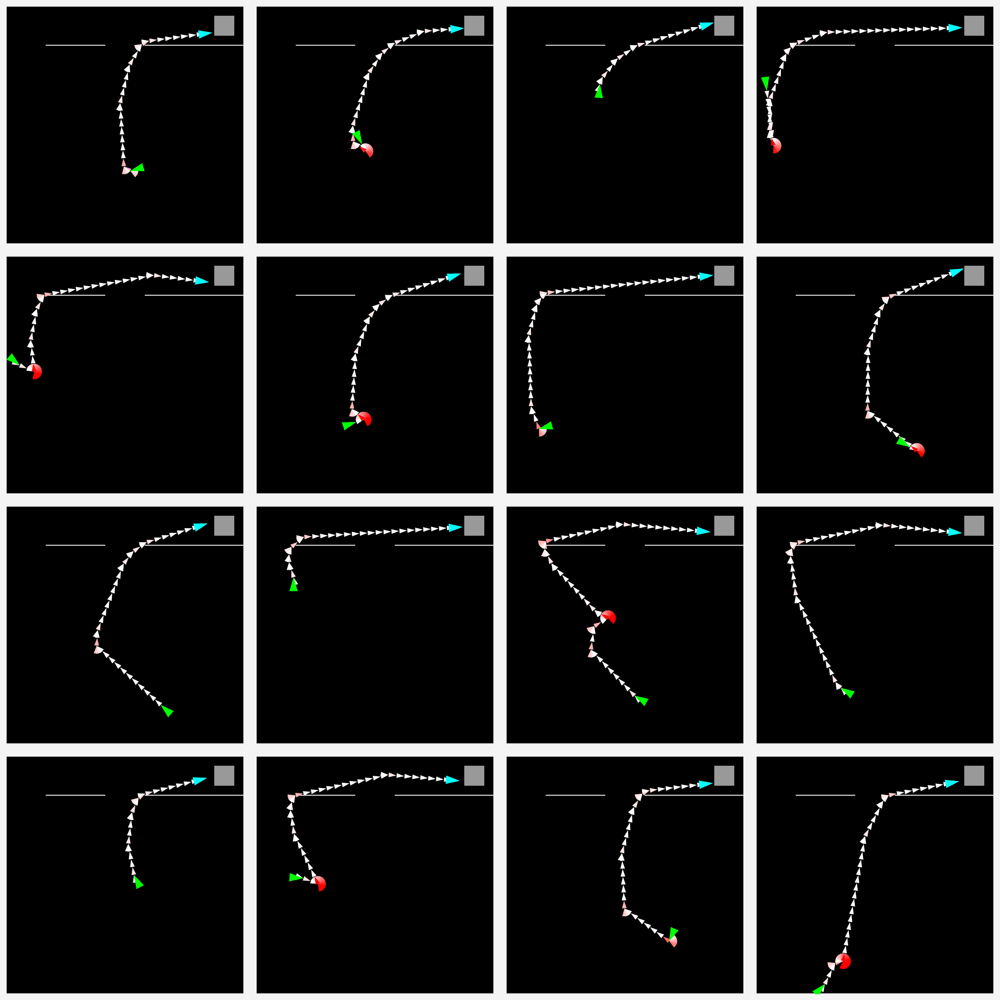

In [121]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(nrows=4, ncols=4)

for i, ep in enumerate(range(16, 32)):
# for i, ep in enumerate(eps):
    avail = res['data']['shortcut'][ep][0]
    p = res['data']['pos'][ep]
    a = res['data']['angle'][ep]
    draw_shortcut_maze(shortcut_open=avail, ax=ax[i])
    draw_trajectory(p, a, ax=ax[i])
    
pplt.rc.reset()

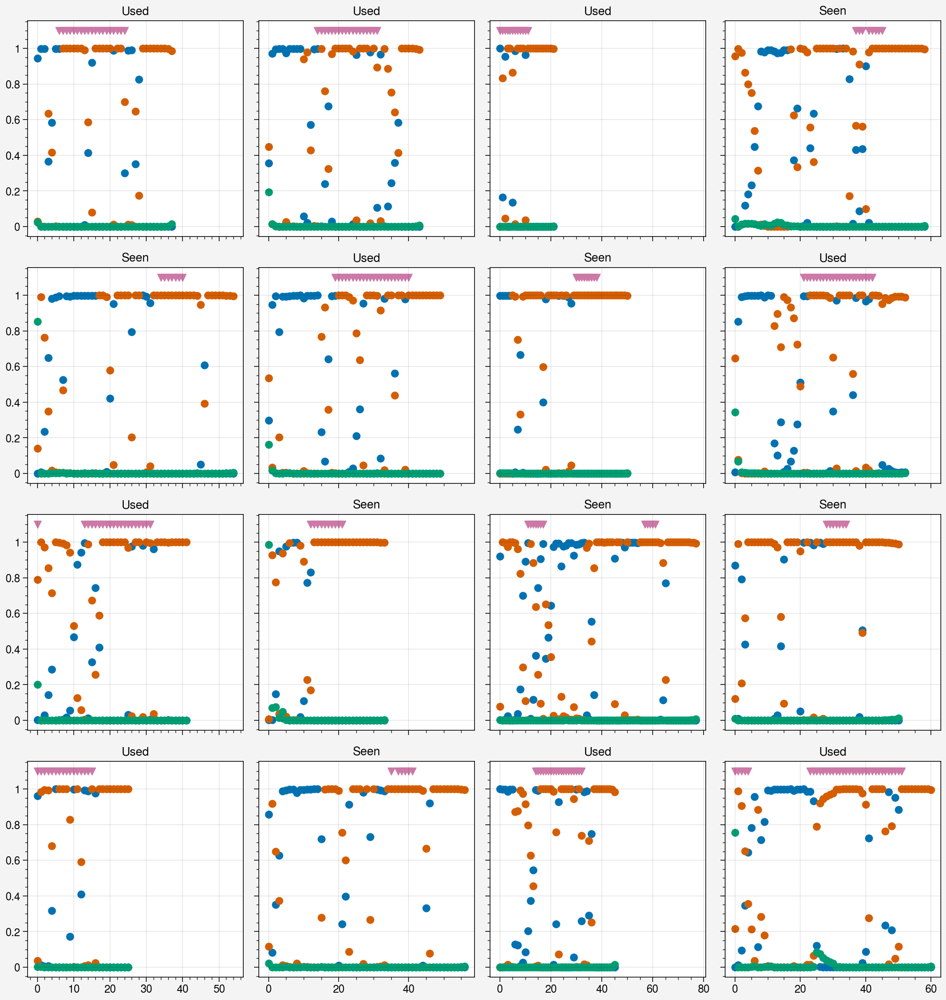

In [122]:
fig, ax = pplt.subplots(nrows=4, ncols=4)

title = []
for i, ep in enumerate(range(16, 32)):
    ax[i].scatter(res['action_probs'][ep][:, :3])
    
    v = res['data']['shortcut_vis'][ep]
    v = np.argwhere(v).squeeze()
    vy = np.full(v.shape, 1.1)
    ax[i].scatter(v, vy, marker='v')
    
    if check_shortcut_usage(res['data']['pos'][ep]):
        title.append('Used')
    else:
        title.append('Seen')
    
ax.format(title=title)

## More testing

In [471]:
p = 0.4
t = 5
chk = 440
model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', subdir='shortcut_wc2', trial=t, chk=chk)

res = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
               env_kwargs={'character_reset_pos': 3,
                          'shortcut_probability': 1,
                          'wall_colors': 1.5},
           seed=1, with_activations=True, data_callback=shortcut_visdata_callback,
               num_episodes=100)

'''Collect up to first+nth step of seeing shortcut
where first is the first step seeing the shortcut'''
activs = ep_stack_activations(res, half=True)

res = {
    'activs': activs,
    'actions': actions,
    'ep_pos': res['data']['pos'],
    'ep_angle': res['data']['angle'],
    'vis': res['data']['shortcut_vis'],
    'shortcut_avail': res['data']['shortcut'],
    'shortcut_used': [[check_shortcut_usage(p) for p in res['data']['pos']]]
}
print(np.sum(res['shortcut_used']))

81


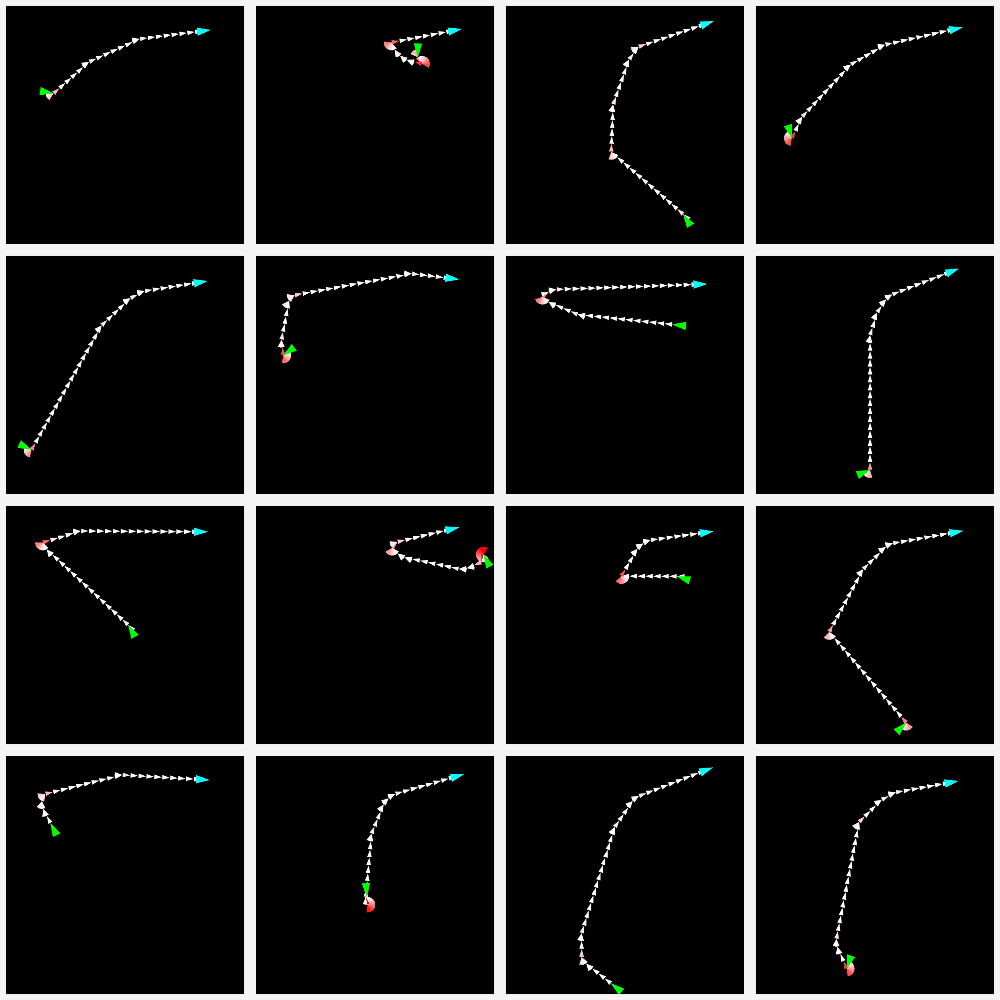

In [472]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(nrows=4, ncols=4)
start = 60
for i in range(16):
    p = res['ep_pos'][i+start]
    a = res['ep_angle'][i+start]
    draw_trajectory(p, a, ax=ax[i])
    
ax.format(xlim=[0, 300], ylim=[0, 300])
pplt.rc.reset()


In [573]:
# Pick an episode to generate starts in the neighborhood of

p = res['ep_pos'][36][0]
a = res['ep_angle'][36][0][0]

# p = res['ep_pos'][53][0]
# a = res['ep_angle'][53][0][0]

p = res['ep_pos'][37][0]
a = res['ep_angle'][37][0][0]

# p = res['ep_pos'][57][0]
# a = res['ep_angle'][57][0][0]


# add 5 to each direction as starts
add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 5.), np.arange(-5, 5.1, 5.))]
add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 2.), np.arange(-5, 5.1, 2.))]
# add_starts = [[i, j] for i, j in itertools.product(np.arange(-5, 5.1, 1.), np.arange(-5, 5.1, 1.))]

model, obs_rms = load_chk(f'shortcut_wc1.5p0.4', subdir='shortcut_wc2', trial=0, chk=440)


'''Collect up to first+nth step of seeing shortcut
where first is the first step seeing the shortcut'''

res2 = {
    'activs': [],
    'actions': [],
    'ep_pos': [],
    'ep_angle': [],
    'vis': [],
    'action_probs': [],
    'shortcut_avail': [],
    'shortcut_used': []
}

for i in range(len(add_starts)):
    r = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
               env_kwargs={'character_reset_pos': 3,
                          'shortcut_probability': 1,
                           # 'shortcut_probability': 0.5,
                          'wall_colors': 1.5,
                          'fixed_reset': [p+add_starts[i], a]},
           seed=i, with_activations=True, data_callback=shortcut_visdata_callback,
               num_episodes=1, deterministic=True)
    activs = ep_stack_activations(r, half=True)
    res2['activs'] += activs,
    res2['actions'] += r['actions'],
    res2['action_probs'] += r['action_probs']
    res2['ep_pos'] += r['data']['pos'],
    res2['ep_angle'] += r['data']['angle'],
    res2['vis'] += r['data']['shortcut_vis'],
    res2['shortcut_avail'] += r['data']['shortcut'],
    res2['shortcut_used'] += [[check_shortcut_usage(p) for p in r['data']['pos']]]
    

np.sum(res2['shortcut_used'])

29

In [572]:
33/36

0.9166666666666666

In [574]:
29/36

0.8055555555555556

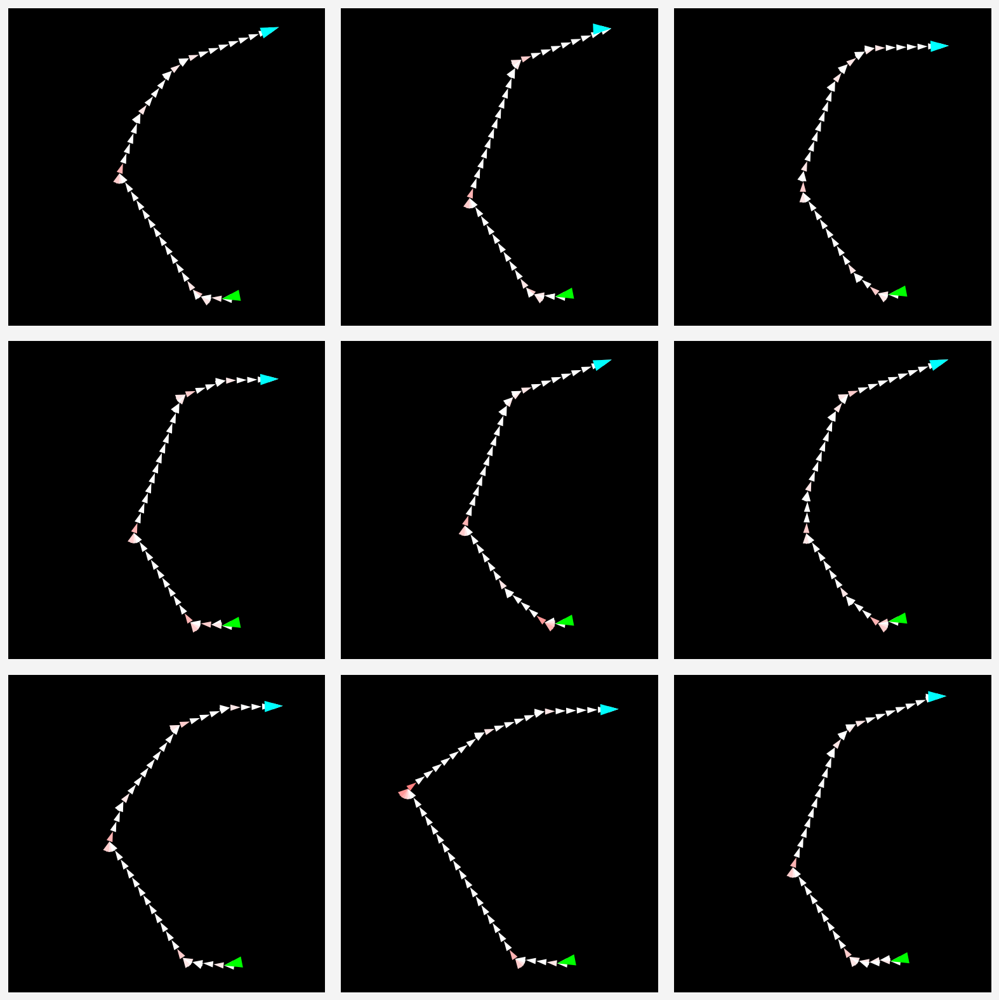

In [571]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(nrows=3, ncols=3)
start = 0
for i in range(9):
    p = res2['ep_pos'][i+start][0]
    a = res2['ep_angle'][i+start][0]
    draw_trajectory(p, a, ax=ax[i])
    
ax.format(xlim=[0, 300], ylim=[0, 300])
pplt.rc.reset()


In [196]:
activ_s_ep = []
activ_n_ep = []
activ_l_ep = []

pos_s = []
pos_n = []
pos_l = []
angle_s = []
angle_n = []
angle_l = []

ap_s = []
ap_n = []
ap_l = []

vis_s = []
vis_n = []
vis_l = []
for i, a in enumerate(res2['activs']):
    if res2['shortcut_avail'][i][0][0]:
        if res2['shortcut_used'][i][0]:
            activ_s_ep.append(a[0]['shared_activations'][1])
            pos_s.append(res2['ep_pos'][i][0])
            angle_s.append(res2['ep_angle'][i][0])
            ap_s.append(res2['action_probs'][i])
            vis_s.append(res2['vis'][i][0])
        else:
            activ_l_ep.append(a[0]['shared_activations'][1])
            pos_l.append(res2['ep_pos'][i][0])
            angle_l.append(res2['ep_angle'][i][0])
            ap_l.append(res2['action_probs'][i])
            vis_l.append(res2['vis'][i][0])
    else:
        activ_n_ep.append(a[0]['shared_activations'][1])
        pos_n.append(res2['ep_pos'][i][0])
        angle_n.append(res2['ep_angle'][i][0])
        ap_n.append(res2['action_probs'][i])
        vis_n.append(res2['vis'][i][0])
        
        
        
activ_s = torch.vstack(activ_s_ep)
activ_n = torch.vstack(activ_n_ep)
activ_l = torch.vstack(activ_l_ep)

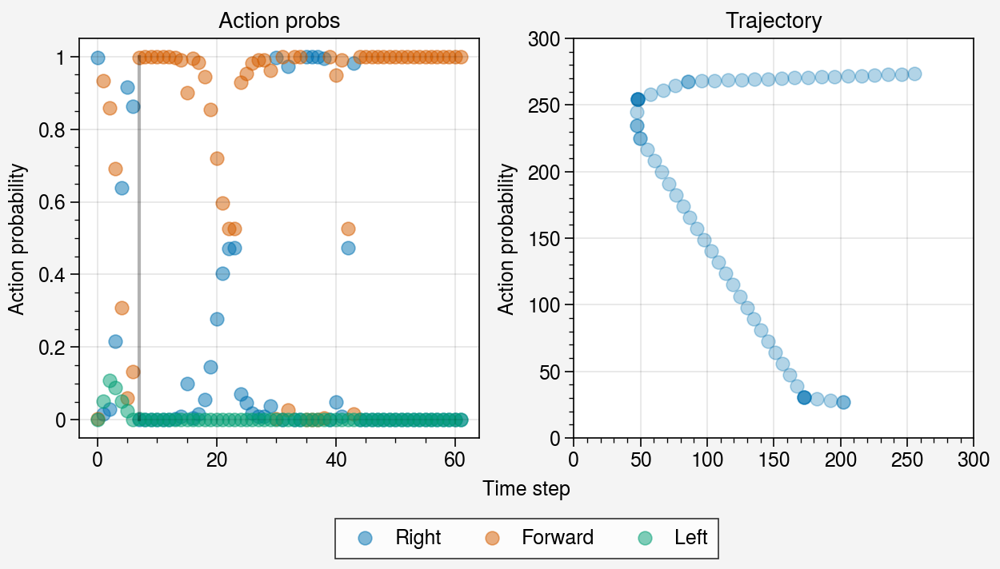

In [160]:
'''all action probs for ep'''
ep = 1
fig, ax = pplt.subplots(ncols=2, sharey=False)

a_s = res2['action_probs'][ep]
p = res2['ep_pos'][ep][0]
vis = res2['vis'][ep][0]
first_vis = np.argmax(vis)

cs = []
cs.append(ax[0].scatter(range(len(a_s)), a_s[:, 0], label='Right', alpha=0.5))
cs.append(ax[0].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
cs.append(ax[0].scatter(range(len(a_s)), a_s[:, 2], label='Left', alpha=0.5))
ax[0].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Action probs', 'Trajectory'])
ax[1].scatter(p[:, 0], p[:, 1], alpha=0.3)
ax[1].format(xlim=[0, 300], ylim=[0, 300])

fig.legend(cs, loc='b', ncols=3)


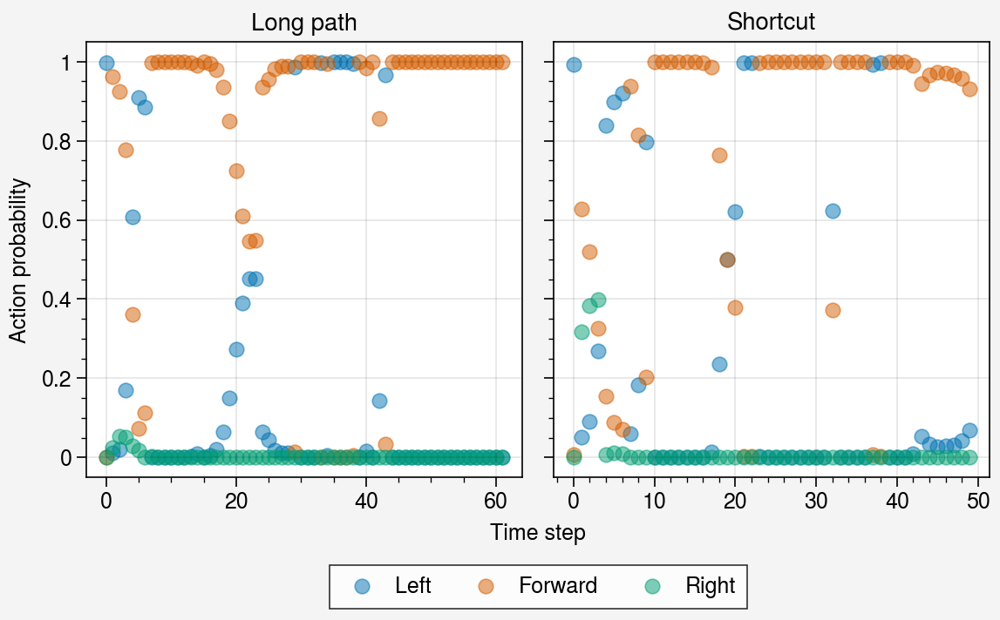

In [100]:
'''all action probs for ep'''
ep = 0
fig, ax = pplt.subplots(ncols=2)

a_n = ap_n[ep]
a_s = ap_s[ep]

ax[0].scatter(range(len(a_n)), a_n[:, 0], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 1], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 2], alpha=0.5)

vis = res2['vis'][ep][0]
first_vis = np.argmax(vis)
ax[0].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

cs = []
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 0], label='Left', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 2], label='Right', alpha=0.5))

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Long path', 'Shortcut'])
fig.legend(cs, loc='b', ncols=3)


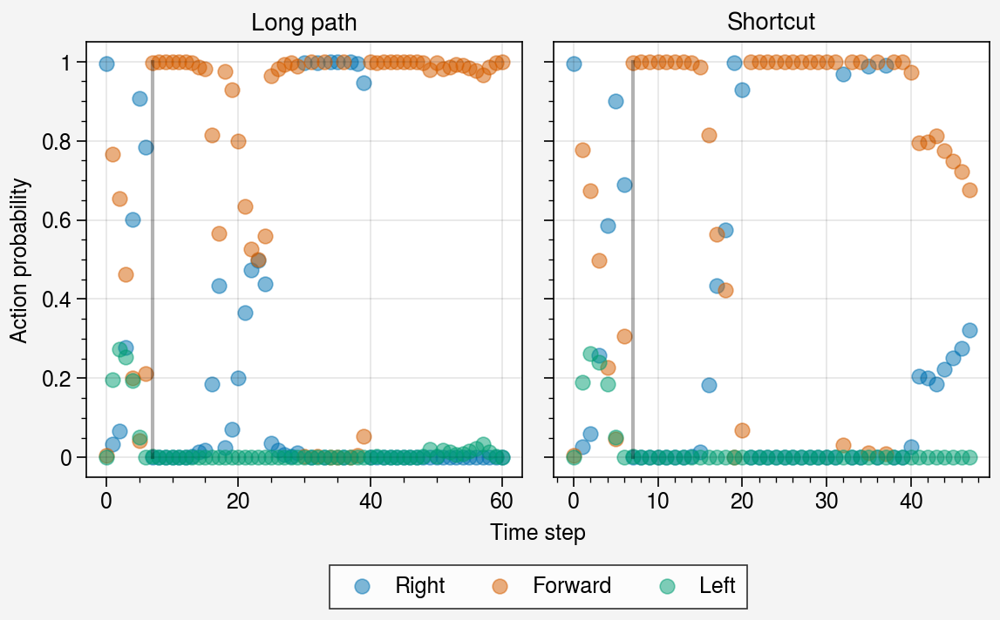

In [164]:
'''all action probs for ep'''
start = 0
end = 8

ep = 3
fig, ax = pplt.subplots(ncols=2)

a_n = ap_n[ep]
a_s = ap_s[ep]

ax[0].scatter(range(len(a_n)), a_n[:, 0], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 1], alpha=0.5)
ax[0].scatter(range(len(a_n)), a_n[:, 2], alpha=0.5)
vis = vis_n[ep]
first_vis = np.argmax(vis)
ax[0].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

cs = []
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 0], label='Right', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
cs.append(ax[1].scatter(range(len(a_s)), a_s[:, 2], label='Left', alpha=0.5))
vis = vis_s[ep]
first_vis = np.argmax(vis)
ax[1].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=['Long path', 'Shortcut'])
fig.legend(cs, loc='b', ncols=3)


In [478]:
res2['shortcut_used'][0][0]

False

In [ ]:
'''all action probs for ep'''
ep = 3
fig, ax = pplt.subplots(ncols=6, nrows=6)

title = []
for ep in range(36):
    a_s = res2['action_probs'][ep]
    p = res2['ep_pos'][ep][0]
    avail = res2['shortcut_avail'][ep][0][0]
    used = res2['shortcut_used'][ep][0]
    
    vis = res2['vis'][ep][0]
    first_vis = np.argmax(vis)

    cs = []
    cs.append(ax[ep].scatter(range(len(a_s)), a_s[:, 0], label='Right', alpha=0.5))
    cs.append(ax[ep].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
    cs.append(ax[ep].scatter(range(len(a_s)), a_s[:, 2], label='Left', alpha=0.5))
    ax[ep].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)
    
    if avail:
        if used:
            title.append('Shortcut')
        else:
            title.append('Long path')
    else:
        title.append('Closed')

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=title)
    
fig.legend(cs, loc='b', ncols=3)


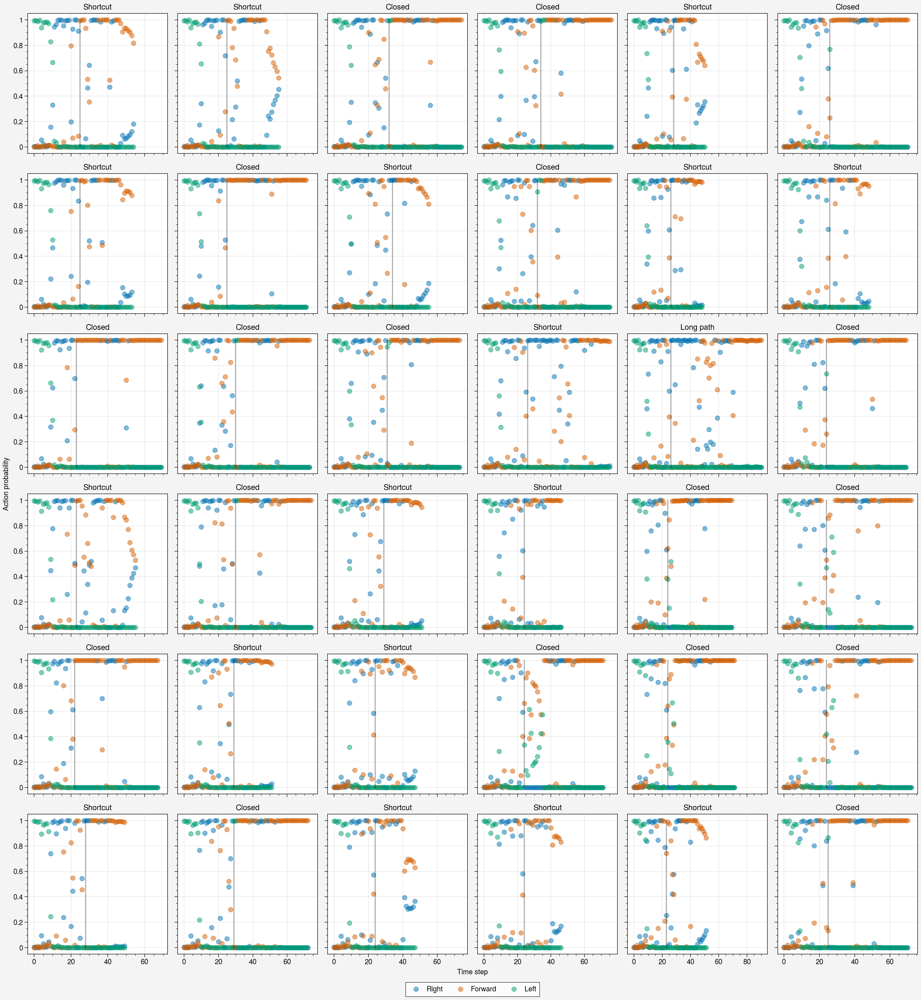

In [482]:
'''all action probs for ep'''
ep = 3
fig, ax = pplt.subplots(ncols=6, nrows=6)

title = []
for ep in range(36):
    a_s = res2['action_probs'][ep]
    p = res2['ep_pos'][ep][0]
    avail = res2['shortcut_avail'][ep][0][0]
    used = res2['shortcut_used'][ep][0]
    
    vis = res2['vis'][ep][0]
    first_vis = np.argmax(vis)

    cs = []
    cs.append(ax[ep].scatter(range(len(a_s)), a_s[:, 0], label='Right', alpha=0.5))
    cs.append(ax[ep].scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
    cs.append(ax[ep].scatter(range(len(a_s)), a_s[:, 2], label='Left', alpha=0.5))
    ax[ep].plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)
    
    if avail:
        if used:
            title.append('Shortcut')
        else:
            title.append('Long path')
    else:
        title.append('Closed')

ax.format(xlabel='Time step',
         ylabel='Action probability',
         title=title)
    
fig.legend(cs, loc='b', ncols=3)


In [483]:
res2.keys()

dict_keys(['activs', 'actions', 'ep_pos', 'ep_angle', 'vis', 'action_probs', 'shortcut_avail', 'shortcut_used'])

In [486]:
res2['actions'][0].keys()

dict_keys(['batch128_64', 'batch128_128', '_64', '_128'])

In [506]:
def action_prob_plot(res2, ep, ax):
    a_s = res2['action_probs'][ep]
    p = res2['ep_pos'][ep][0]
    avail = res2['shortcut_avail'][ep][0][0]
    used = res2['shortcut_used'][ep][0]
    
    vis = res2['vis'][ep][0]
    first_vis = np.argmax(vis)

    if avail:
        if used:
            title = 'Shortcut'
        else:
            title = 'Long path'
    else:
        title = 'Closed'
    
    cs = []
    cs.append(ax.scatter(range(len(a_s)), a_s[:, 0], label='Right', alpha=0.5))
    cs.append(ax.scatter(range(len(a_s)), a_s[:, 1], label='Forward', alpha=0.5))
    cs.append(ax.scatter(range(len(a_s)), a_s[:, 2], label='Left', alpha=0.5))
    ax.plot([first_vis, first_vis], [0, 1], color='black', alpha=0.3)
    
    return title

In [508]:
np.argsort(similarities)

array([16,  3, 28, 27, 31, 29, 23, 17, 22, 35, 26, 32,  2, 33, 21,  7, 13,
       19, 30, 12, 24,  9, 14, 34, 20, 25,  5,  8,  4,  6,  0,  1, 18, 11,
       10, 15], dtype=int64)

In [513]:
best_match

3

In [ ]:
# targ_idx = 16
targ_idx = 0
targ_acts = res2['actions'][targ_idx][0].squeeze()

similarities = []
for i in range(36):
    if i == targ_idx:
        similarities.append(0)
    else:
        acts = res2['actions'][i][0].squeeze()
        maxlen = min(len(targ_acts), len(acts))
        similarity = (acts[:maxlen] == targ_acts[:maxlen]).sum() / maxlen
        similarities.append(similarity)


fig, ax = pplt.subplots(ncols=2)
best_match = np.argsort(similarities)[5]
title = []
for i, ep in enumerate([targ_idx, best_match]):
    title.append(action_prob_plot(res2, ep, ax[i]))
ax.format(title=title)

acts = res2['actions'][best_match][0].squeeze()
maxlen = min(len(acts), len(targ_acts))

a_probs = res2['action_probs'][best_match]
targ_probs = res2['action_probs'][targ_idx]

dists = []
for i in range(maxlen):
    dists.append(two_set_mean_wasserstein(a_probs[np.newaxis, i], targ_probs[np.newaxis, i]))
ax.plot(dists)


(0.0, 0.1)

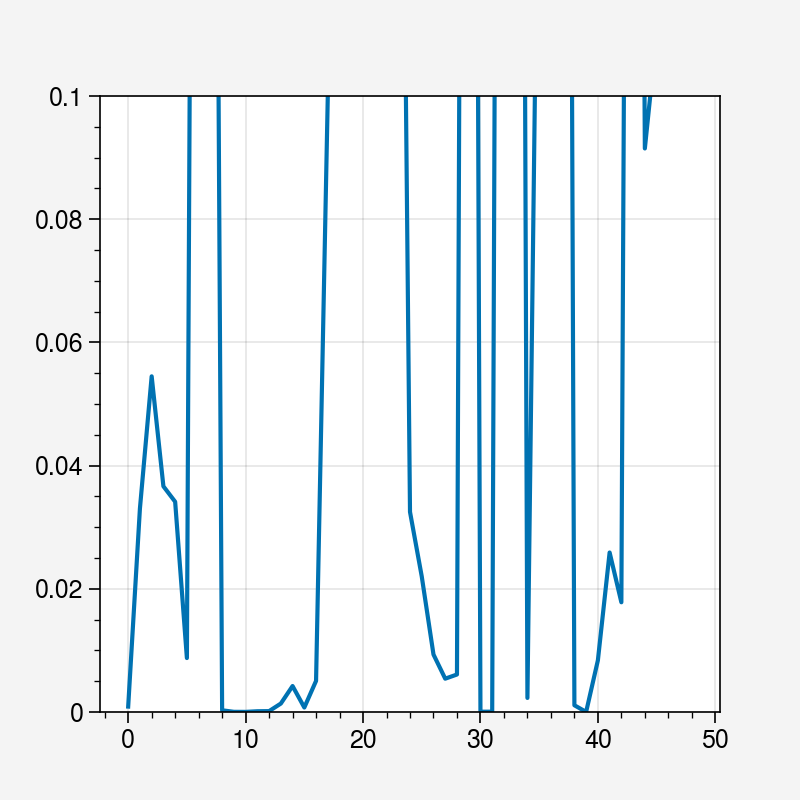

In [552]:
plt.plot(dists)
plt.ylim(0, 0.1)

In [557]:
firsts = []
for i in range(36):
    firsts.append(np.argmax(res2['vis'][0][0]))

In [561]:
res2['activs'][0][0]['shared_activations'].shape

torch.Size([2, 62, 64])

In [562]:
first = 7
activs = []
for i in range(36):
    activs.append(res2['activs'][i][0]['shared_activations'][1, first:, :])

In [564]:
np.vstack(activs).shape

(1799, 64)

# Deterministic vs probabilistic actions

Interestingly, probabilistic action selection seems to slightly increase shortcut use rate, but actually decreases performance overall

Maybe for most optimal performance, there is a way to bias action selection a little more heavily, but for probabilities close to 0.5 keep them so. For example, take square weighting of probabilities to increase extremity of certain action selection


In [575]:
p = 0.4
t = 0
chk = 440
model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', subdir='shortcut_wc2', trial=t, chk=chk)

res = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
               env_kwargs={'character_reset_pos': 3,
                          'shortcut_probability': 1,
                          'wall_colors': 1.5},
           seed=1, with_activations=True, data_callback=shortcut_visdata_callback,
               num_episodes=100, deterministic=False)

'''Collect up to first+nth step of seeing shortcut
where first is the first step seeing the shortcut'''
activs = ep_stack_activations(res, half=True)

res = {
    'activs': activs,
    'actions': actions,
    'ep_pos': res['data']['pos'],
    'ep_angle': res['data']['angle'],
    'vis': res['data']['shortcut_vis'],
    'shortcut_avail': res['data']['shortcut'],
    'shortcut_used': [[check_shortcut_usage(p) for p in res['data']['pos']]]
}
print(np.sum(res['shortcut_used']))

65


In [595]:
rand_surs = []
det_surs = []

rand_lens = []
det_lens = []
chk = 440
for p in probs:
    for t in tqdm(range(10)):
        model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', subdir='shortcut_wc2', trial=t, chk=chk)

        res = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
                       env_kwargs={'character_reset_pos': 3,
                                  'shortcut_probability': 1,
                                  'wall_colors': 1.5},
                   seed=1, with_activations=True, data_callback=shortcut_visdata_callback,
                       num_episodes=100, deterministic=False)
        rand_surs.append(np.sum([check_shortcut_usage(p) for p in res['data']['pos']]))
        rand_lens.append(np.mean([len(a) for a in res['actions']]))
        res = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
                       env_kwargs={'character_reset_pos': 3,
                                  'shortcut_probability': 1,
                                  'wall_colors': 1.5},
                   seed=1, with_activations=True, data_callback=shortcut_visdata_callback,
                       num_episodes=100, deterministic=True)
        det_surs.append(np.sum([check_shortcut_usage(p) for p in res['data']['pos']]))
        det_lens.append(np.mean([len(a) for a in res['actions']]))
        

100%|██████████████████████████████████████████████████████████████████████████████████| 10/10 [03:58<00:00, 23.82s/it]


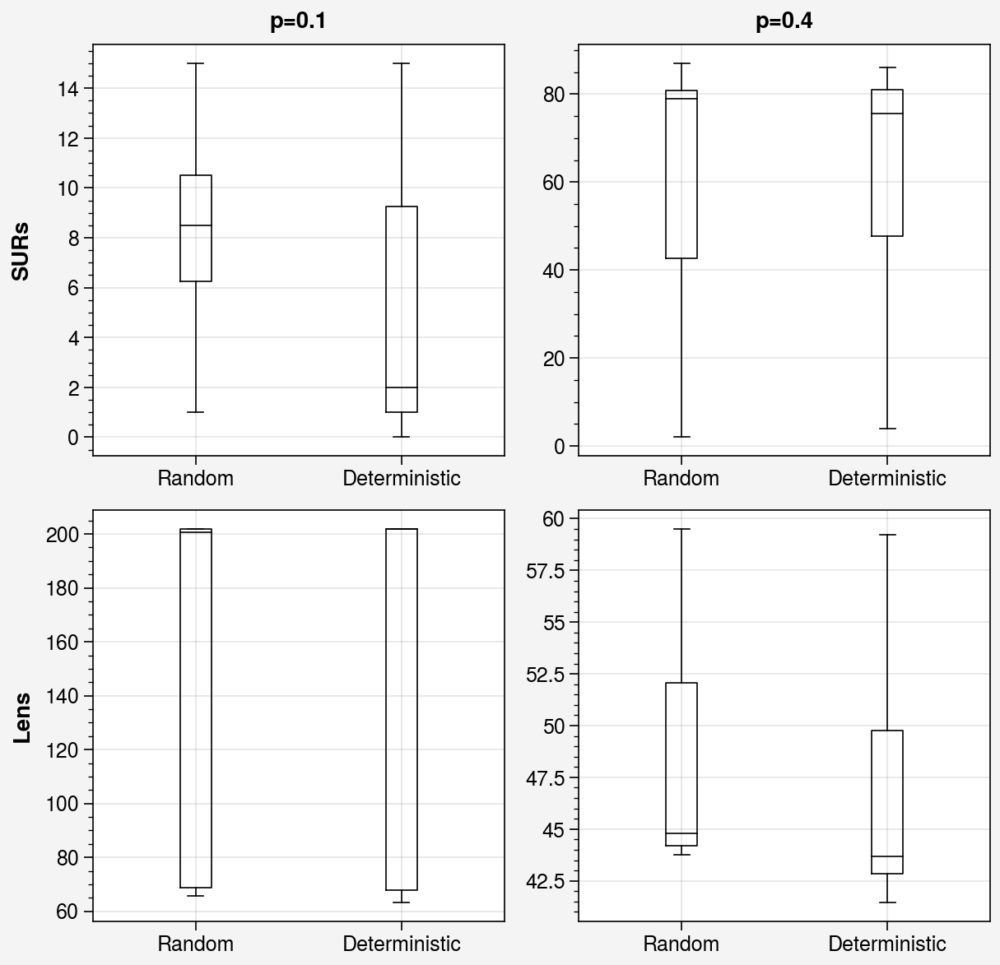

In [611]:
fig, ax = pplt.subplots(nrows=2, ncols=2, sharex=False, sharey=False)
x = np.stack([rand_surs[:10], det_surs[:10]], axis=1) #p0.1 surs
ax[0, 0].boxplot(x)
x = np.stack([rand_surs[10:], det_surs[10:]], axis=1) #p0.4 surs
ax[0, 1].boxplot(x)
x = np.stack([rand_lens[:10], det_lens[:10]], axis=1) #p0.1 lens
ax[1, 0].boxplot(x)
x = np.stack([rand_lens[10:], det_lens[10:]], axis=1) #p0.4 lens
ax[1, 1].boxplot(x, showfliers=False)

ax.format(leftlabels=['SURs', 'Lens'], toplabels=['p=0.1', 'p=0.4'],
         xlocator=range(2), xformatter=['Random', 'Deterministic'])

# Performance of 0, 0.8 agents

In [73]:
def draw_shortcut_maze(shortcut_open=True, ax=None):
    if ax is None:
        fig, ax = pplt.subplots()
    
    shortcut_probability = 1 if shortcut_open else 0
    env = gym.make('ShortcutNav-v0', shortcut_probability=shortcut_probability, 
                   render_character=False,
                   wall_colors=1.5)
    env.render('human', ax=ax)
    ax.format(xlim=[0, 300], ylim=[0, 300])
    

In [766]:
chk = 780
probs = [0.0, 0.8]
p = probs[1]
t = 4
model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)

res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=100, deterministic=False, seed=1)

In [767]:
shortcut_used = [check_shortcut_usage(p) for p in res['data']['pos']]
lens1 = [len(a) for a in res['actions']]
sur = np.mean(shortcut_used)
mean_len = np.mean(lens1)

true_used = np.array(shortcut_used) & (np.array(lens) < 202)
eps = np.argwhere(true_used).squeeze()

print(f'SUR: {sur:.2f}, mean_len: {mean_len:.2f}')

SUR: 0.96, mean_len: 38.50


In [768]:
res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 0, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=100, deterministic=False, seed=1)

In [769]:
shortcut_used = [check_shortcut_usage(p) for p in res['data']['pos']]
lens2 = [len(a) for a in res['actions']]
sur = np.mean(shortcut_used)
mean_len = np.mean(lens2)

true_used = np.array(shortcut_used) & (np.array(lens) < 202)
eps = np.argwhere(true_used).squeeze()

print(f'SUR: {sur:.2f}, mean_len: {mean_len:.2f}')

SUR: 0.00, mean_len: 57.55


In [771]:
for ep in range(100):
    v = res['data']['shortcut_vis'][ep]
    p = res['data']['pos'][ep]


In [770]:
from scipy.stats import ttest_ind
ttest_ind(lens1, lens2)

Ttest_indResult(statistic=-13.618464701279967, pvalue=3.088742802675782e-30)

In [ ]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(nrows=4, ncols=4)

for i, ep in enumerate(range(16, 32)):
# for i, ep in enumerate(eps):
    avail = res['data']['shortcut'][ep][0]
    p = res['data']['pos'][ep]
    a = res['data']['angle'][ep]
    draw_shortcut_maze(shortcut_open=avail, ax=ax[i])
    draw_trajectory(p, a, ax=ax[i])
    
pplt.rc.reset()

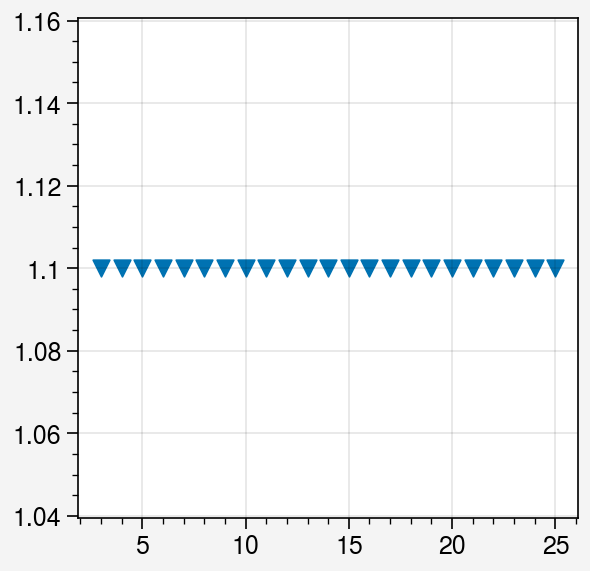

In [712]:
fig, ax = pplt.subplots()

v = res['data']['shortcut_vis'][0]
v = np.argwhere(v).squeeze()
vy = np.full(v.shape, 1.1)
ax.scatter(v, vy, marker='v')

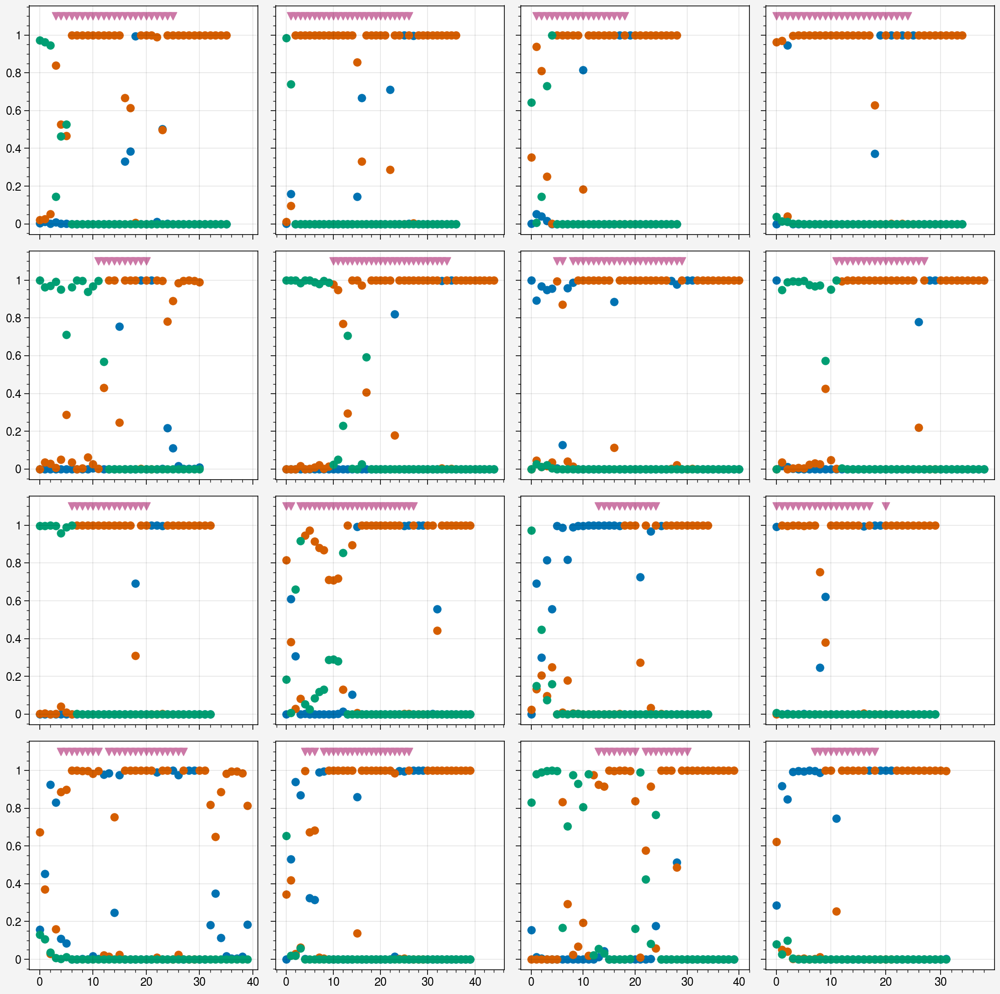

In [717]:
fig, ax = pplt.subplots(nrows=4, ncols=4)

for i, ep in enumerate(range(16)):
    ax[i].scatter(res['action_probs'][ep][:, :3])
    
    v = res['data']['shortcut_vis'][ep]
    v = np.argwhere(v).squeeze()
    vy = np.full(v.shape, 1.1)
    ax[i].scatter(v, vy, marker='v')

In [724]:
chk = 440
probs = [0.0, 0.8]
p = 0.4
t = 0
model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)

res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=100, deterministic=False, seed=1)

In [725]:
shortcut_used = [check_shortcut_usage(p) for p in res['data']['pos']]
lens1 = [len(a) for a in res['actions']]
sur = np.mean(shortcut_used)
mean_len = np.mean(lens1)

true_used = np.array(shortcut_used) & (np.array(lens) < 202)
eps = np.argwhere(true_used).squeeze()

print(f'SUR: {sur:.2f}, mean_len: {mean_len:.2f}')

SUR: 0.65, mean_len: 46.83


In [74]:
chk = 440
probs = [0.0, 0.8]
p = 0.4
t = 0
model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)

res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=100, deterministic=True, seed=1)

In [76]:
shortcut_used = [check_shortcut_usage(p) for p in res['data']['pos']]
lens1 = [len(a) for a in res['actions']]
sur = np.mean(shortcut_used)
mean_len = np.mean(lens1)

true_used = np.array(shortcut_used) & (np.array(lens1) < 202)
eps = np.argwhere(true_used).squeeze()

print(f'SUR: {sur:.2f}, mean_len: {mean_len:.2f}')

SUR: 0.65, mean_len: 45.57


True

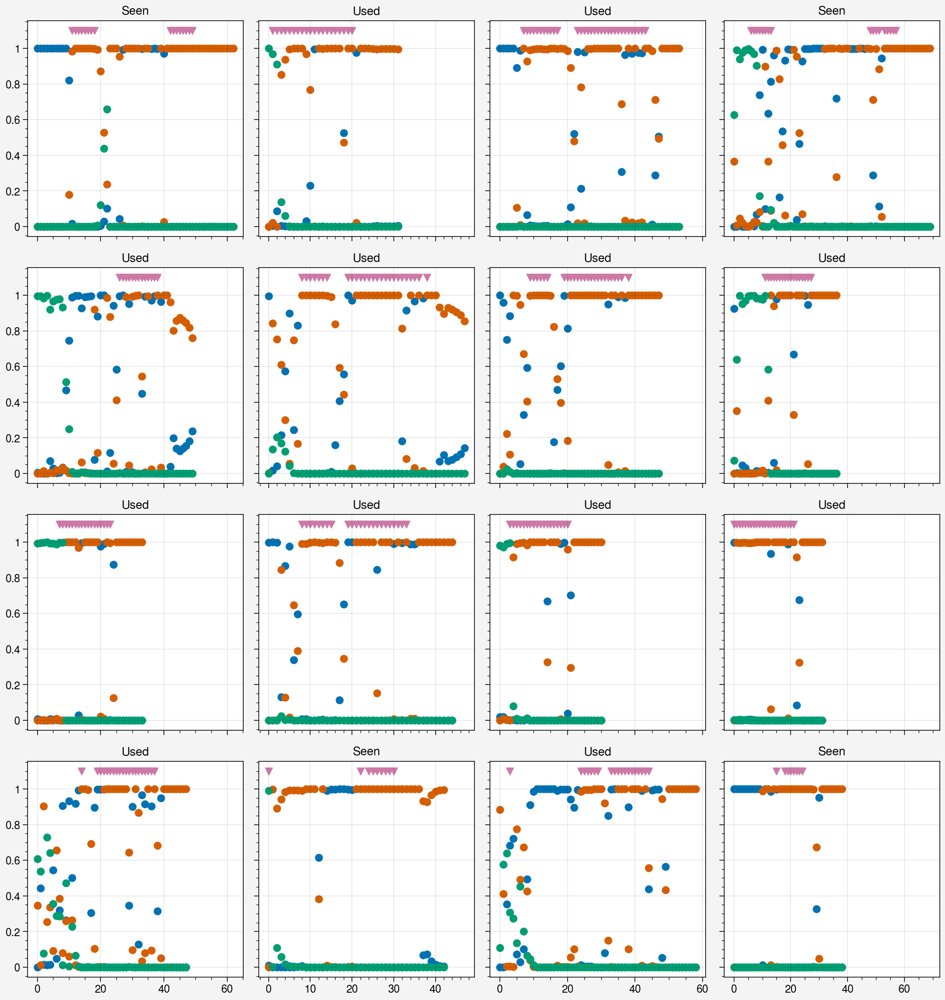

In [91]:
fig, ax = pplt.subplots(nrows=4, ncols=4)

title = []
for i, ep in enumerate(range(32, 48)):
    ax[i].scatter(res['action_probs'][ep][:, :3])
    
    v = res['data']['shortcut_vis'][ep]
    v = np.argwhere(v).squeeze()
    vy = np.full(v.shape, 1.1)
    ax[i].scatter(v, vy, marker='v')
    
    if check_shortcut_usage(res['data']['pos'][ep]):
        title.append('Used')
    else:
        title.append('Seen')
    
ax.format(title=title)

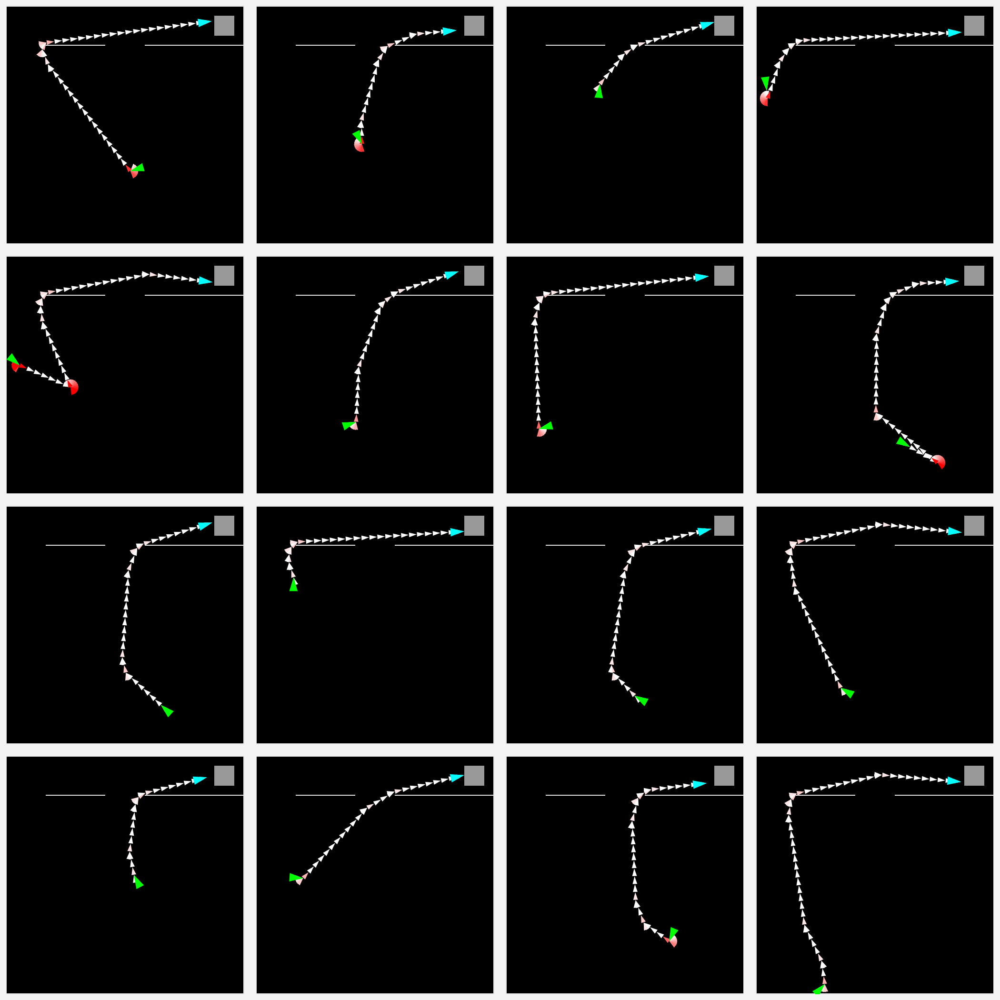

In [729]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(nrows=4, ncols=4)

for i, ep in enumerate(range(16, 32)):
# for i, ep in enumerate(eps):
    avail = res['data']['shortcut'][ep][0]
    p = res['data']['pos'][ep]
    a = res['data']['angle'][ep]
    draw_shortcut_maze(shortcut_open=avail, ax=ax[i])
    draw_trajectory(p, a, ax=ax[i])
    
pplt.rc.reset()

In [731]:
from sklearn.linear_model import LinearRegression

In [733]:
activs = ep_stack_activations(res)

In [741]:
activ = torch.vstack([a['shared_activations'][1] for a in activs]).numpy()
action_probs = np.vstack(res['action_probs'])

In [743]:
lr = LinearRegression()
lr.fit(activ, action_probs)

LinearRegression()

<a list of 4 PathCollection objects>

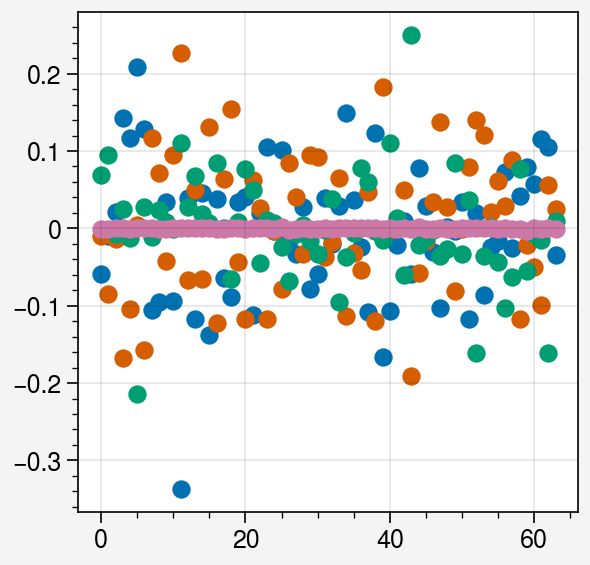

In [752]:
fig, ax = pplt.subplots()
ax.scatter(lr.coef_.T)

In [757]:
np.abs(lr.coef_ > 0.05).sum()

47

In [763]:
np.abs(lr.coef_ > 0.05).sum(axis=1)

array([14, 21, 12,  0])

## 1.0 agents

In [888]:
chk = 780
probs = [0.0, 0.8]
p = 1.0
t = 4
model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)

res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=100, deterministic=False, seed=1)

In [889]:
shortcut_used = [check_shortcut_usage(p) for p in res['data']['pos']]
lens1 = [len(a) for a in res['actions']]
sur = np.mean(shortcut_used)
mean_len = np.mean(lens1)

true_used = np.array(shortcut_used) & (np.array(lens) < 202)
eps = np.argwhere(true_used).squeeze()

print(f'SUR: {sur:.2f}, mean_len: {mean_len:.2f}')

SUR: 0.99, mean_len: 36.66


In [890]:
res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 0, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=100, deterministic=False, seed=1)

In [891]:
shortcut_used = [check_shortcut_usage(p) for p in res['data']['pos']]
lens2 = [len(a) for a in res['actions']]
sur = np.mean(shortcut_used)
mean_len = np.mean(lens2)

true_used = np.array(shortcut_used) & (np.array(lens) < 202)
eps = np.argwhere(true_used).squeeze()

print(f'SUR: {sur:.2f}, mean_len: {mean_len:.2f}')

SUR: 0.00, mean_len: 190.74


# Decision making modeling

Model amount of time that shortcut is in view - take agent in a 0 shortcut evaluation episodes and track how long shortcut in view for during first leg of trajectory. Then can treat this as monte carlo simulation

Next, can figure out when agent think the corridor path is irreversible (no longer considering shortcut path) and model shortcut selection with noise

## Observing action probabilities

In [134]:
# chk = 780
# probs = [0.0, 0.8]
# p = probs[1]
# t = 4

chk = 300
t = 5
p = 0.4

model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)

res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=100, deterministic=False, seed=1)

In [135]:
shortcut_used = [check_shortcut_usage(p) for p in res['data']['pos']]
lens1 = [len(a) for a in res['actions']]
sur = np.mean(shortcut_used)
mean_len = np.mean(lens1)

true_used = np.array(shortcut_used) & (np.array(lens) < 202)
eps = np.argwhere(true_used).squeeze()

print(f'SUR: {sur:.2f}, mean_len: {mean_len:.2f}')

NameError: name 'lens' is not defined

In [781]:
res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=100, deterministic=True, seed=1)

In [782]:
shortcut_used = [check_shortcut_usage(p) for p in res['data']['pos']]
lens2 = [len(a) for a in res['actions']]
sur = np.mean(shortcut_used)
mean_len = np.mean(lens2)

true_used = np.array(shortcut_used) & (np.array(lens) < 202)
eps = np.argwhere(true_used).squeeze()

print(f'SUR: {sur:.2f}, mean_len: {mean_len:.2f}')

SUR: 0.19, mean_len: 57.02


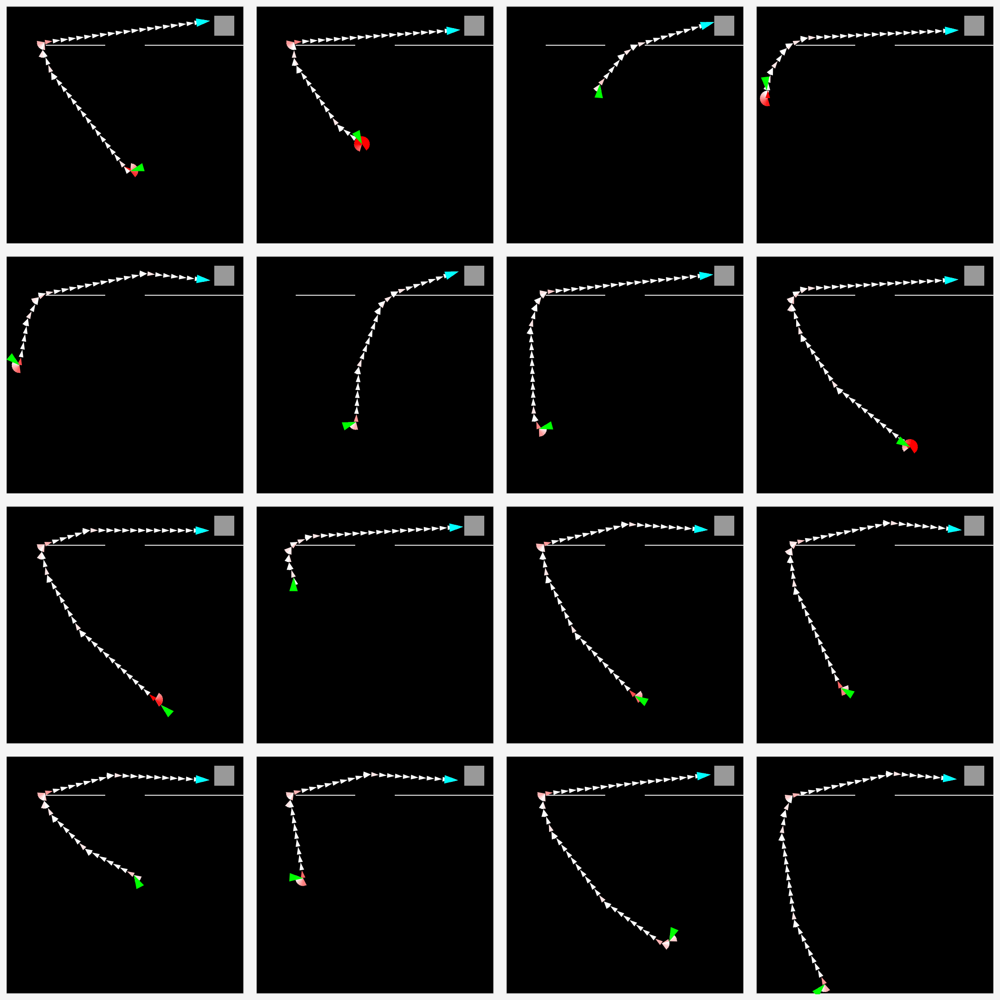

In [784]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(nrows=4, ncols=4)

for i, ep in enumerate(range(16, 32)):
# for i, ep in enumerate(eps):
    avail = res['data']['shortcut'][ep][0]
    p = res['data']['pos'][ep]
    a = res['data']['angle'][ep]
    draw_shortcut_maze(shortcut_open=avail, ax=ax[i])
    draw_trajectory(p, a, ax=ax[i])
    
pplt.rc.reset()

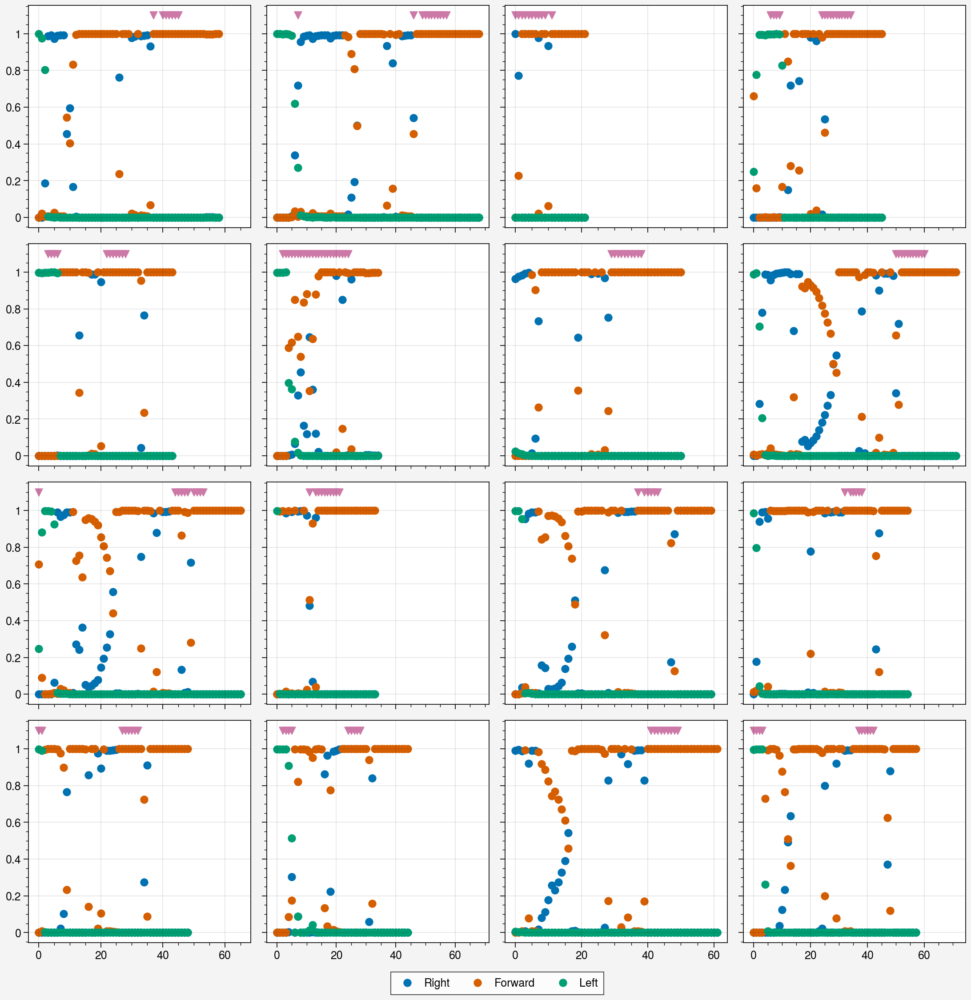

In [789]:
fig, ax = pplt.subplots(nrows=4, ncols=4)

for i, ep in enumerate(range(16, 32)):
    pts = ax[i].scatter(res['action_probs'][ep][:, :3], label=['Right', 'Forward', 'Left'])
    
    v = res['data']['shortcut_vis'][ep]
    v = np.argwhere(v).squeeze()
    vy = np.full(v.shape, 1.1)
    ax[i].scatter(v, vy, marker='v')
fig.legend(pts, loc='b')

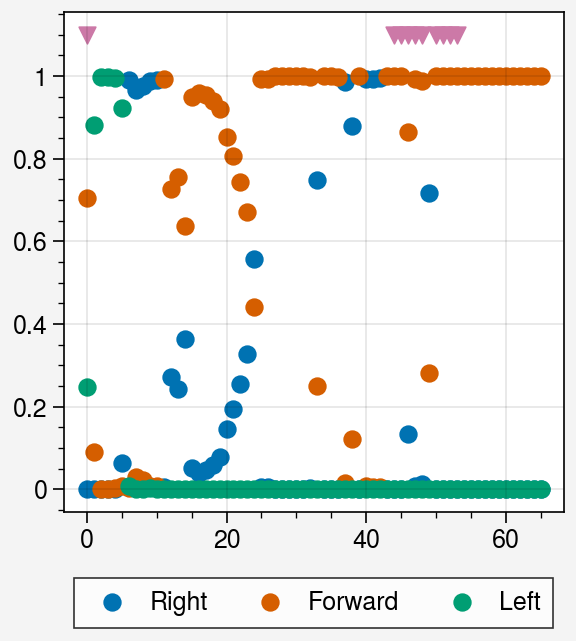

In [790]:
ep = 24
fig, ax = pplt.subplots()

pts = ax.scatter(res['action_probs'][ep][:, :3], label=['Right', 'Forward', 'Left'])

v = res['data']['shortcut_vis'][ep]
v = np.argwhere(v).squeeze()
vy = np.full(v.shape, 1.1)
ax.scatter(v, vy, marker='v')
fig.legend(pts, loc='b')

In [792]:
activs = ep_stack_activations(res)
activ = activs[ep]['shared_activations'][1]

In [797]:
a.shape

torch.Size([64])

In [798]:
steps

66

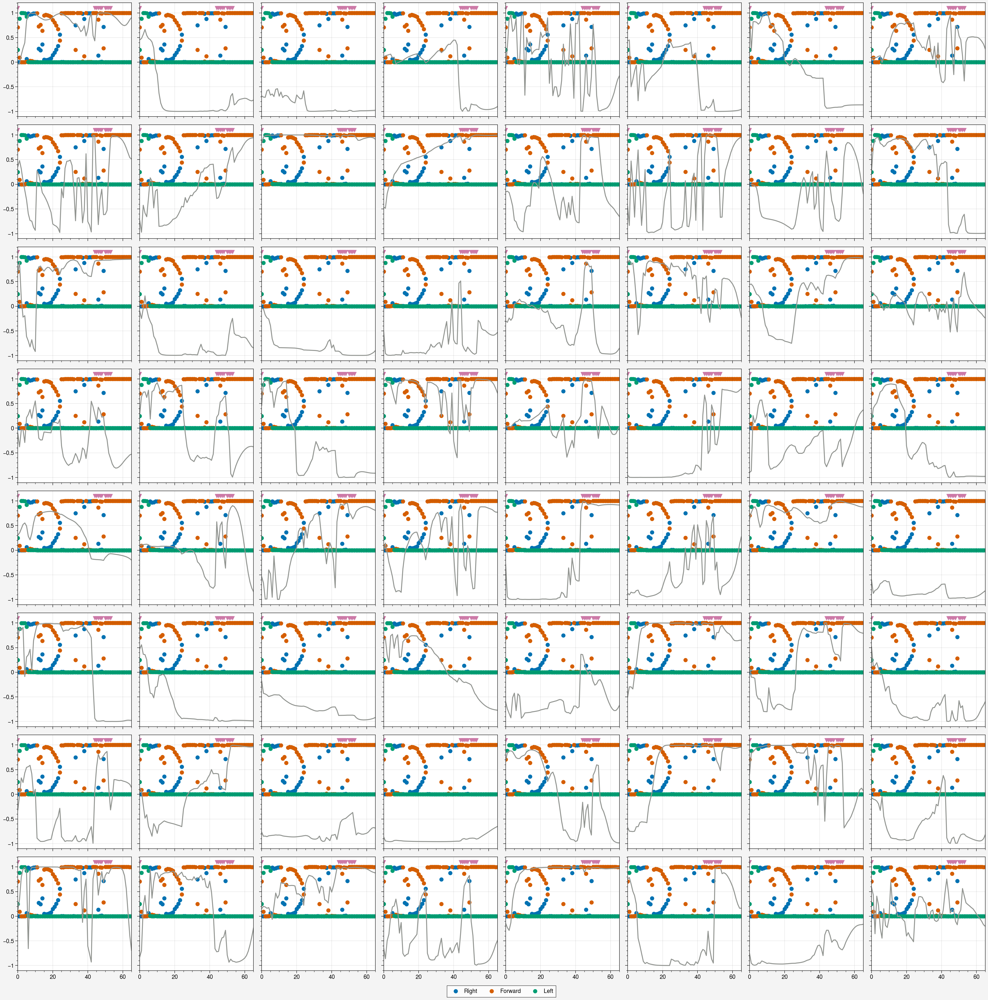

In [802]:
ep = 24
steps = len(res['actions'][ep])
fig, ax = pplt.subplots(nrows=8, ncols=8)

for i in range(64):
    a = activ[:, i]
    pts = ax[i].scatter(res['action_probs'][ep][:, :3], label=['Right', 'Forward', 'Left'])

    v = res['data']['shortcut_vis'][ep]
    v = np.argwhere(v).squeeze()
    vy = np.full(v.shape, 1.1)
    ax[i].scatter(v, vy, marker='v')
    
    ax[i].plot(np.arange(steps), a, color='gray')
    
fig.legend(pts, loc='b')

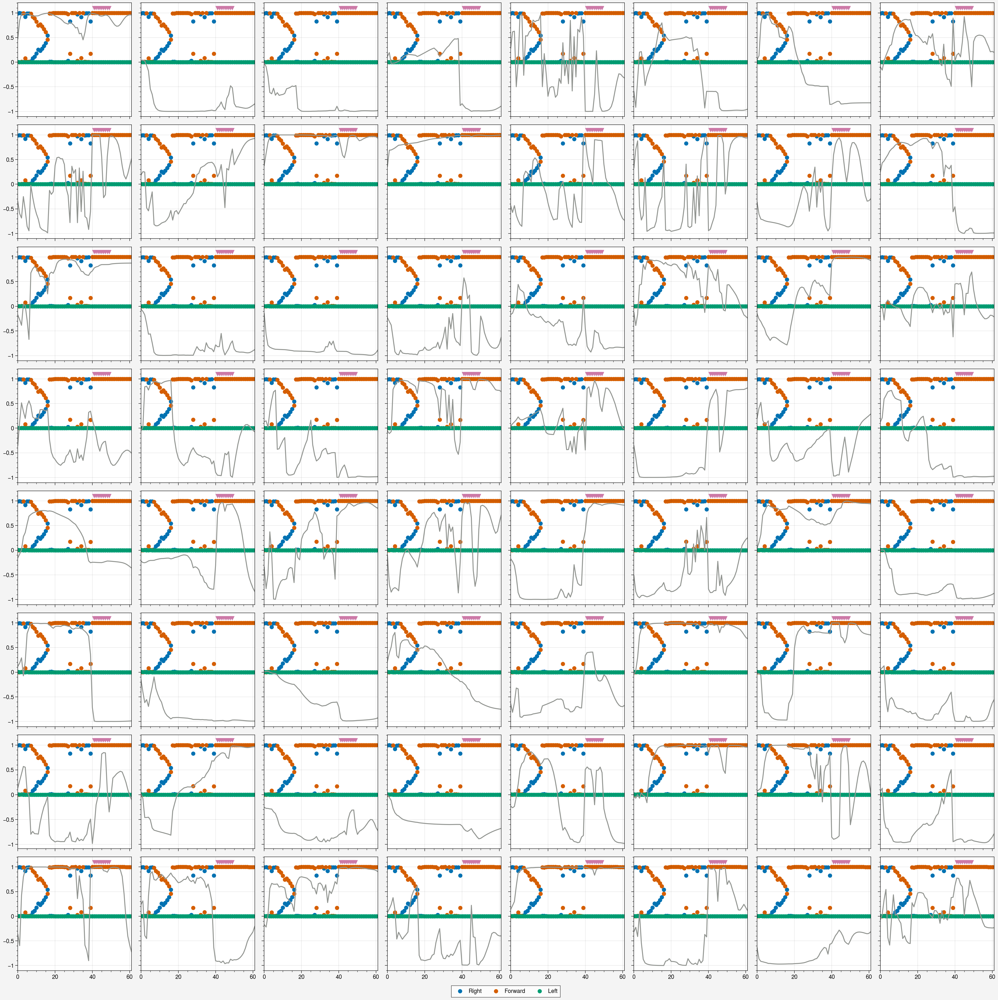

In [804]:
ep = 30
activ = activs[ep]['shared_activations'][1]
steps = len(res['actions'][ep])
fig, ax = pplt.subplots(nrows=8, ncols=8)

for i in range(64):
    a = activ[:, i]
    pts = ax[i].scatter(res['action_probs'][ep][:, :3], label=['Right', 'Forward', 'Left'])

    v = res['data']['shortcut_vis'][ep]
    v = np.argwhere(v).squeeze()
    vy = np.full(v.shape, 1.1)
    ax[i].scatter(v, vy, marker='v')
    
    ax[i].plot(np.arange(steps), a, color='gray')
    
fig.legend(pts, loc='b')

## Testing a single modified trajectory

Take trajectory from p=0.4, t=5, chk=300 agent, ep 30. In this episode, the agent takes the entrance path without seeing the shortcut. Modify by adding a single right then left turn so shortcut is sighted, but then continues on to take entrance

In [3]:
chk = 300
t = 5
p = 0.4

model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)

res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=100, deterministic=True, seed=1)

#taken from above deterministic seed 1 chk 300 t 5 p0.4
ep = 30
start_p = res['data']['pos'][ep][0]
start_a = res['data']['angle'][ep][0][0]
start = [start_p, start_a]
acts = res['actions'][ep].squeeze()
acts2 = np.concatenate([acts[:7], [0, 2], acts[7:]])

In [158]:
np.sum([check_shortcut_usage(p) for p in res['data']['pos']])

19

In [159]:
chk = 460
t = 5
p = 0.4

model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)

res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=100, deterministic=True, seed=1)

np.sum([check_shortcut_usage(p) for p in res['data']['pos']])

83

### SUR=0.19 agent

#### Shortcut open

In [4]:
chk = 300
t = 5
p = 0.4

model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)


res1 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts)
res2 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts2)
res3 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 0, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts2[:8])


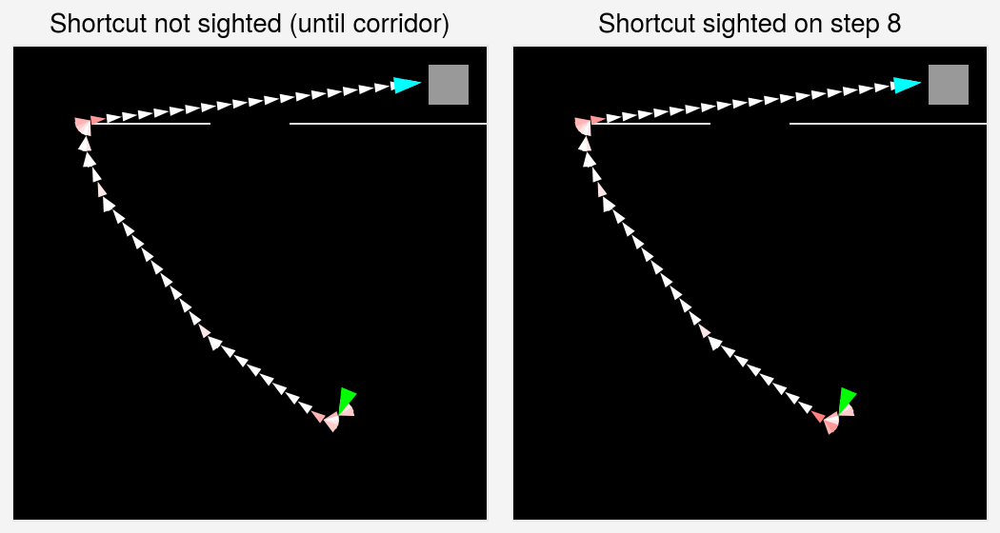

In [51]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(ncols=2)

avail = res1['data']['shortcut'][0][0]
p = res1['data']['pos'][0]
a = res1['data']['angle'][0]
draw_shortcut_maze(shortcut_open=True, ax=ax[0])
draw_trajectory(p, a, ax=ax[0])


avail = res2['data']['shortcut'][0][0]
p = res2['data']['pos'][0]
a = res2['data']['angle'][0]
draw_shortcut_maze(shortcut_open=True, ax=ax[1])
draw_trajectory(p, a, ax=ax[1])

pplt.rc.reset()
ax.format(title=['Shortcut not sighted (until corridor)',
                 'Shortcut sighted on step 8'])

SUR = 0.19 agent

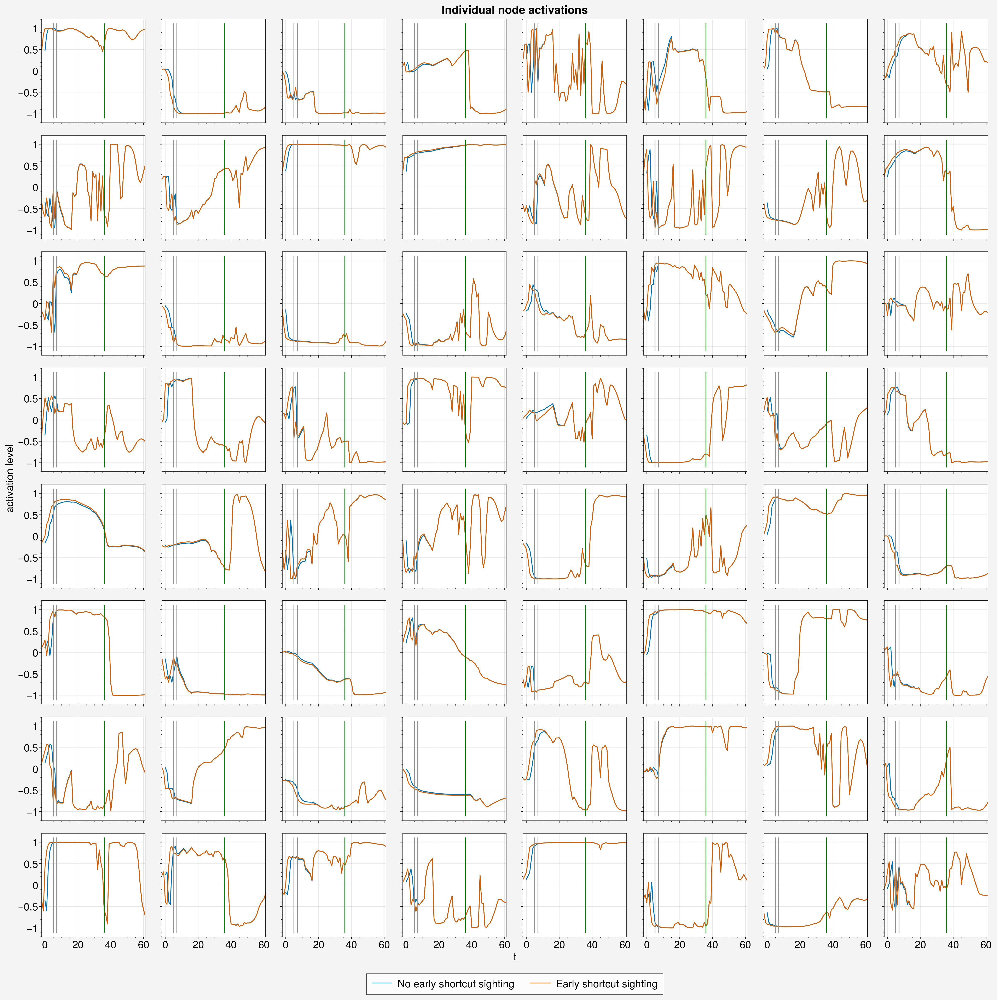

In [52]:
pplt.rc.update({'font.size': 18})

first_in_corridor = np.argmax(res1['data']['pos'][0][:, 1] > 250)

activ1 = ep_stack_activations(res1)[0]['shared_activations'][1]
activ2 = ep_stack_activations(res2)[0]['shared_activations'][1]
steps = len(activ1)
fig, ax = pplt.subplots(nrows=8, ncols=8)
for i in range(64):
    pts = []
    pts.append(ax[i].plot(np.arange(0, steps), activ1[:, i], label='No early shortcut sighting'))
    pts.append(ax[i].plot(np.arange(-2, steps), activ2[:, i], label='Early shortcut sighting'))
    ax[i].plot([5, 5], [-1.1, 1.1], color='gray')
    ax[i].plot([7, 7], [-1.1, 1.1], color='gray')
    ax[i].plot([first_in_corridor, first_in_corridor], [-1.1, 1.1], color='green')
    
fig.legend(pts, loc='b')
ax.format(suptitle='Individual node activations',
          xlabel='t', ylabel='activation level')

pplt.rc.reset()

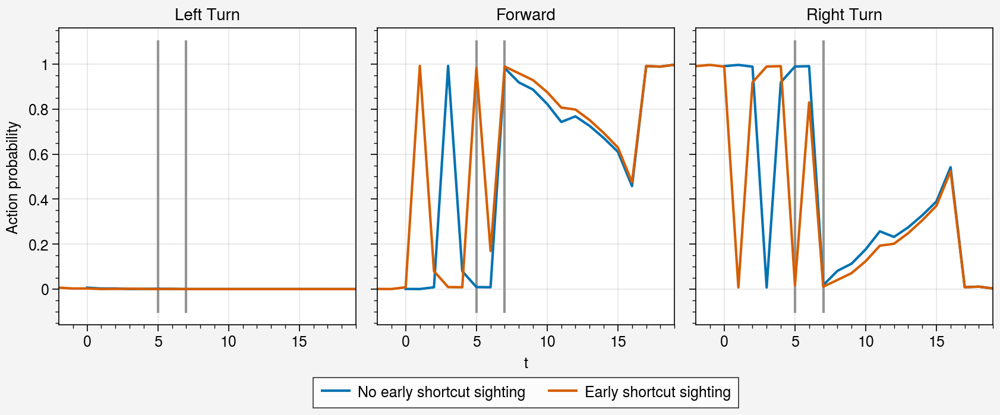

In [5]:
ap1 = res1['action_probs'][0]
ap2 = res2['action_probs'][0]
fig, ax = pplt.subplots(ncols=3)
zoom = 20
for i in range(3):
    # ax[i].plot(np.arange(steps), ap1[:, i])
    # ax[i].plot(np.arange(-2, steps), ap2[:, i])
    ax[i].plot([7, 7], [-0.1, 1.1], color='gray')
    ax[i].plot([5, 5], [-0.1, 1.1], color='gray')
    
    ax[i].plot(np.arange(zoom), ap1[:zoom, 2-i], label='No early shortcut sighting')
    ax[i].plot(np.arange(-2, zoom), ap2[:zoom+2, 2-i], label='Early shortcut sighting')
    
ax.format(xlabel='t', ylabel='Action probability',
         title=['Left Turn', 'Forward', 'Right Turn'])
ax[1].legend(loc='b')

#### Shortcut closed

In [9]:
chk = 300
t = 5
p = 0.4

model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)


res1 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 0, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts)
res2 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 0, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts2)
res3 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 0, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts2[:8])


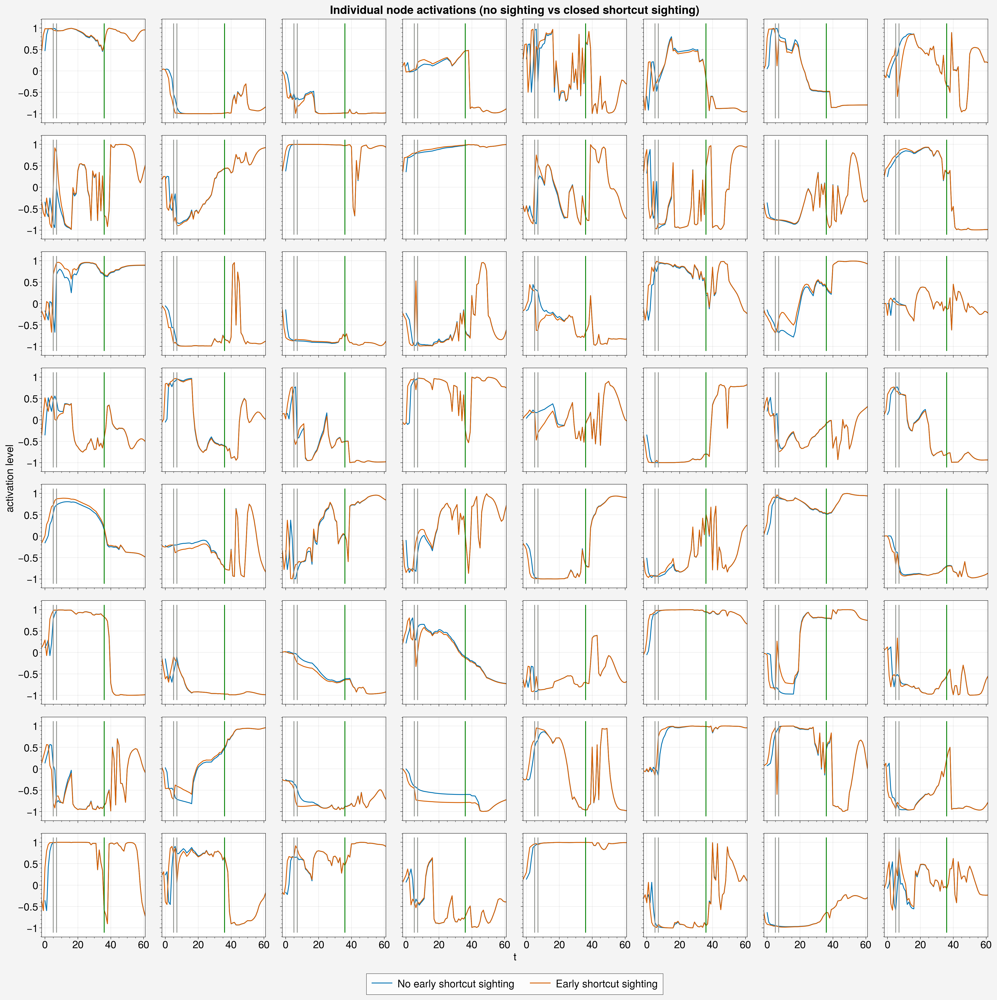

In [10]:
pplt.rc.update({'font.size': 18})

# highlights = [0, 5, 22, 24, 63]
highlights = []

activ1 = ep_stack_activations(res1)[0]['shared_activations'][1]
activ2 = ep_stack_activations(res2)[0]['shared_activations'][1]
steps = len(activ1)
fig, ax = pplt.subplots(nrows=8, ncols=8)
first_in_corridor = np.argmax(res1['data']['pos'][0][:, 1] > 250)
    

for i in range(64):
    pts = []
    pts.append(ax[i].plot(np.arange(0, steps), activ1[:, i], label='No early shortcut sighting'))
    pts.append(ax[i].plot(np.arange(-2, steps), activ2[:, i], label='Early shortcut sighting'))
    ax[i].plot([5, 5], [-1.1, 1.1], color='gray')
    ax[i].plot([7, 7], [-1.1, 1.1], color='gray')
    ax[i].plot([first_in_corridor, first_in_corridor], [-1.1, 1.1], color='green')
    
fig.legend(pts, loc='b')
ax.format(suptitle='Individual node activations (no sighting vs closed shortcut sighting)',
          xlabel='t', ylabel='activation level')

for i in highlights:
    ax[i].format(ycolor='red', xcolor='red')

pplt.rc.reset()

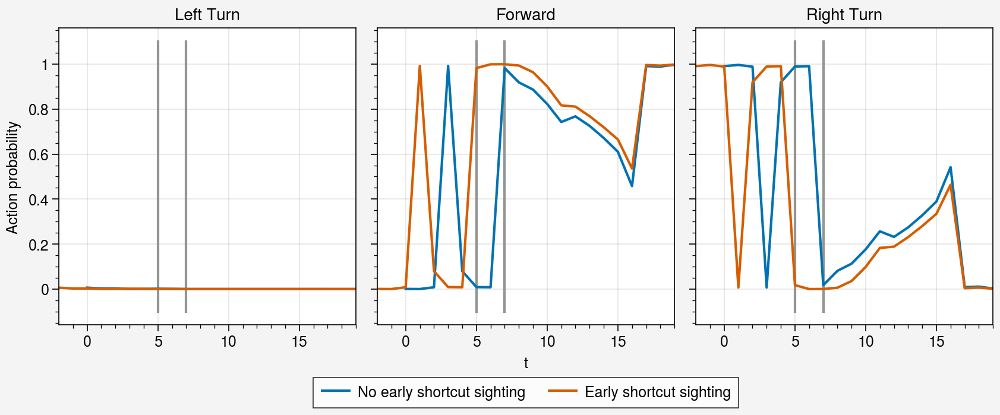

In [11]:
ap1 = res1['action_probs'][0]
ap2 = res2['action_probs'][0]
fig, ax = pplt.subplots(ncols=3)
zoom = 20
for i in range(3):
    # ax[i].plot(np.arange(steps), ap1[:, i])
    # ax[i].plot(np.arange(-2, steps), ap2[:, i])
    ax[i].plot([7, 7], [-0.1, 1.1], color='gray')
    ax[i].plot([5, 5], [-0.1, 1.1], color='gray')
    
    ax[i].plot(np.arange(zoom), ap1[:zoom, 2-i], label='No early shortcut sighting')
    ax[i].plot(np.arange(-2, zoom), ap2[:zoom+2, 2-i], label='Early shortcut sighting')
    
ax.format(xlabel='t', ylabel='Action probability',
         title=['Left Turn', 'Forward', 'Right Turn'])
ax[1].legend(loc='b')

### SUR=0.83 agent

SUR = 0.83 agent. Same agent later in training

In [76]:
chk = 460
t = 5
p = 0.4

model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)


res1 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts)
res2 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts2)
res3 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 0, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts2[:8])


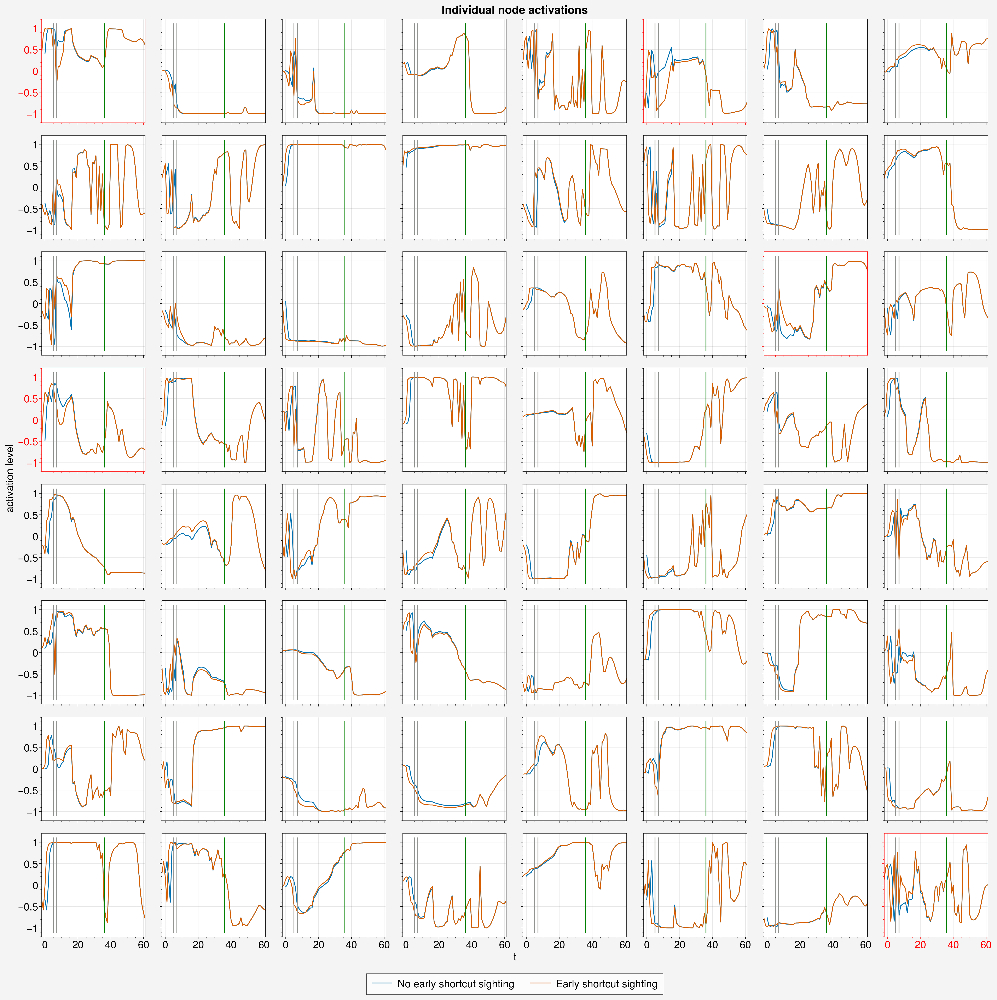

In [179]:
pplt.rc.update({'font.size': 18})

highlights = [0, 5, 22, 24, 63]

first_in_corridor = np.argmax(res1['data']['pos'][0][:, 1] > 250)

activ1 = ep_stack_activations(res1)[0]['shared_activations'][1]
activ2 = ep_stack_activations(res2)[0]['shared_activations'][1]
steps = len(activ1)
fig, ax = pplt.subplots(nrows=8, ncols=8)
for i in range(64):
    pts = []
    pts.append(ax[i].plot(np.arange(0, steps), activ1[:, i], label='No early shortcut sighting'))
    pts.append(ax[i].plot(np.arange(-2, steps), activ2[:, i], label='Early shortcut sighting'))
    ax[i].plot([5, 5], [-1.1, 1.1], color='gray')
    ax[i].plot([7, 7], [-1.1, 1.1], color='gray')
    ax[i].plot([first_in_corridor, first_in_corridor], [-1.1, 1.1], color='green')
    
    
fig.legend(pts, loc='b')
ax.format(suptitle='Individual node activations',
          xlabel='t', ylabel='activation level')

for i in highlights:
    ax[i].format(ycolor='red', xcolor='red')

pplt.rc.reset()

Interestingly, the agent knows to keep turning until the shortcut is seen. Once the shortcut is seen, it generally tries to move forward thinking it is on the right track. After a few time steps, it has a much higher probability of wanting to turn right, to correct course to the shortcut it knows is there.

If the shortcut is not sighted, the agent actually has a very high probability of wanting to turn right throughout, indicating an intent to see whether the shortcut is there or not.

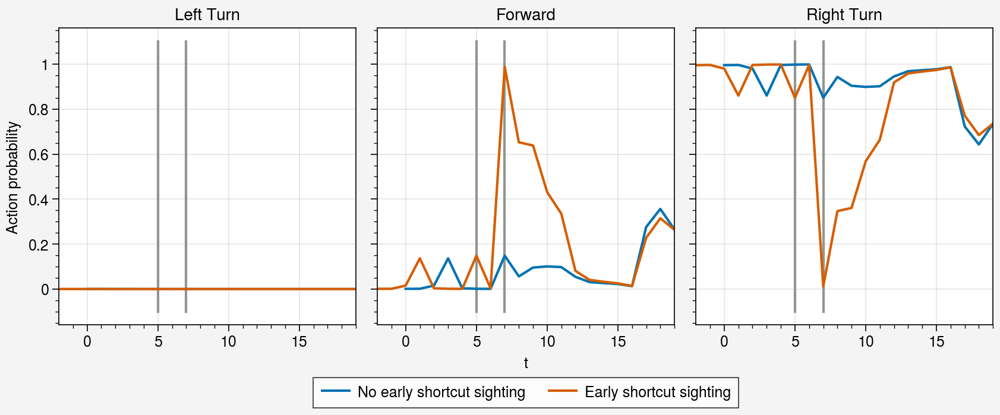

In [77]:
ap1 = res1['action_probs'][0]
ap2 = res2['action_probs'][0]
fig, ax = pplt.subplots(ncols=3)
zoom = 20
for i in range(3):
    # ax[i].plot(np.arange(steps), ap1[:, i])
    # ax[i].plot(np.arange(-2, steps), ap2[:, i])
    ax[i].plot([7, 7], [-0.1, 1.1], color='gray')
    ax[i].plot([5, 5], [-0.1, 1.1], color='gray')
    
    ax[i].plot(np.arange(zoom), ap1[:zoom, 2-i], label='No early shortcut sighting')
    ax[i].plot(np.arange(-2, zoom), ap2[:zoom+2, 2-i], label='Early shortcut sighting')
    
ax.format(xlabel='t', ylabel='Action probability',
         title=['Left Turn', 'Forward', 'Right Turn'])
ax[1].legend(loc='b')

SUR = 0.83 agent. This time with shortcut closed

In [6]:
chk = 460
t = 5
p = 0.4

model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)


res1 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 0, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts)
res2 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 0, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts2)
res3 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 0, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts2[:8])


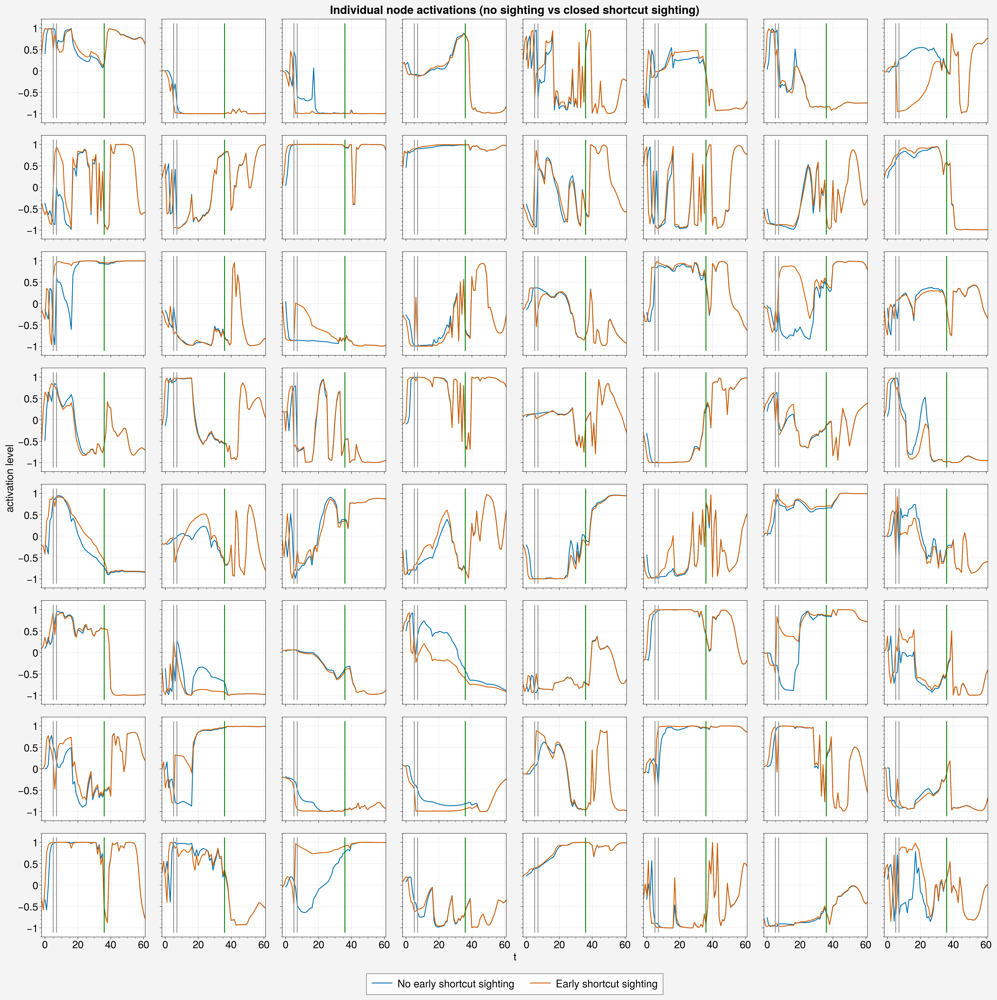

In [7]:
pplt.rc.update({'font.size': 18})

# highlights = [0, 5, 22, 24, 63]
highlights = []

activ1 = ep_stack_activations(res1)[0]['shared_activations'][1]
activ2 = ep_stack_activations(res2)[0]['shared_activations'][1]
steps = len(activ1)
fig, ax = pplt.subplots(nrows=8, ncols=8)
first_in_corridor = np.argmax(res1['data']['pos'][0][:, 1] > 250)
    

for i in range(64):
    pts = []
    pts.append(ax[i].plot(np.arange(0, steps), activ1[:, i], label='No early shortcut sighting'))
    pts.append(ax[i].plot(np.arange(-2, steps), activ2[:, i], label='Early shortcut sighting'))
    ax[i].plot([5, 5], [-1.1, 1.1], color='gray')
    ax[i].plot([7, 7], [-1.1, 1.1], color='gray')
    ax[i].plot([first_in_corridor, first_in_corridor], [-1.1, 1.1], color='green')
    
fig.legend(pts, loc='b')
ax.format(suptitle='Individual node activations (no sighting vs closed shortcut sighting)',
          xlabel='t', ylabel='activation level')

for i in highlights:
    ax[i].format(ycolor='red', xcolor='red')

pplt.rc.reset()

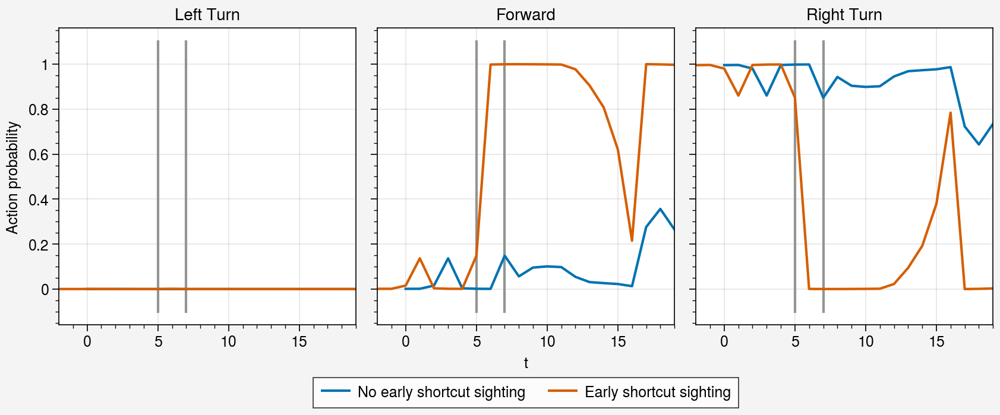

In [8]:
ap1 = res1['action_probs'][0]
ap2 = res2['action_probs'][0]
fig, ax = pplt.subplots(ncols=3)
zoom = 20
for i in range(3):
    # ax[i].plot(np.arange(steps), ap1[:, i])
    # ax[i].plot(np.arange(-2, steps), ap2[:, i])
    ax[i].plot([7, 7], [-0.1, 1.1], color='gray')
    ax[i].plot([5, 5], [-0.1, 1.1], color='gray')
    
    ax[i].plot(np.arange(zoom), ap1[:zoom, 2-i], label='No early shortcut sighting')
    ax[i].plot(np.arange(-2, zoom), ap2[:zoom+2, 2-i], label='Early shortcut sighting')
    
ax.format(xlabel='t', ylabel='Action probability',
         title=['Left Turn', 'Forward', 'Right Turn'])
ax[1].legend(loc='b')

In [882]:
chk = 460
t = 5
p = 0.4

model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)


res1 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=True, seed=1,
        forced_actions=acts)
res2 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=True, seed=1,
        forced_actions=acts2)
res3 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=True, seed=1)
res4 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=True, seed=1,
        forced_actions=acts2[:9])

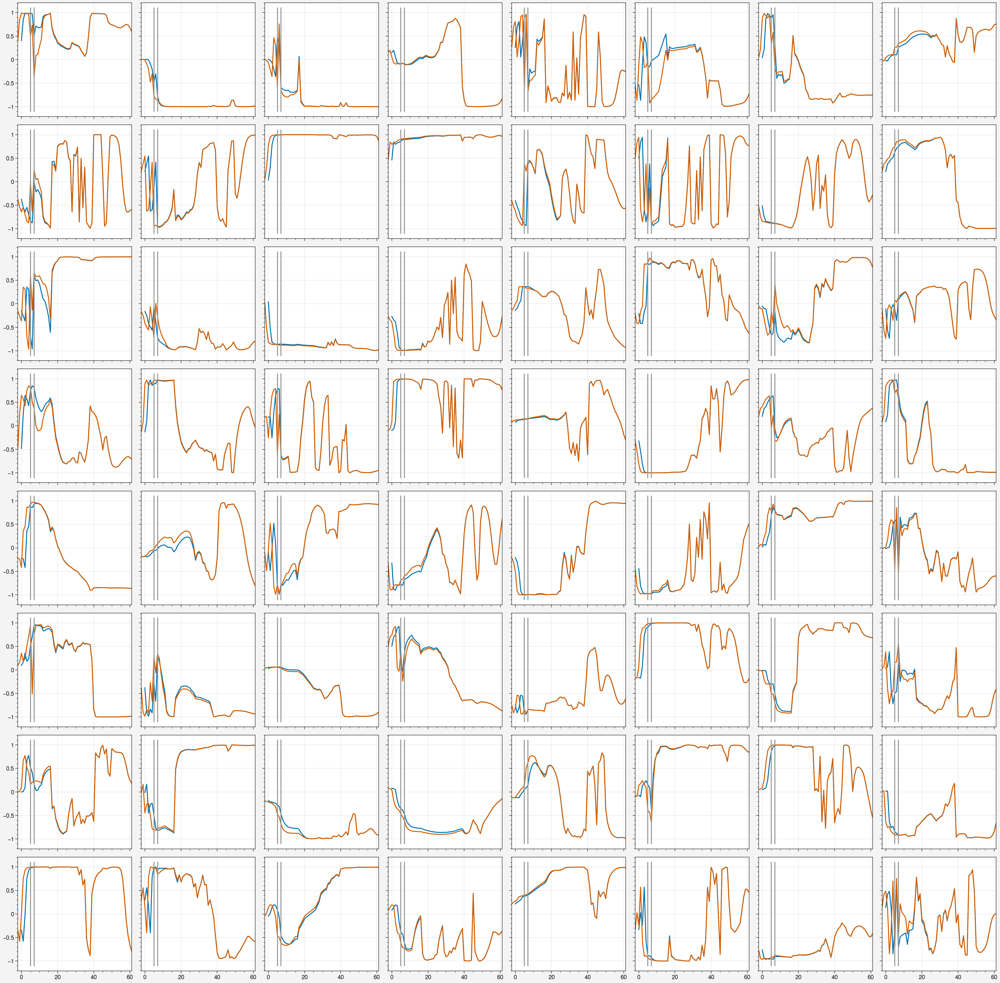

In [883]:
activ1 = ep_stack_activations(res1)[0]['shared_activations'][1]
activ2 = ep_stack_activations(res2)[0]['shared_activations'][1]

fig, ax = pplt.subplots(nrows=8, ncols=8)
for i in range(64):
    ax[i].plot(np.arange(0, steps), activ1[:, i])
    ax[i].plot(np.arange(-2, steps), activ2[:, i])
    ax[i].plot([5, 5], [-1.1, 1.1], color='gray')
    ax[i].plot([7, 7], [-1.1, 1.1], color='gray')

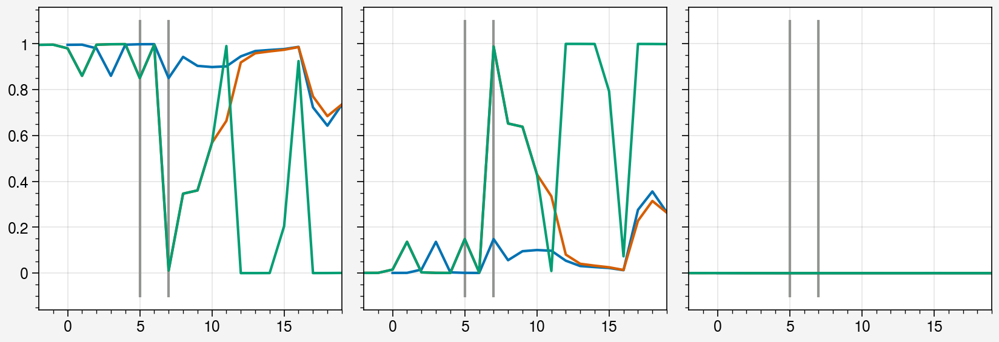

In [884]:
ap1 = res1['action_probs'][0]
ap2 = res2['action_probs'][0]
ap3 = res3['action_probs'][0]
ap4 = res4['action_probs'][0]


fig, ax = pplt.subplots(ncols=3)
zoom = 20
for i in range(3):
    # ax[i].plot(np.arange(steps), ap1[:, i])
    # ax[i].plot(np.arange(-2, steps), ap2[:, i])
    ax[i].plot([7, 7], [-0.1, 1.1], color='gray')
    ax[i].plot([5, 5], [-0.1, 1.1], color='gray')
    
    ax[i].plot(np.arange(zoom), ap1[:zoom, i])
    ax[i].plot(np.arange(-2, zoom), ap2[:zoom+2, i])
    # ax[i].plot(ap3[:zoom+2, i])
    ax[i].plot(np.arange(-2, zoom), ap4[:zoom+2, i])

## Sight and stop

In [13]:
chk = 300
t = 5
p = 0.4

model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)

res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 1, 'character_reset_pos': 3}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=31, deterministic=True, seed=1)

#taken from above deterministic seed 1 chk 300 t 5 p0.4
ep = 30
start_p = res['data']['pos'][ep][0]
start_a = res['data']['angle'][ep][0][0]
start = [start_p, start_a]
acts = res['actions'][ep].squeeze()
acts2 = np.concatenate([acts[:7], [0, 2], acts[7:]])

acts_sight_and_stop = np.concatenate([acts[:7], [0, 2], [3]*200])
acts_stop = np.concatenate([acts[:7], [3]*200])

###

In [14]:
chk = 460
t = 5
p = 0.4

model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', chk=chk, subdir='shortcut_wc2', trial=t)


res_stop = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 0, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts_stop)
res_sight_and_stop = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={
        'wall_colors': 1.5, 'shortcut_probability': 0, 'character_reset_pos': 3,
        'fixed_reset': start}, with_activations=True,
        data_callback=shortcut_visdata_callback, num_episodes=1, deterministic=False, seed=1,
        forced_actions=acts_sight_and_stop)

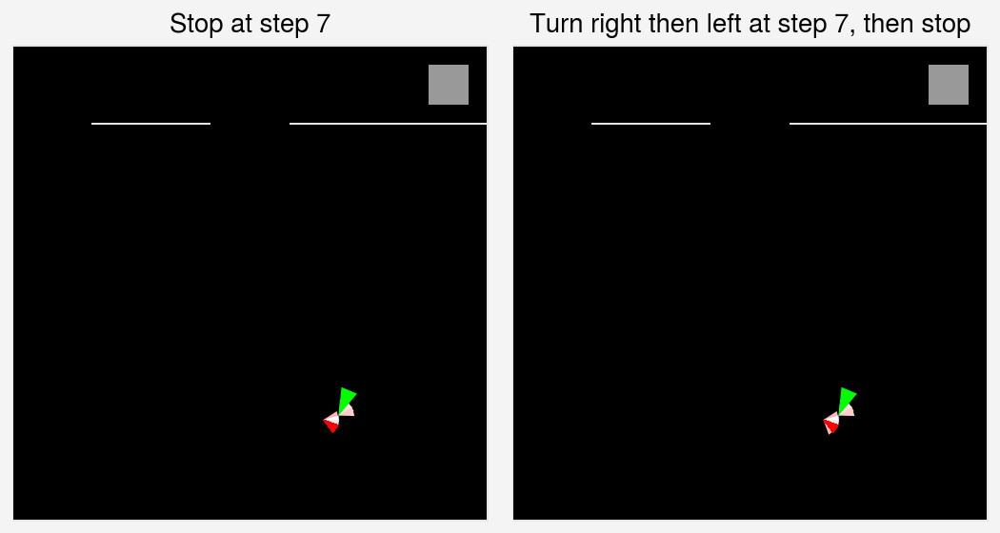

In [20]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(ncols=2)

avail = res_stop['data']['shortcut'][0][0]
p = res_stop['data']['pos'][0]
a = res_stop['data']['angle'][0]
draw_shortcut_maze(shortcut_open=True, ax=ax[0])
draw_trajectory(p, a, ax=ax[0])


avail = res_sight_and_stop['data']['shortcut'][0][0]
p = res_sight_and_stop['data']['pos'][0]
a = res_sight_and_stop['data']['angle'][0]
draw_shortcut_maze(shortcut_open=True, ax=ax[1])
draw_trajectory(p, a, ax=ax[1])

pplt.rc.reset()
ax.format(title=['Stop at step 7',
                 'Turn right then left at step 7, then stop'])

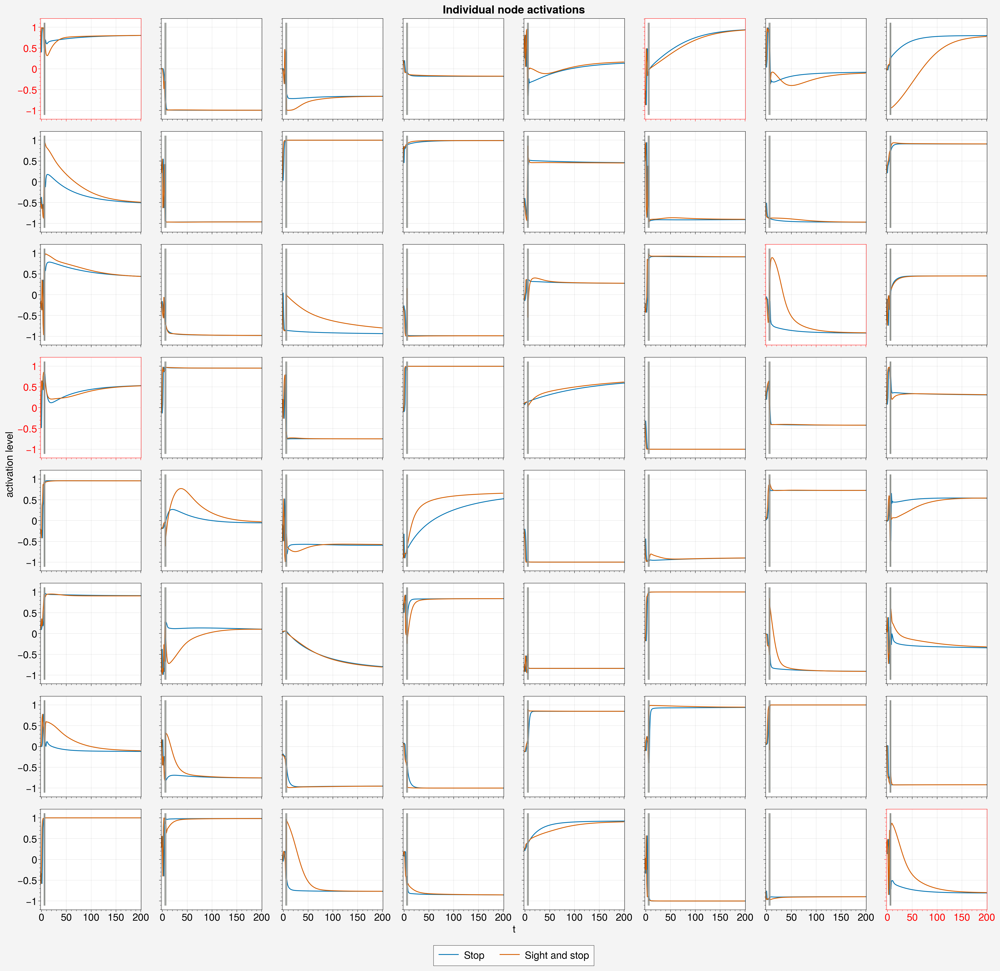

In [19]:
pplt.rc.update({'font.size': 18})

highlights = [0, 5, 22, 24, 63]

activ1 = ep_stack_activations(res_stop)[0]['shared_activations'][1]
activ2 = ep_stack_activations(res_sight_and_stop)[0]['shared_activations'][1]
steps = len(activ1)
fig, ax = pplt.subplots(nrows=8, ncols=8)
for i in range(64):
    pts = []
    pts.append(ax[i].plot(np.arange(0, steps), activ1[:, i], label='Stop'))
    pts.append(ax[i].plot(np.arange(-2, steps-2), activ2[:, i], label='Sight and stop'))
    ax[i].plot([5, 5], [-1.1, 1.1], color='gray')
    ax[i].plot([7, 7], [-1.1, 1.1], color='gray')
    
    
fig.legend(pts, loc='b')
ax.format(suptitle='Individual node activations',
          xlabel='t', ylabel='activation level')

for i in highlights:
    ax[i].format(ycolor='red', xcolor='red')

pplt.rc.reset()

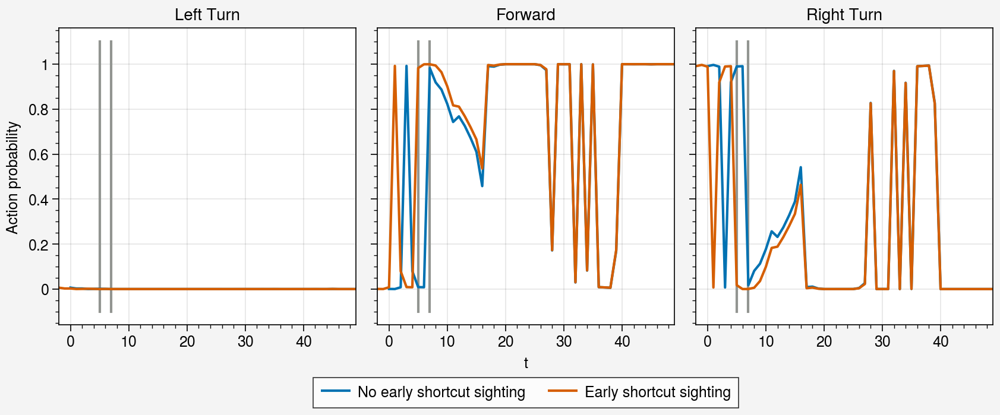

In [16]:
ap1 = res_stop['action_probs'][0]
ap2 = res_sight_and_stop['action_probs'][0]
fig, ax = pplt.subplots(ncols=3)
zoom = 50
for i in range(3):
    # ax[i].plot(np.arange(steps), ap1[:, i])
    # ax[i].plot(np.arange(-2, steps), ap2[:, i])
    ax[i].plot([7, 7], [-0.1, 1.1], color='gray')
    ax[i].plot([5, 5], [-0.1, 1.1], color='gray')
    
    ax[i].plot(np.arange(zoom), ap1[:zoom, 2-i], label='No early shortcut sighting')
    ax[i].plot(np.arange(-2, zoom), ap2[:zoom+2, 2-i], label='Early shortcut sighting')
    
ax.format(xlabel='t', ylabel='Action probability',
         title=['Left Turn', 'Forward', 'Right Turn'])
ax[1].legend(loc='b')

In [881]:
res4['actions'][0].squeeze()

array([0, 0, 0, 1, 0, 0, 0, 0, 2, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 1], dtype=int64)

In [874]:
%run model_evaluation

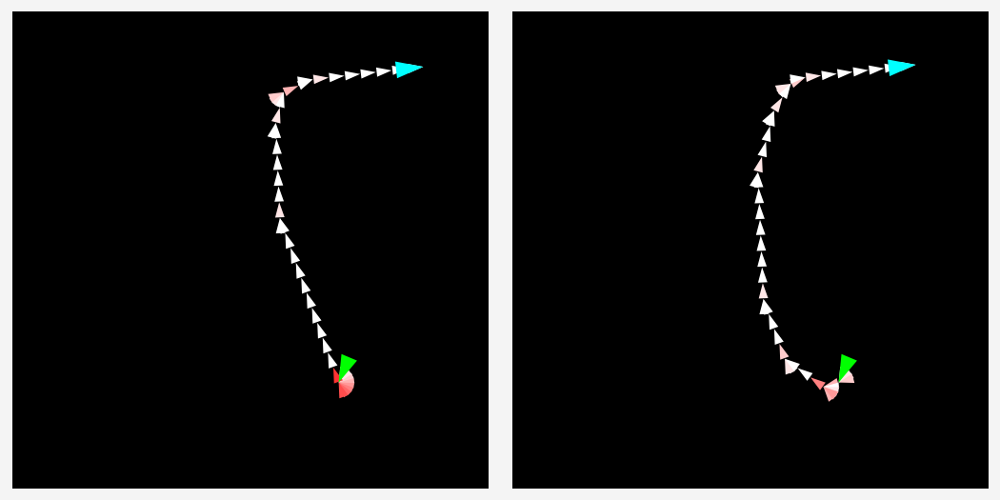

In [877]:
set_trajectory_plot_style()

fig, ax = pplt.subplots(ncols=2)

draw_trajectory(res3['data']['pos'][0], res3['data']['angle'][0], ax=ax[0])
draw_trajectory(res4['data']['pos'][0], res4['data']['angle'][0], ax=ax[1])

pplt.rc.reset()

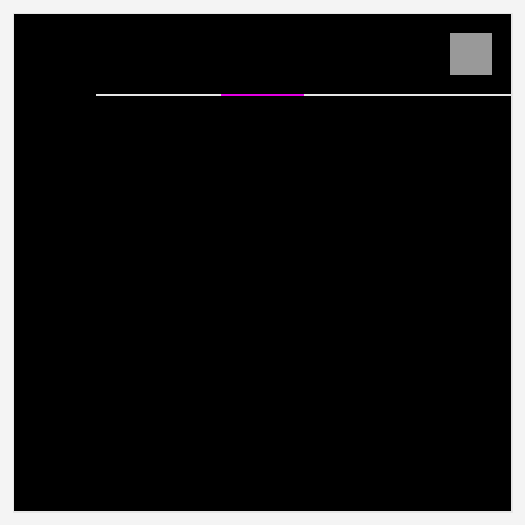

In [887]:
set_trajectory_plot_style()
draw_shortcut_maze(False)
pplt.rc.reset()